# Notebook Objective and Setup

BGG05 holds the EDA and visualization for the game data.

This notebook is outside of the scope of the recommendation engine, and serves largely as a visualization and exploration playground to find interesting details about the data.

## Package Imports

In [35]:
import pandas as pd
import numpy as np
import requests
import regex as re
import time
import os
import gc
import json

# ignore warnings (gets rid of Pandas copy warnings)
import warnings
warnings.filterwarnings('ignore')
pd.options.display.max_columns = None

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 60)


# preprocessing
from statsmodels.tsa.stattools import adfuller
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, PolynomialFeatures, MinMaxScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import train_test_split, cross_validate, HalvingGridSearchCV, validation_curve, cross_val_score, GridSearchCV, KFold, RepeatedKFold, RandomizedSearchCV
from missingpy import MissForest
import sklearn.cluster as cluster

# model tools
import statsmodels.api as sm
from statsmodels.formula.api import ols

import scipy.stats as stats
from scipy.stats import norm

from sklearn.linear_model import LinearRegression, BayesianRidge, ElasticNet, GammaRegressor, HuberRegressor,  Lars, Lasso, SGDRegressor
from sklearn.linear_model import LassoLars, OrthogonalMatchingPursuit, PassiveAggressiveRegressor, PoissonRegressor, RANSACRegressor, Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.svm import SVR, LinearSVR, NuSVR
from sklearn.feature_selection import RFECV
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor, ExtraTreesRegressor, AdaBoostRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.kernel_ridge import KernelRidge
import xgboost as xgb

# scoring and algorithm selection packages
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score 
from sklearn.inspection import permutation_importance

# visualization packages
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import umap
import umap.plot

# NLP tools
#import tokenization
import spacy
nlp = spacy.load("en_core_web_sm")
import re
import nltk
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from nltk.tokenize import word_tokenize



## Notebook Functions

In [2]:
def processing_pipeline(continuous, poly, cats, overall, train, holdout):
    """Data processing pipeline

    Inputs:
    continuous: list of continuous columns
    poly: list of polynomial columns
    cats: list of categorical columns
    overall: list of all columns for labeling
    train: train dataset
    holdout: test dataset

    Outputs:
    Processed_train, processed_test: processed data sets
    """

    # polynomials pipeline
    poly_pipeline = Pipeline(
        [
            ("scaler", MinMaxScaler()),
            ("polynomials", PolynomialFeatures(degree=3, include_bias=False)),
        ]
    )

    # continuous pipeline
    cont_pipeline = Pipeline(
        [
            ("imputer", MissForest()),
            ("scaler", StandardScaler()),
        ]
    )

    # Whole pipeline with continuous, poly, cate transformers
    total_pipeline = ColumnTransformer(
        [
            ("continuous", cont_pipeline, continuous),
            ("polynomials", poly_pipeline, poly),
            ("categorical", OneHotEncoder(drop="if_binary"), cats),
        ],
        sparse_threshold=0,
    )

    # Fit and tranform the pipeline on x_train, then transform x_test
    processed_train = pd.DataFrame(total_pipeline.fit_transform(train), columns=overall)
    processed_test = pd.DataFrame(total_pipeline.transform(holdout), columns=overall)

    return processed_train, processed_test

In [3]:
def score_model(model, x, y, model_type, score_list):
    """
    Takes in an instantiated model, x, and y
    Scores model using CV and reports
    returns a score dictionary

    Inputs:
    model: instatiated model
    x: features
    y: targets
    model_type: label for model
    score_list: score dictionary


    Outputs:
    updated score_list with new scores added"""

    # get accuracy cross val score for cv 5
    scores = cross_validate(
        model,
        x,
        y,
        cv=5,
        n_jobs=-1,
        scoring=("r2", "neg_mean_absolute_error", "neg_root_mean_squared_error"),
        return_train_score=True,
    )
    r2 = round(scores["test_r2"].mean() * 100, 2)
    mae = abs(round(scores["test_neg_mean_absolute_error"].mean(), 4))
    rmse = abs(round(scores["test_neg_root_mean_squared_error"].mean(), 4))

    print("\n\n", model_type, " scores")
    print("CV 5 R2 Train Score: {}".format(r2))
    print("CV 5 MAE Train Score: {}".format(mae))
    print("CV 5 RMSE Train Score: {}".format(rmse))

    # append our scores to our lists
    score_list["model"].append(model_type)
    score_list["r2"].append(r2)
    score_list["mae"].append(mae)
    score_list["rmse"].append(rmse)

    return score_list

# EDA

In [4]:
games = pd.read_pickle("data_store/data_cleaned/games.pkl")

In [41]:
games.head()

,BGGId,Name,Description,YearPublished,GameWeight,AvgRating,BayesAvgRating,StdDev,MinPlayers,MaxPlayers,ComAgeRec,LanguageEase,BestPlayers,GoodPlayers,NumOwned,NumWant,NumWish,NumWeightVotes,MfgPlaytime,ComMinPlaytime,ComMaxPlaytime,MfgAgeRec,NumUserRatings,NumComments,NumAlternates,NumExpansions,NumImplementations,IsReimplementation,Family,Kickstarted,ImagePath,Rank:boardgame,Rank:strategygames,Rank:abstracts,Rank:familygames,Rank:thematic,Rank:cgs,Mechanism,Rank:wargames,Setting,Rank:partygames,Rank:childrensgames,Cat:Thematic,Cat:Strategy,Cat:War,Cat:Family,Cat:CGS,Cat:Abstract,Cat:Party,Cat:Childrens,Playtime
0,1,Die Macher,die macher game seven sequential political rac...,1986,4.3206,7.61428,7.10363,1.57979,3,5,14.366667,1.395833,5,"[4, 5]",7498,501,2039,761,240,240,240,14,5354,0,2,0,0,0,Classic Line (Valley Games),0,https://cf.geekdo-images.com/rpwCZAjYLD940NWwP...,316,180,21926,21926,21926,21926,NaN,21926,NaN,21926,21926,0,1,0,0,0,0,0,0,360.0
1,2,Dragonmaster,dragonmaster tricktaking card game base old ga...,1981,1.9630,6.64537,5.78447,1.45440,3,4,NaN,27.000000,0,[],1285,72,191,54,30,30,30,12,562,0,0,0,2,1,NaN,0,https://cf.geekdo-images.com/oQYhaJx5Lg3KcGis2...,3993,1577,21926,21926,21926,21926,NaN,21926,NaN,21926,21926,0,1,0,0,0,0,0,0,60.0
2,3,Samurai,samurai set medieval japan player compete gain...,1998,2.4859,7.45601,7.23994,1.18227,2,4,9.307692,1.000000,3,"[2, 3, 4]",15578,799,3450,1451,60,30,60,10,15146,0,6,0,1,0,Euro Classics (Reiner Knizia),0,https://cf.geekdo-images.com/o9-sNXmFS_TLAb7Zl...,224,166,21926,21926,21926,21926,NaN,21926,NaN,21926,21926,0,1,0,0,0,0,0,0,90.0
3,4,Tal der Könige,triangular box luxurious large block tal der k...,1992,2.6667,6.60006,5.67954,1.23129,2,4,13.000000,256.000000,0,[],638,54,123,30,60,60,60,12,340,0,0,0,0,0,NaN,0,https://cf.geekdo-images.com/nYiYhUlatT2DpyXaJ...,5345,21926,21926,21926,21926,21926,NaN,21926,NaN,21926,21926,0,0,0,0,0,0,0,0,120.0
4,5,Acquire,acquire player strategically invest business t...,1964,2.5031,7.33861,7.14189,1.33583,2,6,11.410256,21.152941,4,"[3, 4, 5]",23735,548,2671,1606,90,90,90,12,18655,0,6,2,0,0,3M Bookshelf,0,https://cf.geekdo-images.com/3C--kJRhi6kTPHsr9...,290,220,21926,21926,21926,21926,NaN,21926,NaN,21926,21926,0,1,0,0,0,0,0,0,180.0


In [6]:
games.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21925 entries, 0 to 21924
Data columns (total 50 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   BGGId                21925 non-null  int32  
 1   Name                 21925 non-null  object 
 2   Description          21925 non-null  object 
 3   YearPublished        21925 non-null  int16  
 4   GameWeight           21925 non-null  float64
 5   AvgRating            21925 non-null  float64
 6   BayesAvgRating       21925 non-null  float64
 7   StdDev               21925 non-null  float64
 8   MinPlayers           21925 non-null  int8   
 9   MaxPlayers           21925 non-null  int16  
 10  ComAgeRec            16395 non-null  float64
 11  LanguageEase         16034 non-null  float64
 12  BestPlayers          21925 non-null  int8   
 13  GoodPlayers          21925 non-null  object 
 14  NumOwned             21925 non-null  int32  
 15  NumWant              21925 non-null 

In [7]:
games.isna().sum()

BGGId                      0
Name                       0
Description                0
YearPublished              0
GameWeight                 0
AvgRating                  0
BayesAvgRating             0
StdDev                     0
MinPlayers                 0
MaxPlayers                 0
ComAgeRec               5530
LanguageEase            5891
BestPlayers                0
GoodPlayers                0
NumOwned                   0
NumWant                    0
NumWish                    0
NumWeightVotes             0
MfgPlaytime                0
ComMinPlaytime             0
ComMaxPlaytime             0
MfgAgeRec                  0
NumUserRatings             0
NumComments                0
NumAlternates              0
NumExpansions              0
NumImplementations         0
IsReimplementation         0
Family                 15262
Kickstarted                0
ImagePath                  8
Rank:boardgame             0
Rank:strategygames         0
Rank:abstracts             0
Rank:familygam

In [8]:
games.columns

Index(['BGGId', 'Name', 'Description', 'YearPublished', 'GameWeight',
       'AvgRating', 'BayesAvgRating', 'StdDev', 'MinPlayers', 'MaxPlayers',
       'ComAgeRec', 'LanguageEase', 'BestPlayers', 'GoodPlayers', 'NumOwned',
       'NumWant', 'NumWish', 'NumWeightVotes', 'MfgPlaytime', 'ComMinPlaytime',
       'ComMaxPlaytime', 'MfgAgeRec', 'NumUserRatings', 'NumComments',
       'NumAlternates', 'NumExpansions', 'NumImplementations',
       'IsReimplementation', 'Family', 'Kickstarted', 'ImagePath',
       'Rank:boardgame', 'Rank:strategygames', 'Rank:abstracts',
       'Rank:familygames', 'Rank:thematic', 'Rank:cgs', 'Mechanism',
       'Rank:wargames', 'Setting', 'Rank:partygames', 'Rank:childrensgames',
       'Cat:Thematic', 'Cat:Strategy', 'Cat:War', 'Cat:Family', 'Cat:CGS',
       'Cat:Abstract', 'Cat:Party', 'Cat:Childrens'],
      dtype='object')

In [9]:
games.describe()

,BGGId,YearPublished,GameWeight,AvgRating,BayesAvgRating,StdDev,MinPlayers,MaxPlayers,ComAgeRec,LanguageEase,BestPlayers,NumOwned,NumWant,NumWish,NumWeightVotes,MfgPlaytime,ComMinPlaytime,ComMaxPlaytime,MfgAgeRec,NumUserRatings,NumComments,NumAlternates,NumExpansions,NumImplementations,IsReimplementation,Kickstarted,Rank:boardgame,Rank:strategygames,Rank:abstracts,Rank:familygames,Rank:thematic,Rank:cgs,Rank:wargames,Rank:partygames,Rank:childrensgames,Cat:Thematic,Cat:Strategy,Cat:War,Cat:Family,Cat:CGS,Cat:Abstract,Cat:Party,Cat:Childrens
count,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,16395.000000,16034.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.0,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.00000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000,21925.000000
mean,117652.663216,1985.494914,1.982131,6.424922,5.685673,1.516374,2.007343,4.716488,10.004391,216.461819,0.311517,1467.848164,41.690946,228.457013,49.480137,90.513523,63.678586,90.513523,9.613409,861.668324,0.0,1.603786,1.380068,0.308734,0.116762,0.153341,11019.514071,19729.826956,20839.347184,19732.270011,20736.185815,21625.086796,18680.185678,21295.352201,21062.680274,0.055827,0.10577,0.161003,0.105633,0.013820,0.050855,0.029190,0.040182
std,104628.721777,212.486214,0.848983,0.932477,0.365311,0.285578,0.693093,2.407755,3.269157,236.595136,1.067002,5294.120574,117.255229,788.477151,205.762375,529.657389,443.916212,529.657389,3.641560,3638.680857,0.0,9.619364,7.701036,0.848095,0.321143,0.360324,6372.926817,6389.614077,4695.170448,6387.089598,4893.928466,2542.033794,7420.906104,3637.139987,4219.776597,0.229592,0.30755,0.367542,0.307374,0.116745,0.219707,0.168344,0.196391
min,1.000000,-3500.000000,0.000000,1.041330,3.574810,0.196023,0.000000,0.000000,2.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,30.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,12346.000000,2001.000000,1.333300,5.836960,5.510300,1.320720,2.000000,4.000000,8.000000,24.027778,0.000000,150.000000,3.000000,14.000000,4.000000,25.000000,20.000000,25.000000,8.000000,56.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,5488.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,105305.000000,2011.000000,1.968800,6.453950,5.546540,1.476880,2.000000,4.000000,10.000000,138.000000,0.000000,320.000000,9.000000,39.000000,9.000000,45.000000,30.000000,45.000000,10.000000,123.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,11022.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,206169.000000,2017.000000,2.525200,7.052450,5.679890,1.665470,2.000000,6.000000,12.000000,351.000000,0.000000,899.000000,28.000000,127.000000,26.000000,90.000000,60.000000,90.000000,12.000000,395.000000,0.0,1.000000,1.000000,0.000000,0.000000,0.000000,16544.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,21926.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,349161.000000,2021.000000,5.000000,9.914290,8.514880,4.277280,10.000000,13.000000,21.000000,1757.000000,15.000000,166497.000000,2031.000000,19182.000000,7673.000000,60000.000000,60000.000000,60000.000000,25.000000,108101.000000,0.0,850.000000,525.000000,38.000000,1.000000,1.000000,21926.000000,2

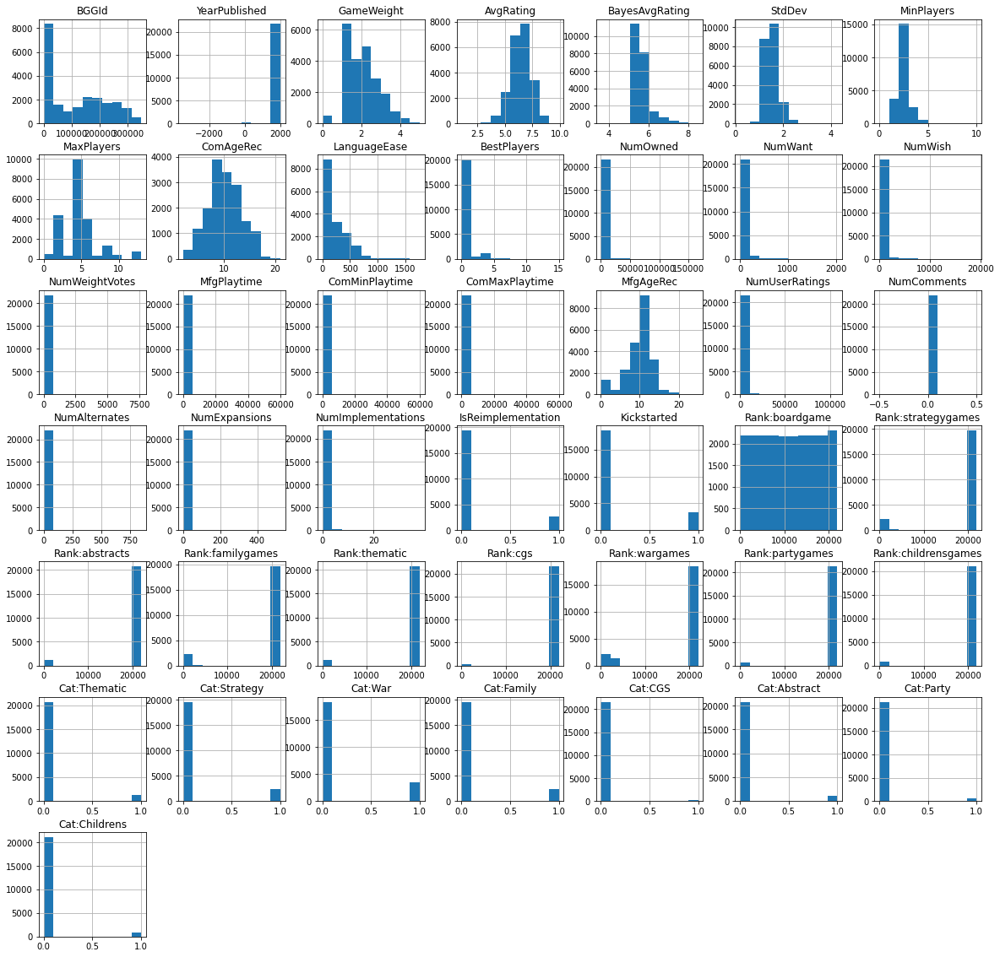

In [10]:
games.hist(figsize=(20, 20));

In [11]:
# determine playtime for each game according to community
games["Playtime"] = 0
games["Playtime"] = games.apply(
    lambda x: np.mean(x["ComMinPlaytime"] + x["ComMaxPlaytime"]), axis=1
)

# set upper cap on playtime
over_6_hours = list(games.loc[games["Playtime"] > 360].index)
games.loc[over_6_hours, "Playtime"] = 360

## Top 100, Top 1000, Top 5000 sets

##### All Games Top 100, Top 1000, and Top 5000

In [12]:
tenpercent = int(games.shape[0] * 0.1)
tenpercent

2192

In [13]:
# Make top 100, 500, 1000, 5000 games
games_100 = games.sort_values("Rank:boardgame", ascending=True)[:100]
games_500 = games.sort_values("Rank:boardgame", ascending=True)[:500]
games_1000 = games.sort_values("Rank:boardgame", ascending=True)[:1000]
games_5000 = games.sort_values("Rank:boardgame", ascending=True)[:5000]
games_tenpercent = games.sort_values("Rank:boardgame", ascending=True)[:tenpercent]

In [14]:
# Make top 100, 500, 1000, 5000 games
games_100_lean = (
    games[["BGGId", "Name", "Rank:boardgame", "AvgRating", "BayesAvgRating"]]
    .sort_values("Rank:boardgame", ascending=True)[:100]
    .set_index("BGGId")
)
games_500_lean = (
    games[["BGGId", "Name", "Rank:boardgame", "AvgRating", "BayesAvgRating"]]
    .sort_values("Rank:boardgame", ascending=True)[:500]
    .set_index("BGGId")
)
games_1000_lean = (
    games[["BGGId", "Name", "Rank:boardgame", "AvgRating", "BayesAvgRating"]]
    .sort_values("Rank:boardgame", ascending=True)[:1000]
    .set_index("BGGId")
)
games_5000_lean = (
    games[["BGGId", "Name", "Rank:boardgame", "AvgRating", "BayesAvgRating"]]
    .sort_values("Rank:boardgame", ascending=True)[:5000]
    .set_index("BGGId")
)
games_tenpercent_lean = (
    games[["BGGId", "Name", "Rank:boardgame", "AvgRating", "BayesAvgRating"]]
    .sort_values("Rank:boardgame", ascending=True)[:tenpercent]
    .set_index("BGGId")
)

##### Mechanics Top 100, Top 1000, and Top 5000

In [15]:
mechanics = pd.read_pickle("data_store/data_cleaned/mechanics.pkl")

In [16]:
mechs_100 = games_100_lean.join(
    mechanics.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

mechs_500 = games_500_lean.join(
    mechanics.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

mechs_1000 = games_1000_lean.join(
    mechanics.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

mechs_5000 = games_5000_lean.join(
    mechanics.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

mechs_tenpercent = games_tenpercent_lean.join(
    mechanics.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

In [25]:
mechs_100.head()

,BGGId,Name,Rank:boardgame,AvgRating,BayesAvgRating,Alliances,Area Majority / Influence,Auction/Bidding,Dice Rolling,Hand Management,Simultaneous Action Selection,Trick-taking,Hexagon Grid,Once-Per-Game Abilities,Set Collection,Tile Placement,Action Points,Investment,Market,Square Grid,Stock Holding,Victory Points as a Resource,Enclosure,Pattern Building,Pattern Recognition,Modular Board,Network and Route Building,Point to Point Movement,Melding and Splaying,Negotiation,Trading,Push Your Luck,Income,Race,Random Production,Variable Set-up,Roll / Spin and Move,Variable Player Powers,Action Queue,Bias,Grid Movement,Lose a Turn,Programmed Movement,Scenario / Mission / Campaign Game,Voting,Events,Paper-and-Pencil,Player Elimination,Role Playing,Movement Points,Simulation,Variable Phase Order,Area Movement,Commodity Speculation,Cooperative Game,Deduction,Sudden Death Ending,Connections,Highest-Lowest Scoring,Betting and Bluffing,Memory,Score-and-Reset Game,Layering,Map Addition,Secret Unit Deployment,Increase Value of Unchosen Resources,Ratio / Combat Results Table,Take That,Team-Based Game,Campaign / Battle Card Driven,Tech Trees / Tech Tracks,Player Judge,Chit-Pull System,Three Dimensional Movement,Action Drafting,Minimap Resolution,Stat Check Resolution,Action Timer,Pick-up and Deliver,Map Deformation,Bingo,Crayon Rail System,Multiple Maps,Hidden Roles,Line Drawing,Tug of War,Pattern Movement,Static Capture,Different Dice Movement,Chaining,Ladder Climbing,Predictive Bid,Solo / Solitaire Game,Line of Sight,Critical Hits and Failures,Interrupts,Zone of Control,Bribery,End Game Bonuses,Area-Impulse,Worker Placement,Measurement Movement,Map Reduction,Real-Time,Resource to Move,Mancala,Ownership,Kill Steal,Hidden Movement,Track Movement,Deck Construction,Drafting,TableauBuilding,Prisoner's Dilemma,Hidden Victory Points,Movement Template,Slide/Push,Targeted Clues,Command Cards,Grid Coverage,Relative Movement,Action/Event,Card Play Conflict Resolution,"I Cut, You Choose",Die Icon Resolution,Elapsed Real Time Ending,Advantage Token,Storytelling,Catch the Leader,Roles with Asymmetric Information,Traitor Game,Moving Multiple Units,Semi-Cooperative Game,Communication Limits,Time Track,Speed Matching,Cube Tower,Re-rolling and Locking,Impulse Movement,Loans,Delayed Purchase,"Deck, Bag, and Pool Building",Move Through Deck,Single Loser Game,Matching,Induction,Physical Removal,Narrative Choice / Paragraph,Pieces as Map,Follow,Finale Ending,Order Counters,Contracts,Passed Action Token,King of the Hill,Action Retrieval,Force Commitment,Rondel,Automatic Resource Growth,Legacy Game,Dexterity,Physical
0,174430,Gloomhaven,1,8.74997,8.51488,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0
1,161936,Pandemic Legacy: Season 1,2,8.59678,8.44451,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,224517,Brass: Birmingham,3,8.66562,8.41573,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,167791,Terraforming Mars,4,8.41879,8.27421,0,0,0,0,1,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

##### Designers Top 100, Top 1000, and Top 5000

In [18]:
designers = pd.read_pickle("data_store/data_cleaned/designers_all.pkl")

In [19]:
designers_100 = games_100_lean.join(
    designers.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

designers_500 = games_500_lean.join(
    designers.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

designers_1000 = games_1000_lean.join(
    designers.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

designers_5000 = games_5000_lean.join(
    designers.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

designers_tenpercent = games_tenpercent_lean.join(
    designers.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

In [26]:
designers_100.head()

,BGGId,Name,Rank:boardgame,AvgRating,BayesAvgRating,Karl-Heinz Schmiel,"G. W. ""Jerry"" D'Arcey",Reiner Knizia,Christian Beierer,Sid Sackson,Jean du Poël,Robert P. Moore,Martin Wallace,Richard Ulrich,Wolfgang Kramer,Alan R. Moon,Uwe Rosenberg,Klaus Teuber,Reinhard Staupe,Bill Eberle,Bill Norton,Jack Kittredge,Peter Olotka,Stefan Dorra,James Ernest,Richard Garfield,Gérard Delfanti,Gérard Mathieu,Pascal Trigaux,Mark A. Snowden,Richard Hamblen,Glenn Rahman,Kenneth Rahman,Christian T. Petersen,Don Greenwood,Jared Scarborough,Robert J. Simpson,Steve Jackson (I),Franck Parcabe,Roland Scaron,Alan Coleman,Roger Burten,Vincent A. A. J. Erato,Eamon Bloomfield,Alex Randolph,Charlie Krank,Lynn Willis,Richard Launius,Sandy Petersen,Stephen V. Cole,Ian Livingstone,Richard Borg,Karsten Hartwig,Gerard Mulder,Nigel Stillman,Rick Priestley,Valentin Herman,Michael Kiesling,Ken Howard,Robert Hyde,Gilles Monnet,Yves Hirschfeld,Doug Kaufman,Robert J. Kuntz,Tom Wham,Wilko Manz,Philippe Keyaerts,Klaus Palesch,Stephen Hand,Dan Campagna,Pascal Bernard,Donald Benge,Mark Simonitch,Richard H. Berg,Rob Nelson,Franz-Benno Delonge,Francis Tresham,Marcel-André Casasola Merkle,Dirk Henn,Mark Alan Osterhaus,Matthew Kirby,Evan Davis (I),Craig Besinque,Tom Dalgliesh,Gary Selkirk,Lance Gutteridge,Steve Brewster,Grant Dalgliesh,Evan Jones,Craig Van Ness,Ted Raicer,Doris Matthäus,Frank Nestel,"Larry Harris, Jr.",Michael Gray,David A. Trampier,Jason B. McAllister,Mike Fitzgerald,Kris Burm,Dominique Ehrhard,Duccio Vitale,Justin Kemppainen,Philip O'Neill,Paul Peterson,Niek Neuwahl,Simon Knock,Mark McLaughlin,Peter Burley,Darwin Bromley,Wolfgang Lüdtke,Friedemann Friese,Thorsten Gimmler,Michael Schacht,Juan Rodriguez,Los Rodriguez,Roger Heyworth,Sylvie Barc,"Edward Horn, Jr.",Edgar Cayce,George S. Parker,Harry Gavitt,Christwart Conrad,James J. St. Laurent,Klaus Kreowski,Reinhold Wittig,Dieter Danziger,Ursula Kramer,Larry Roznai,Steven Courtemanche,Laura Robinson,Paul Toyne,Eric Solomon,Greg Porter,Bill Fawcett,David B. Bromley,(Uncredited),Eric Randall,Laurent Lavaur,Hanno Kuhn,Wilfried Kuhn,Albert Lamorisse,Michael I. Levin,David Hoyt,Reiner Stockhausen,Horst-Rainer Rösner,Ken Whitman,Sergio Aragonés,Urs Hostettler,James Kyle,Andreas Seyfarth,Ben van Dijk,Wil Dijkstra,Jim Lin,Skaff Elias,Rüdiger Dorn,Rudi Hoffmann,Larry Winters,P. Winters,Gary Dicken,Phil Kendall,Steve Kendall,Andrew Looney,John Cooper,Corné van Moorsel,Charlie Wiedman,John Nephew,S. Craig Taylor,Irad B. Hardy,Lewis Pulsipher,Thomas Lehmann,Ben Grossman,Eric Goldberg,Nikola Vrtis,Steve Marsh (I),Steven Marsh (II),Vincent Tsao,Michael S. Matheny,Gabriele Ausiello,Michele Quondam,Mick Ado,Derek Carver,Paul Cockburn,Ronald Wettering,Peter Hawes,John Young,Greg Pinder,Harry Rowland,Tom Walczyk,Werner Hodel,Kristin Looney,Ben Knight,Günter Burkhardt,Neal Schlaffer,Klaus Paal,Dan Glimne,Henrik Strandberg,Bernhard Weber,Francis Pacherie,Stephen Hubell,Kevin Zucker,Nicolas Pilartz,Fabian Fridholm,Johan Palén,Kim Bergström,Bruce Harper,Phil Eklund,J. C. Connors (I),James B. Wood,François-Stanislas Thomas,Charles Vasey,Philippe Mouchebeuf,Jacques Zeimet,Richard Breese,Leo Colovini,Philip C. Barker,Richard Bodley Scott,Sue Laflin Barker,Hartmut Witt,Richard Winter,Günter Cornett,Garrett J. Donner,Michael S. Steer,Mick Uhl,Willis P. Carpenter,Reinhard Herbert,Tom Kruszewski,Anthony Watts,Mark Caines,Eberhard Schnatz,Alfred Mosher Butts,Bertram Kaes,Virginia Charves,Gerhard E. Kodys,Spartaco Albertarelli,Carol Wiseley,Masaru Aoki,John Bohrer,Neil Zimmerer,Richard Halliwell,Mattiene Moustakas,Charles Phillips,Marsha J. Falco,Phil Orbanes Sr.,Helga Huber,Hermann Huber,Scott Kimball,David Parlett,Henri Sala,Frank DiLorenzo,Stacey Merrill,Ellen Washburne,Jack Montgomery,Norman Washburne,Steve Doherty,David Coutts,Michael Rieneck,Douglas Seaton,Albrecht Nolte,Scott Peterson,Bruno Faidutti,Oliver Abendroth,Thomas Fackler,Peter Schurzmann,Darrell Hardy,Tod Gelle,Tom Jolly,Jim Van Verth,Migou Auteurs,Robert Cepo,Bernhard N

##### Artists Top 100, Top 1000, and Top 5000

In [21]:
artists = pd.read_pickle("data_store/data_cleaned/artists_all.pkl")

In [22]:
artists_100 = games_100_lean.join(
    artists.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

artists_500 = games_500_lean.join(
    artists.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

artists_1000 = games_1000_lean.join(
    artists.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

artists_5000 = games_5000_lean.join(
    artists.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

artists_tenpercent = games_tenpercent_lean.join(
    artists.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

In [27]:
artists_100.head()

,BGGId,Name,Rank:boardgame,AvgRating,BayesAvgRating,Harald Lieske,Marcus Gschwendtner,Bob Pepper,Franz Vohwinkel,Thomas di Paolo,Peter Whitley,Scott Okumura,Jean du Poël,(Uncredited),S. Mattusek,Bryan King,Doris Matthäus,Alan R. Moon,Alexander Jung,Andrea Boekhoff,Atelier Löwentor,Barbara Stachuletz,Björn Pertoft,Fréderic Bertrand,Guido Hoffmann,Inge George,Johann Rüttinger,Klemens Franz,Marek Bláha,Markus Wagner,Oliver Freudenreich,Uwe Rosenberg,Allison Kline,Gahyun Lee,Ian O'Toole,Tiago Sousa,Jason Hawkins,Marion Pott,Matt Schwabel,Michael Menzel,Michaela Kienle,Pete Fenlon,Stephen Graham Walsh,Tanja Donner,Volkan Baga,John Kovalic,Lüders & Baran,Stefan Theurer,Anders Jeppsson,Chris Ferguson,Dean Morrissey,John Blanche,Lori Walls,Paul Render,Oliver Vogel,Adam Hughes,Andrew Yates,Brian Snoddy,Cheyenne Wright,Gerald Brom,John Nephew,Larry Elmore,Michelle Nephew,Pete Abrams,Phil Foglio,Ryan Kinnaird,Bob Carasca,Daniel Gelon,Jennifer Lathrop,Paul Sottosanti,Peter Bergting,Chris McGloughlin,Pascal Trigaux,Chris White (I),George Goebel,Kim Grommel,Randall C. Reed,Richard Hamblen,David A. Trampier,"David C. Sutherland, III",Kenneth Rahman,Bill Heagy,Christian T. Petersen,Kurt Miller,Stephen Langmead,C. Mara Lee,Carl Manz,Cliff Van Meter,Czeslaw Sornat,Dan Smith,Dave Martin,Frank Gerwin,Jeffrey D. George,John Grigni,Lar DeSouza,Shea Ryan,Jacques Tardi,Chris Baker,Dahee Lee,Lisa Plangger,Tom Sullivan,David Martin (II),"William H. Keith, Jr.",Christos Achilleos,Franz-Josef Schulte,Linda Bound,Hannah M. G. Shapero,Frank Frazetta,Atelier Wilinski,Gabriel Laulunen (II),Heiko Günther,Klaus Wilinski,Ronan Le Maître,Walter Pepperle,Bascu,Christine Conrad,Ricarda Thiel,Tom Thiel,Christian Schütte,Alexander Bradley,Bildgården AB,Design Edge,H.P. Hoff,Heinz Grafische Werke,Martin Lodewijk,Rita Åse,Ron Zalme,Thierry Masson,David Cherry,Dominique Ehrhard,Vincent Dutrait,Mathieu Leyssenne,Anke Pohl,Claus Stephan,Thilo Rick,Albrecht Altdorfer,Colin Howard,Dave Andrews,John Sibbick,Kevin Walker,Martin McKenna,Paul Bonner,Russ Nicholson,Stephen Tappin,Tony Ackland,Christophe Swal,Mariusz Gandzel,Paul Mafayon,Sarah Perkins,Charles Elliot (I),Kevin Wilkins,Loring Eutemey,Martin Hoffmann,Ray-Mel Cornelius,Richard A. Johnson,Tom Wham,Walter Velez,Cyril Saint Blancat,Aly Morrison,Gary Chalk,James Warhola,Trish Morrison,Arnold Hendrick,Steve Burnett,Greg Cervall,Thibaud Béghin,Andreas Steiner,Donald Benge,Mark Simonitch,Patrick O'Brien,Charles Kibler,Dale Sheaffer,Ed Dovey,Guillaume Rohmer,Rodger B. MacGowan,Marcel-André Casasola Merkle,Jo Hartwig,Oliver Schlemmer,Reinhard Horst,Drew Pocza,James Ernest,Val Mayerik,Eric Hotz,Jody Harmon,Ron Gibson,Alessandra Cimatoribus,Terry Leeds,Jim Butcher (II),Ramon Mascarenas,Seth Schwartz,Oliver Moser,Kenn Nishiuye,Mike Doyle (I),Cyrille Daujean,Dan Harding,Jan Patrik Krásný,Keith Parkinson,Steve Holmes,Thierry Doizon,Tyson Milbert,Virginijus Poshkus,lu'cifer,Jochen Frick,William O'Connor,David Palumbo,John Goodenough,Mohammad Noureddine,Samuel R. Shimota,Scott Nicely,Serge Hochain,Tomasz Jedruszek,Hailey Ha Jung,Makiko Kodama,別府さい (Sai Beppu),Lewis Michael,Mike Raabe,Quinton Hoover,Carole Carrion,Chen Cheng-po,Daniel Melim,Manuel Carvalho,Paul Laane,Rafael Silveira,Ramon Martins,Sigrid Thaler,Zeilbeck & Natzeck Design Company,Anders Finér,Eric Lofgren,Henning Ludvigsen,Jim Pavelec,Kevin Childress,Peter Tikos,Björn Lindsten,Cornelia von Seidlein,Leif Åbjörnsson,Ritva Hussain-Shahid,Christophe Peulvast,Fabrice Lamy,Jean Baer,Mick Uhl,Olivier Vatine,Jessica Ney,Marek Szyszko,Paul Niemeyer,Alexander Strohmaier,Steve Tolley,Thomas Weiss,Chris Vande Voort,Javier González Cava,"Lars-Arne ""Maura"" Kalusky",Olivier Frot,G. Husner,Patrick Fix,Simon Roberts,Andrea Trewhela,Nick the Rat,Olivier Fagnère,Paul Couture,Paul T.,Peekasso,Randy Asher,Thoren,Alvin Madden,Miles Germer,William Bricker,Nicholas Price,Reinhold Wittig,Dieter Danziger,Ralf E. Kahlert,Gerhard Schmid,Ike Scott,Maria Cabardo,Mike Atkinson,Stefan Sierhej,Bever

##### Publishers Top 100, Top 1000, and Top 5000

In [28]:
publishers = pd.read_pickle("data_store/data_cleaned/publishers_all.pkl")

In [29]:
publishers_100 = games_100_lean.join(
    publishers.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

publishers_500 = games_500_lean.join(
    publishers.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

publishers_1000 = games_1000_lean.join(
    publishers.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

publishers_5000 = games_5000_lean.join(
    publishers.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

publishers_tenpercent = games_tenpercent_lean.join(
    publishers.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

In [30]:
publishers_100.head()

,BGGId,Name,Rank:boardgame,AvgRating,BayesAvgRating,Hans im Glück,Moskito Spiele,Portal Games,Spielworxx,Stronghold Games,"Valley Games, Inc.",YOKA Games,sternenschimmermeer,E.S. Lowe,Milton Bradley,999 Games,ABACUSSPIELE,Astrel Games,Ceilikan Jogos,Descartes Editeur,Edge Entertainment,Fantasy Flight Games,Galakta,Hobby Japan,"Korea Boardgames Co., Ltd.",Lacerta,Lautapelit.fi,Rio Grande Games,Skandinavisk Spil Kompagni,Smart Ltd,Wargames Club Publishing,KOSMOS,3M,"Avalon Hill Games, Inc.",Dujardin,Grow Jogos e Brinquedos,PS-Games,Schmidt France,Schmidt International,Schmidt Spiele,Selecta Spel en Hobby,"Smart Games, Inc.",The Avalon Hill Game Co,Historien Spiele Galerie (Historien Spielegalerie),Brightway Products Ltd,Falomir Juegos,"Family Games, Inc.",Gazebo Games UK Ltd.,Gigamic,Holzinsel,Lagoon Games,Mattel,Robert P. Moore Games,Yangxin Industrial Company Limited,Vendetta,Warfrog Games,AMIGO,Albi,Corfix,Hobby World,Midgaard Games,Brain Games,Broadway Toys LTD,Brädspel.se,Copag Cards,Fractal Juegos,G3,Giochi Uniti,Kaissa Chess & Games,Kikigagne?,Lifestyle Boardgames Ltd,Lookout Games,Mercurio,Möbius Games,Paper Iyagi,PaperGames (III),Piatnik,Stratelibri,"Swan Panasia Co., Ltd.",Tempo Games (I),25th Century Games,DiceTree Games,"New Games Order, LLC",Precisamente,Ravensburger,Windrider Games,alea,Überplay,Asmodee,Bergsala Enigma (Enigma),"Capcom Co., Ltd.",Catan Studio,Competo / Marektoy,Devir,Dexy Co,Eurogames,Filosofia Éditions,GP Games,HaKubia,Hanayama,Ideal Board Games,Igroljub,IntelliGames.BG,L&M Games,Laser plus,Logojogos,Mayfair Games,Ninive Games,Spilbræt.dk,Stupor Mundi,SuperHeated Neurons,TRY SOFT,Tilsit,Top Toys,Vennerød Forlag AS,danspil,Ísöld ehf.,F.X. Schmid,Out of the Box Publishing,ASS Altenburger Spielkarten,Alga,Eon,Games Workshop Ltd.,Tsukuda Hobby,West End Games,(Unknown),Atlas Games,Cheapass Games,Five Rings Publishing Group,Guardians of Order,Looney Labs,Slag-Bla entertainment (now XXXenophile Books),Studio Foglio,Truant Spiele,ADC Blackfire Entertainment,Hasbro,Play Factory,Wizards of the Coast,Ludodélire,Twentieth Century Renaissance,Right Stuf,TSR,Supremacy Games,Finnish Game House,Laurin Verlag,Pegasus Spiele,Queen Games,Raven Distribution,Steve Jackson Games,Ubik,AS Company,Canada Games,Crown & Andrews Ltd.,Diset S. A.,Kod Kod,Waddingtons,Action GT,BHS Games,Lakeside,OPEN'N PLAY,Pelikan,Popcorn Games,Venice Connection,Winning Moves France,Chaosium,"Amarillo Design Bureau, Inc.",Task Force Games,franjos Spieleverlag,Edition Spielkunst,Welt der Spiele,Borras Plana S.A.,Clipper,Eagle-Gryphon Games,Editrice Giochi,Face2Face Games,Gonggan27,Maldito Games,Miro Company,Oya,Palitoy Ltd.,Parker Brothers,förlAgo AB,CZ Cloud Soft Co. Ltd,Galápagos Jogos,Heidelberger Spieleverlag,Matagot,Top Licence Games,Z-Man Games,Berliner Spielkarten,Playroom Entertainment,(Public Domain),(Self-Published),A. F. Blake Enterprises,Arclight,Blake Enterprises,Brybelly,Cappelen,Cardinal,Damm / Egmont,Endless Games (I),"Friendly Games, Inc.",Front Porch Classics,Inca Perudo,International Games,Jumbo,KOZAK Games,L4 Studios,McNaughty Games,Mr. B Games,Outset Media,Paul Lamond Games Ltd,Planet Finska,Pressman Toy Corp.,"Reveal Entertainment, Inc.",Spin Master Ltd.,The Op,University Games,Walt Disney Productions,Zygomatic,Devil Dice Games,Grail Games,Lui-même,Mandoo Games,Quined White Goblin Games,Siam Board Games,La Tana dei Goblin,TM Spiele,HomoLudicus,Red Glove,cutia.ro,dV Giochi,Group SNE,IELLO,Land of Beautiful Mind (سرزمین ذهن زیبا),Playhouse Ltd,Zvezda,گیمِ پندو (Pendo Games),Gém Klub Kft.,Happy Baobab,MS Edizioni,Playgo Hungary,Fanfor-Verlag,Conclave Editora,Egmont Polska,Hobby Game Mall,Keep Exploring Games,Kellogg's,Super Meeple,Orion,Pontaccio,Sophisticated Games,Goldsieber Spiele,Sfera,Battleline,Clash of Arms Games,Bütehorn Spiele (Buchholz Verlag),Hexagames (I),Numbskull Games,Quest Games,Wydawnictwo Gołębiewski,Cadaco,The London Game Company LTD,ACE Pelit Oy,Compendium Games,Gibsons,Hartland Trefoil Ltd.,Joc Internaci

##### Categories Top 100, Top 1000, and Top 5000

In [31]:
themes = pd.read_pickle("data_store/data_cleaned/themes.pkl")

In [32]:
themes_100 = games_100_lean.join(
    themes.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

themes_500 = games_500_lean.join(
    themes.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

themes_1000 = games_1000_lean.join(
    themes.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

themes_5000 = games_5000_lean.join(
    themes.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

themes_tenpercent = games_tenpercent_lean.join(
    themes.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

In [33]:
themes_100.head()

,BGGId,Name,Rank:boardgame,AvgRating,BayesAvgRating,Adventure,Fantasy,Fighting,Environmental,Medical,Economic,Industry / Manufacturing,Transportation,Science Fiction,Space Exploration,Civilization,Civil War,Movies / TV / Radio theme,Novel-based,Age of Reason,Mythology,Renaissance,American West,Animals,Modern Warfare,Medieval,Ancient,Nautical,Post-Napoleonic,Horror,Farming,Religious,Travel,Murder/Mystery,Pirates,Comic Book / Strip,Mature / Adult,Video Game Theme,Spies/Secret Agents,Arabian,Prehistoric,Trains,Aviation / Flight,Zombies,World War II,Racing,Pike and Shot,World War I,Humor,Sports,Mafia,American Indian Wars,Napoleonic,American Revolutionary War,Vietnam War,American Civil War,Number,Trivia,Music,Korean War,City Building,Political,Math,Maze,Theme_Food / Cooking,Theme_Superheroes,Theme_Anime / Manga,Theme_Cthulhu Mythos,Theme_Alternate History,Theme_Anthropomorphic Animals,Theme_Vikings,Theme_Post-Apocalyptic,Theme_Time Travel,Theme_Colonial,Theme_Mystery / Cri,Theme_Robots,Theme_Retro,Theme_Mad Science / Mad Scientist,Theme_Mining,Theme_Art,Theme_Archaeology / Paleontology,Theme_Witches,Theme_Deserts,Theme_Tropical,Theme_Steampunk,Theme_Gardening,Theme_Sieg,Theme_Flowers,Theme_Natur,Theme_Native Americans / First Peoples,Theme_Circus,Theme_Ninjas,Theme_King Arthur / The Knights of the Round Table / Camelot,Theme_Cyberpunk,Theme_Submarines,Theme_Construction,Theme_Samurai,Theme_Fantasy Sports,Theme_Love / Romanc,Theme_Biology,Theme_Kaiju,Theme_Gladiators,Theme_City,Theme_Villainy,Theme_Weather,Theme_Amusement Parks / Theme Parks,Theme_Airships / Blimps / Dirigibles / Zeppelins,Theme_Spooky Old Houses,Theme_Mech Warfar,Theme_Polic,Theme_Books / Libraries,Theme_Alchemy,Theme_Tropical Islands,Theme_Boardgaming,Theme_Oil / Gas / Petroleu,Theme_Arcade Video Games,Theme_Safaris,Theme_Dreams / Nightmares,Theme_Evolution,Theme_Survival,Theme_Fruit,Theme_Jail / Prison (Modern),Theme_Movie Industry,Theme_Animal Battles,Theme_Firefighting,Theme_Video Game Theme: Nintendo,Theme_Climate Chang,Theme_Helicopters,Theme_Psychology,Theme_Sci-Fi Sports,Theme_Sewing / Knitting / Cloth-Making,Theme_Beaches,Theme_Under the Sea,Theme_Aztecs,Theme_Trees and Forests,Theme_Mayans,Theme_Chibis,Theme_US National Parks,Theme_Scienc,Theme_Chemistry,Theme_Volcanoes,Theme_Fictional Games,Theme_Druids,Theme_Music Making & Makers,Theme_Psychic Powers,Theme_Trash / Garbag,Theme_Silk Road,Theme_Cereal Games,Theme_Automotive Industry,Theme_Video Game Theme: Tetris,Theme_TV Detectives,Theme_Romance of the Three Kingdoms,Theme_Trucks,Theme_Hanseatic Leagu,Theme_Chivalry / Jousting / Tournaments (Medieval Europe),Theme_Cannibals / Cannibalis,Theme_Canals,Theme_My Best Lif,Theme_Nuclear option,Theme_Astronomy,Theme_Cemeteries / Graveyards,Theme_Movies,Theme_Hackers,"Theme_Pub, Bars, Bistros...",Theme_Jewelry,Theme_School / College / University,Theme_UFOs,Theme_Templ,Theme_Mail / Stamps / The Post Offic,Theme_Memes,Theme_Computer / Information Technology Industry,Theme_Attorneys / Courts,Theme_Hot Air Balloons,Theme_Journalis,Theme_Motorcycles,Theme_Rubik's Cub,Theme_Dolls,Theme_Traffic / Driving,Theme_FIFA World Cup,Theme_Video Game Theme: Pokémon,Theme_Floating islands in the sky,Theme_Dieselpunk,Theme_Disney Theme Parks,Theme_Video Game Theme: Resident Evil,Theme_Video Game Theme: SEGA,Theme_Teaching Programming,Theme_Battle Royal,Theme_Earthquakes,Theme_Bacteria,Theme_Painting / Paintings,Theme_Television (TV) Industry,Theme_Knights Templar,Theme_African Americans,Theme_Hell,Theme_Tiki Cultur,Theme_Astrology,Theme_Video Game Theme: The Oregon Trail,Theme_Māori,Theme_Video Game Theme: Super Mario Bros.,Theme_Mushrooms,Theme_Pulp,Theme_Video Game Theme: Minecraft,Theme_Video Game Theme: Final Fantasy,Theme_Video Game Theme: Carmen Sandiego,Theme_Care Bears,Theme_Hike-Hiking,Theme_Inuit Peoples,Theme_Perfu,Theme_Camping,Theme_Latin American Political Games,Theme_Spanish Political Games,Theme_Video Game Theme: Doo,Theme_Fashion,Theme_Geocaching,Theme_Ecology,Th

##### Ratings Distribution Top 100, Top 1000, and Top 5000

In [109]:
ratings_distribution = pd.read_pickle("data_store/data_cleaned/ratings_distribution.pkl")

In [148]:
ratings_100 = games_100_lean.join(
    ratings_distribution.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

ratings_500 = games_500_lean.join(
    ratings_distribution.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

ratings_1000 = games_1000_lean.join(
    ratings_distribution.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

ratings_5000 = games_5000_lean.join(
    ratings_distribution.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

ratings_tenpercent = games_tenpercent_lean.join(
    ratings_distribution.set_index("BGGId"), on="BGGId", how="left"
).reset_index()

In [149]:
ratings_100.head()

,BGGId,Name,Rank:boardgame,AvgRating,BayesAvgRating,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95
0,174430,Gloomhaven,1,8.74997,8.51488,0.0,0.0,0.0,451.0,1.0,0.0,1.0,0.0,6.0,1.0,0.0,0.0,0.0,222.0,1.0,0.0,2.0,0.0,6.0,0.0,1.0,1.0,0.0,349.0,2.0,0.0,1.0,0.0,8.0,1.0,0.0,2.0,2.0,374.0,0.0,2.0,1.0,5.0,14.0,2.0,3.0,2.0,3.0,713.0,0.0,0.0,2.0,3.0,55.0,2.0,3.0,6.0,3.0,1589.0,5.0,6.0,9.0,4.0,194.0,11.0,10.0,25.0,12.0,2868.0,11.0,31.0,18.0,20.0,559.0,19.0,27.0,54.0,34.0,5868.0,41.0,74.0,35.0,40.0,1194.0,69.0,70.0,127.0,70.0,10908.0,82.0,170.0,98.0,79.0,1860.0,101.0,94.0,219.0,141.0,18202.0,47299.0
1,161936,Pandemic Legacy: Season 1,2,8.59678,8.44451,0.0,0.0,0.0,437.0,5.0,0.0,0.0,0.0,5.0,0.0,0.0,1.0,0.0,192.0,0.0,1.0,0.0,0.0,5.0,1.0,0.0,3.0,0.0,248.0,1.0,1.0,1.0,1.0,7.0,0.0,1.0,0.0,1.0,296.0,1.0,1.0,1.0,1.0,17.0,1.0,1.0,4.0,3.0,569.0,4.0,2.0,0.0,2.0,46.0,5.0,2.0,2.0,3.0,1442.0,2.0,7.0,4.0,9.0,216.0,8.0,8.0,19.0,9.0,3235.0,13.0,39.0,31.0,28.0,657.0,29.0,30.0,106.0,49.0,7360.0,51.0,117.0,73.0,68.0,1575.0,75.0,74.0,176.0,90.0,12105.0,85.0,143.0,86.0,89.0,1661.0,110.0,56.0,155.0,99.0,12695.0,44756.0
2,224517,Brass: Birmingham,3,8.66562,8.41573,0.0,0.0,0.0,68.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,33.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,78.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2.0,109.0,2.0,1.0,1.0,0.0,6.0,0.0,1.0,0.0,0.0,218.0,2.0,0.0,1.0,1.0,12.0,1.0,1.0,0.0,3.0,587.0,3.0,2.0,1.0,5.0,92.0,3.0,9.0,9.0,6.0,1713.0,9.0,24.0,21.0,16.0,438.0,20.0,33.0,57.0,36.0,4720.0,45.0,105.0,54.0,59.0,1272.0,89.0,75.0,151.0,83.0,7220.0,74.0,150.0,70.0,75.0,1090.0,83.0,74.0,115.0,55.0,5660.0,24946.0
3,167791,Terraforming Mars,4,8.41879,8.27421,0.0,0.0,0.0,184.0,3.0,1.0,0.0,0.0,0.0,1.0,0.0,2.0,0.0,140.0,0.0,0.0,1.0,0.0,5.0,0.0,1.0,0.0,0.0,362.0,2.0,1.0,1.0,0.0,14.0,1.0,0.0,2.0,1.0,607.0,2.0,0.0,1.0,4.0,19.0,1.0,4.0,4.0,0.0,1160.0,2.0,9.0,6.0,2.0,81.0,5.0,3.0,11.0,6.0,3060.0,7.0,13.0,8.0,6.0,446.0,14.0,29.0,68.0,18.0,7107.0,40.0,92.0,67.0,52.0,1648.0,75.0,86.0,222.0,118.0,15172.0,130.0,287.0,163.0,205.0,3204.0,190.0,203.0,361.0,161.0,19256.0,156.0,319.0,155.0,156.0,2123.0,137.0,101.0,213.0,119.0,14713.0,73349.0
4,233078,Twilight Imperium: Fourth Edition,5,8.67916,8.25955,0.0,0.0,0.0,92.0,8.0,0.0,0.0,0.0,7.0,0.0,0.0,1.0,0.0,111.0,1.0,1.0,0.0,0.0,6.0,0.0,0.0,0.0,0.0,96.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,123.0,0.0,1.0,1.0,0.0,6.0,1.0,1.0,2.0,2.0,217.0,4.0,0.0,1.0,0.0,16.0,0.0,1.0,0.0,2.0,620.0,2.0,7.0,5.0,3.0,83.0,1.0,3.0,8.0,6.0,1086.0,7.0,7.0,8.0,8.0,217.0,10.0,14.0,35.0,16.0,2204.0,19.0,29.0,26.0,23.0,436.0,19.0,33.0,48.0,20.0,3667.0,20.0,60.0,26.0,21.0,255.0,0.0,0.0,0.0,0.0,0.0,9755.0


## Questions Repository

#### Recency Bias

In [43]:
past1970 = games.loc[
    (games["YearPublished"] >= 1970) & (games["YearPublished"] <= 2021)
]

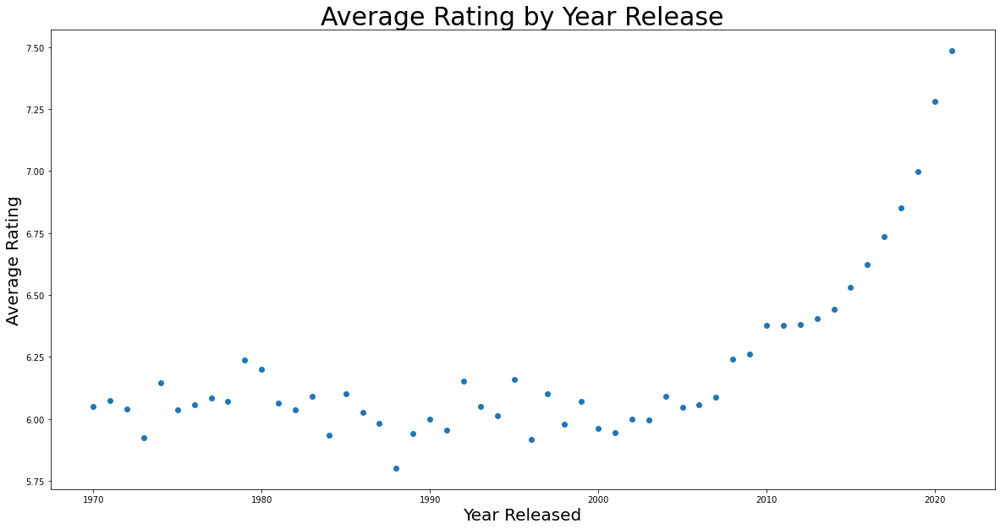

In [44]:
x_years = sorted(past1970["YearPublished"].unique())
y_averages = past1970.groupby("YearPublished")["AvgRating"].mean()

fix, ax = plt.subplots(figsize=(20, 10))
plt.scatter(x_years, y_averages)

plt.title("Average Rating by Year Release", fontsize=30)
plt.xlabel("Year Released", fontsize=20)
plt.ylabel("Average Rating", fontsize=20)
plt.savefig("recency_bias.png");

In [45]:
past1970["bias_adj_rating"] = past1970["AvgRating"] - past1970.groupby("YearPublished")[
    "AvgRating"
].transform("mean")

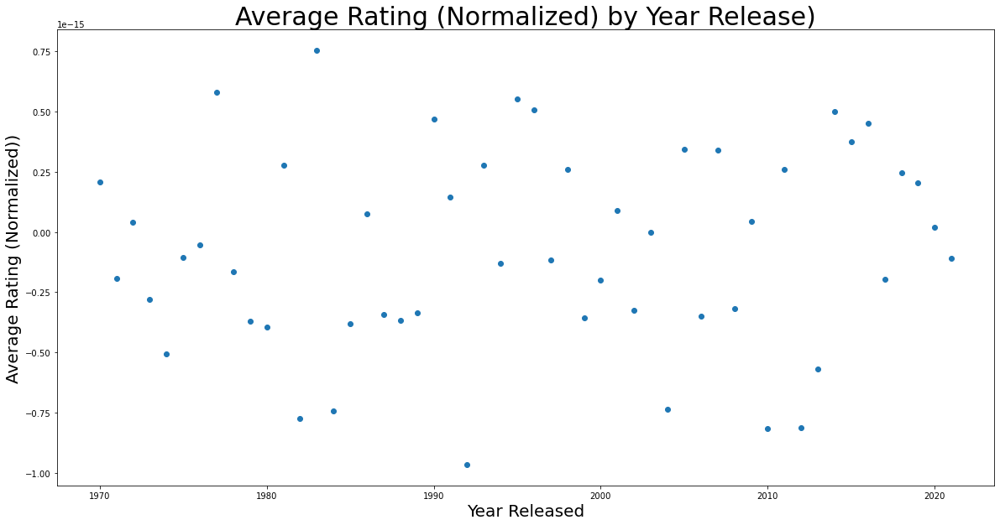

In [46]:
x_years = sorted(past1970["YearPublished"].unique())
y_averages = past1970.groupby("YearPublished")["bias_adj_rating"].mean()

fix, ax = plt.subplots(figsize=(20, 10))
plt.scatter(x_years, y_averages)

plt.title("Average Rating (Normalized) by Year Release)", fontsize=30)
plt.xlabel("Year Released", fontsize=20)
plt.ylabel("Average Rating (Normalized))", fontsize=20)
plt.savefig("recency_bias_normalized.png");

#### User engagement time

In [47]:
def clean_ratings(id_num):
    """Takes in a "dirty" rating file, cleans to proper data formats and returns"""

    print("\nCleaning Frame #" + str(id_num))

    # load in raw users file
    users = pd.read_pickle("data_store/data_dirty/ratings_dates" + str(id_num) + ".pkl")

    # convert all datatypes to float
    users["BGGId"] = users["BGGId"].astype("int32")
    users["Rating"] = users["Rating"].astype("float")
    users["Date_rated"] = pd.to_datetime(users["Date_rated"]).dt.date
    users["Date_rated"] = pd.to_datetime(users["Date_rated"])

    # return cleaned file
    return users

In [48]:
def create_ratings_file(num_files):
    """Loads incremental file numbers, cleans each file, appends to dataframe. Returns compiled dataframe"""

    master_file = pd.DataFrame()

    num_files = num_files

    for id_num in np.arange(1, num_files + 1, 1):
        cleaned_item = clean_ratings(id_num)
        master_file = pd.concat([master_file, cleaned_item], axis=0)

    return master_file

In [49]:
# Clean the files

user_ratings_date = create_ratings_file(19)


Cleaning Frame #1

Cleaning Frame #2

Cleaning Frame #3

Cleaning Frame #4

Cleaning Frame #5

Cleaning Frame #6

Cleaning Frame #7

Cleaning Frame #8

Cleaning Frame #9

Cleaning Frame #10

Cleaning Frame #11

Cleaning Frame #12

Cleaning Frame #13

Cleaning Frame #14

Cleaning Frame #15

Cleaning Frame #16

Cleaning Frame #17

Cleaning Frame #18

Cleaning Frame #19


In [179]:
# check ratings file

user_ratings_date

,Username,BGGId,Rating,Date_rated
0,Fu_Koios,223033,9.0,2017-10-05
1,Fu_Koios,112092,9.0,2013-01-25
0,-DE-,21241,10.0,2006-07-14
0,-Johnny-,7865,3.0,2010-11-28
1,-Johnny-,30363,3.0,2010-03-06
...,...,...,...,...
336,MattyTh,13681,5.0,2013-12-05
337,MattyTh,2393,7.0,2016-04-16
338,MattyTh,145277,6.0,2015-04-30
339,MattyTh,528,8.0,2016-01-26


In [50]:
# get total ratings per user
total_votes = pd.DataFrame(user_ratings_date.groupby("Username").sum())

# get index of users with fewer than 30 ratings
low_votes = total_votes.loc[(total_votes["Rating"] < 30)].index

# make min rating dataframe with users who have min number ratings
user_ratings_min = user_ratings_date[~user_ratings_date.Username.isin(low_votes)]
user_ratings_min

# get ratings average per user
avg_ratings = pd.DataFrame(
    user_ratings_min.groupby("Username").mean().sort_values("Rating")
)

# get index of users who leave all 1s or all 10s
all_10s_or_1s = avg_ratings.loc[
    (avg_ratings["Rating"] == 10) | (avg_ratings["Rating"] == 1)
].index

# make cleaned user rating dataframe with users who don't rate all 1 or all 10
user_ratings_cleaned = user_ratings_min[
    ~user_ratings_min["Username"].isin(all_10s_or_1s)
]

del user_ratings_date
gc.collect()

user_ratings_cleaned

,Username,BGGId,Rating,Date_rated
0,-Johnny-,7865,3.0,2010-11-28
1,-Johnny-,30363,3.0,2010-03-06
2,-Johnny-,22278,5.0,2009-12-20
3,-Johnny-,94246,8.0,2012-05-28
4,-Johnny-,421,4.0,2009-04-30
...,...,...,...,...
336,MattyTh,13681,5.0,2013-12-05
337,MattyTh,2393,7.0,2016-04-16
338,MattyTh,145277,6.0,2015-04-30
339,MattyTh,528,8.0,2016-01-26


In [51]:
# prepare df for user's earliest interaction
user_ratings_earliest = pd.DataFrame()

# record each user's earliest interaction
user_ratings_earliest["Earliest_date_rated"] = user_ratings_cleaned.groupby("Username")[
    "Date_rated"
].min()

# record each user's average rating
user_ratings_earliest["Avg_Rating"] = user_ratings_cleaned.groupby("Username")[
    "Rating"
].mean()

# display sorting by earliest recorded date
user_ratings_earliest.sort_values("Avg_Rating")

,Earliest_date_rated,Avg_Rating
Username,,
Marcius985,2019-04-25,1.988636
Chino27,2017-05-12,2.210526
GrauGeist,2017-11-04,2.328947
Jigili,2019-10-26,2.367347
Harry Bumnapper,2018-05-29,2.575758
...,...,...
EDGE1980,2018-11-15,9.987792
BoardGamer2008,2011-11-20,9.988342
Isjohn,2018-10-05,9.990000


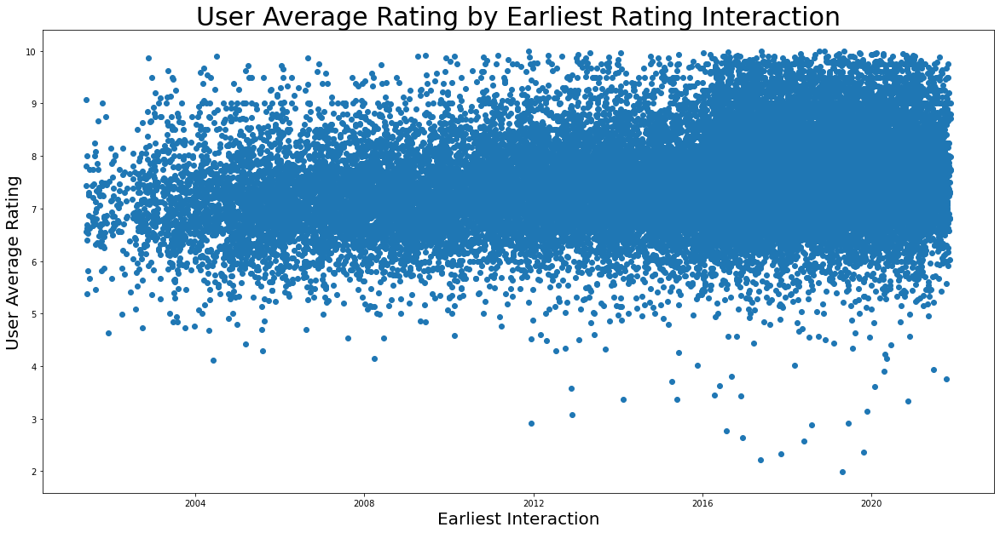

In [52]:
# plot earliest recorded date and average user rating

fig, ax = plt.subplots(figsize=(20, 10))

plt.scatter(
    user_ratings_earliest["Earliest_date_rated"], user_ratings_earliest["Avg_Rating"]
)

plt.title("User Average Rating by Earliest Rating Interaction", fontsize=30)
plt.xlabel("Earliest Interaction", fontsize=20)
plt.ylabel("User Average Rating", fontsize=20)
plt.savefig("user_avg_by_earliest.png");

Users who first engaged after 2016 were more likely to rate higher AND lower

In [213]:
user_ratings_cleaned["Year_interacted"] = user_ratings_cleaned["Date_rated"].dt.year
user_ratings_cleaned

,Username,BGGId,Rating,Date_rated,Normalized,Year_interacted
0,-Johnny-,7865,3.0,2010-11-28,-2.318786,2010
1,-Johnny-,30363,3.0,2010-03-06,-2.318786,2010
2,-Johnny-,22278,5.0,2009-12-20,-0.318786,2009
3,-Johnny-,94246,8.0,2012-05-28,2.681214,2012
4,-Johnny-,421,4.0,2009-04-30,-1.318786,2009
...,...,...,...,...,...,...
336,MattyTh,13681,5.0,2013-12-05,-1.620968,2013
337,MattyTh,2393,7.0,2016-04-16,0.379032,2016
338,MattyTh,145277,6.0,2015-04-30,-0.620968,2015
339,MattyTh,528,8.0,2016-01-26,1.379032,2016


In [217]:
user_ratings_cleaned.groupby("Year_interacted").mean()

,BGGId,Rating,Normalized
Year_interacted,,,
2001,830.025253,6.419054,-0.195971
2002,1357.602848,6.417337,-0.177798
2003,1983.663286,6.509464,-0.198555
2004,3113.823278,6.493550,-0.198681
2005,4652.972581,6.479403,-0.196189
2006,6670.467871,6.549665,-0.135487
2007,8962.995255,6.650591,-0.135918
2008,11736.948772,6.608755,-0.185882
2009,14598.617629,6.604030,-0.195909


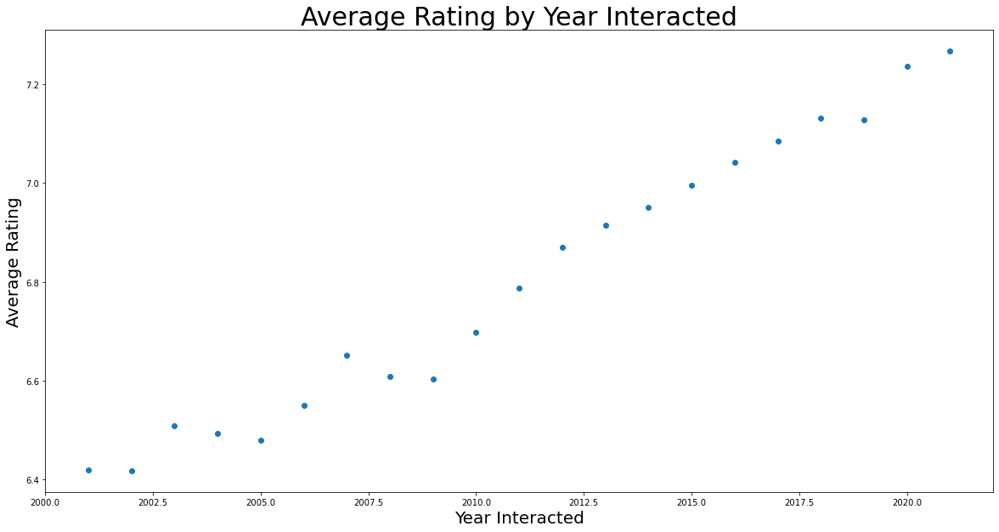

In [219]:
fig, ax = plt.subplots(figsize=(20, 10))

plt.scatter(
    user_ratings_cleaned.groupby("Year_interacted").mean().index,
    user_ratings_cleaned.groupby("Year_interacted")["Rating"].mean(),
)

plt.title("Average Rating by Year Interacted", fontsize=30)
plt.xlabel("Year Interacted", fontsize=20)
plt.ylabel("Average Rating", fontsize=20)
plt.savefig("user_avg_by_year.png");

In [190]:
# now we will try normalizing,

# make a dictionary of the user's average rating
user_averages = pd.DataFrame(
    user_ratings_cleaned.groupby("Username")["Rating"].mean()
).to_dict(orient="index")


# function to normalize the rating per row
def normalize_user(x, user_averages):
    username = x["Username"]
    normalized = x["Rating"] - user_averages[username]["Rating"]
    return normalized

In [191]:
# normalize each rating
user_ratings_cleaned["Normalized"] = user_ratings_cleaned.apply(
    lambda x: normalize_user(x, user_averages), axis=1
)

In [192]:
user_ratings_cleaned

,Username,BGGId,Rating,Date_rated,Normalized
0,-Johnny-,7865,3.0,2010-11-28,-2.318786
1,-Johnny-,30363,3.0,2010-03-06,-2.318786
2,-Johnny-,22278,5.0,2009-12-20,-0.318786
3,-Johnny-,94246,8.0,2012-05-28,2.681214
4,-Johnny-,421,4.0,2009-04-30,-1.318786
...,...,...,...,...,...
336,MattyTh,13681,5.0,2013-12-05,-1.620968
337,MattyTh,2393,7.0,2016-04-16,0.379032
338,MattyTh,145277,6.0,2015-04-30,-0.620968
339,MattyTh,528,8.0,2016-01-26,1.379032


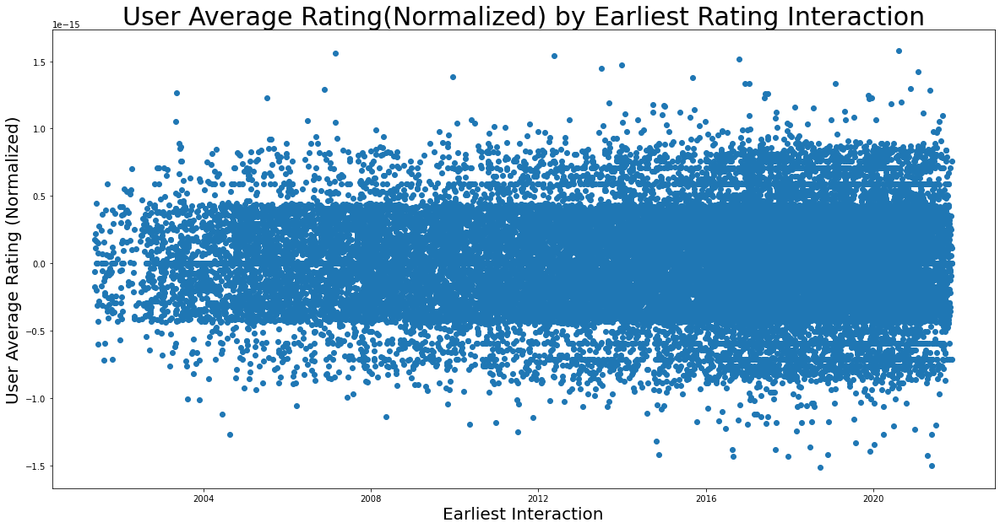

In [193]:
# plot the normalized ratings

user_ratings_earliest_norm = pd.DataFrame()
user_ratings_earliest_norm["Earliest_date_rated"] = user_ratings_cleaned.groupby(
    "Username"
)["Date_rated"].min()
user_ratings_earliest_norm["Normed_Rating"] = user_ratings_cleaned.groupby("Username")[
    "Normalized"
].mean()

fig, ax = plt.subplots(figsize=(20, 10))

plt.scatter(
    user_ratings_earliest_norm["Earliest_date_rated"],
    user_ratings_earliest_norm["Normed_Rating"],
)

plt.title("User Average Rating(Normalized) by Earliest Rating Interaction", fontsize=30)
plt.xlabel("Earliest Interaction", fontsize=20)
plt.ylabel("User Average Rating (Normalized)", fontsize=20)
plt.savefig("user_avg_by_earliest_normed.png");

User add per year - check user increases

check ratings by year published for the commenting cohort - controlling by their average rating

#### Distribution of Specific Users

In [194]:
users_totalrating_earliest = pd.DataFrame()
users_totalrating_earliest["Username"] = list(
    user_ratings_cleaned.groupby("Username")["Rating"].sum().index
)
users_totalrating_earliest["Earliest_year"] = list(
    user_ratings_cleaned.groupby("Username")["Date_rated"].min().dt.year
)
users_totalrating_earliest["Num_ratings"] = list(
    user_ratings_cleaned.groupby("Username")["Rating"].sum()
)
users_totalrating_earliest

,Username,Earliest_year,Num_ratings
0,-Johnny-,2004,2803.00
1,-LucaS-,2003,177.50
2,-Morphling-,2020,402.00
3,-mIDE-,2007,4413.50
4,-snarf-,2004,109.00
...,...,...,...
33724,Myhowdy,2013,3388.35
33725,Mykeul,2001,1323.00
33726,Mynyster,2018,59.00
33727,Myok,2009,1626.00


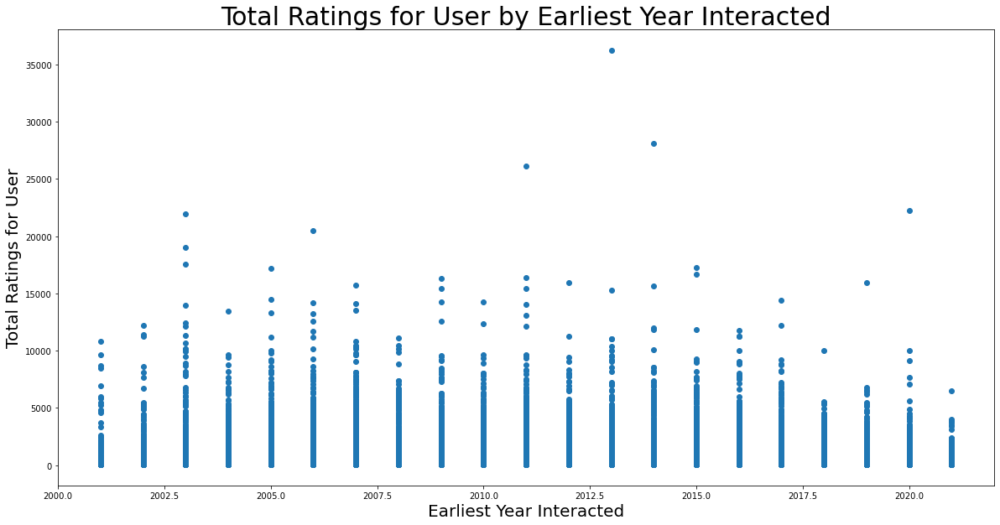

In [221]:
fig, ax = plt.subplots(figsize=(20, 10))

plt.scatter(
    users_totalrating_earliest["Earliest_year"],
    users_totalrating_earliest["Num_ratings"],
)

plt.title("Total Ratings for User by Earliest Year Interacted", fontsize=30)
plt.xlabel("Earliest Year Interacted", fontsize=20)
plt.ylabel("Total Ratings for User", fontsize=20)
plt.savefig("user_sum_by_earliest.png");

##### Rules Clarity
% of rules posts to total posts - lower % for high weight games have good rules clarity ?

##### Mechanic Bigrams and Trigrams in top 100

##### Designers with declining ratings per time

##### Designers with improving ratings for time

##### Most confusing rules

##### Ratings polarization on kickstarters

##### Top 100 euros vs more thematic

##### what publisher with more than three games published has the highest average rating across all their games

##### Are popular designers the best designers?

##### Top 100 Euros vs Thematic

##### What designer with more than three games pulished has the highest average rating across all their games?

##### Are the most popular designers (games in the top x00) the best designers (best overall average ratings)?

##### Sentiment analysis on reviews - what score is actually a very poor, poor, neutral, good, very good review?

##### How far does the mfg play time deviate from the community play time, depending on game weight?

##### Party games study

##### How does mfg rec age relate to actual rec age

##### Regress game weight against ranking

##### Regress game designers against ranking

##### Ratings of games within their family

##### Take a game, throw out a similar game (find x mechanics that match?)

#### Ratings Distributions

In [ ]:
games_100["AvgRating"].hist(bins=20)
games_100["BayesAvgRating"].hist(bins=20, color="lightblue", alpha=0.5)
this_avg = round(games_100["AvgRating"].mean(), 3)
bayes_avg = round(games_100["BayesAvgRating"].mean(), 3)

print("Unweighted Average: ", this_avg, "\nWeighted Average: ", bayes_avg)

In [ ]:
games_500["AvgRating"].hist(bins=20)
games_500["BayesAvgRating"].hist(bins=20, color="lightblue", alpha=0.5)
this_avg = round(games_500["AvgRating"].mean(), 3)
bayes_avg = round(games_500["BayesAvgRating"].mean(), 3)

print("Unweighted Average: ", this_avg, "\nWeighted Average: ", bayes_avg)

In [ ]:
games_1000["AvgRating"].hist(bins=20)
games_1000["BayesAvgRating"].hist(bins=20, color="lightblue", alpha=0.5)
this_avg = round(games_1000["AvgRating"].mean(), 3)
bayes_avg = round(games_1000["BayesAvgRating"].mean(), 3)

print("Unweighted Average: ", this_avg, "\nWeighted Average: ", bayes_avg)

In [ ]:
games_tenpercent["AvgRating"].hist(bins=20)
games_tenpercent["BayesAvgRating"].hist(bins=20, color="lightblue", alpha=0.5)
this_avg = round(games_tenpercent["AvgRating"].mean(), 3)
bayes_avg = round(games_tenpercent["BayesAvgRating"].mean(), 3)

print("Unweighted Average: ", this_avg, "\nWeighted Average: ", bayes_avg)

In [ ]:
games_5000["AvgRating"].hist(bins=20)
games_5000["BayesAvgRating"].hist(bins=20, color="lightblue", alpha=0.5)
this_avg = round(games_5000["AvgRating"].mean(), 3)
bayes_avg = round(games_5000["BayesAvgRating"].mean(), 3)

print("Unweighted Average: ", this_avg, "\nWeighted Average: ", bayes_avg)

In [ ]:
games["AvgRating"].hist(bins=20)
games["BayesAvgRating"].hist(bins=20, color="lightblue", alpha=0.5)

this_avg = round(games["AvgRating"].mean(), 3)
bayes_avg = round(games["BayesAvgRating"].mean(), 3)

print("Unweighted Average: ", this_avg, "\nWeighted Average: ", bayes_avg)

#### Most voted for games

In [ ]:
# Show Name, YearPublished, NumUserRatings, AvgRating, Rank for top 20 games sorted by NumUserRatings

games.sort_values("NumUserRatings", ascending=False).head(20)[
    ["Name", "YearPublished", "NumUserRatings", "AvgRating", "Rank:boardgame"]
].set_index("Name", drop=True)

#### Gaming's "Best Year"

Year sorted by average rating for games published after 1970.

The kickstarter recency bias is wildly apparent. The best years haven't even happened.

In [53]:
# Sort on best year for modern games after 1970 by raw rating

games.loc[(games["YearPublished"] > 1970)].groupby("YearPublished")[
    "AvgRating"
].mean().sort_values(ascending=False).head(10)

YearPublished
2021    7.485241
2020    7.279922
2019    6.998924
2018    6.849441
2017    6.735411
2016    6.623879
2015    6.529106
2014    6.442354
2013    6.405654
2012    6.381981
Name: AvgRating, dtype: float64

Year sorted by average rating for Top 1000 games published after 1970.

When we filter to only the top 1000, we can get rid of a lot of the recency bias and get a better look at the "Good years". But, we'll refine this further shortly.

In [54]:
# Sort on top 1000 modern games published after 1970 on raw rating

games.loc[(games["YearPublished"] > 1970)][:1000].groupby("YearPublished")[
    "AvgRating"
].mean().sort_values(ascending=False).head(10)

YearPublished
2020    7.999228
1985    7.996710
2021    7.994401
2019    7.771984
1983    7.662160
2018    7.647929
1979    7.614900
1990    7.535390
2016    7.535082
1993    7.531470
Name: AvgRating, dtype: float64

If we sort on the biased weights for modern games, we get a stronger picture. But MORE and MORE games are being produced each year, meaning the market is getting an influx of both good AND bad games each year. This still doesn't quite tell us which modern years are producing the best games.

In [55]:
games.loc[(games["YearPublished"] > 1970)].groupby("YearPublished")[
    "BayesAvgRating"
].mean().sort_values(ascending=False).head(10)

YearPublished
2019    5.761751
2017    5.755493
2018    5.749144
2015    5.747806
2020    5.745382
2016    5.736808
2012    5.730228
2014    5.727404
2011    5.720582
2013    5.713160
Name: BayesAvgRating, dtype: float64

With that, we sort modern gaming using only the top 1000. Here we get a strong picture of modern gaming's best years.

In [56]:
games.loc[(games["YearPublished"] > 1970)][:1000].groupby("YearPublished")[
    "BayesAvgRating"
].mean().sort_values(ascending=False).head(10)

YearPublished
1993    7.363950
1982    7.314405
2002    7.076564
2006    7.073386
1979    7.072590
1985    7.071360
2016    7.062212
2020    7.033612
2015    7.030163
1997    7.029492
Name: BayesAvgRating, dtype: float64

Modern gaming in the top 10%

In [57]:
games.loc[(games["YearPublished"] > 1970)][:tenpercent].groupby("YearPublished")[
    "BayesAvgRating"
].mean().sort_values(ascending=False).head(10)

YearPublished
1999    6.708734
2012    6.699042
2015    6.688950
2016    6.675895
1982    6.666340
2007    6.665501
2014    6.665394
2000    6.658303
2011    6.658020
2004    6.632408
Name: BayesAvgRating, dtype: float64

#### Gaming's Best Year - No KS

Did KS pull ratings up or down?

In [58]:
# get games in top 1000 that were not kickstarted
not_kickstarted = games[:1000].loc[games["Kickstarted"] == 0]

# modern games >1970 group by weighted rating
not_kickstarted.loc[(not_kickstarted["YearPublished"] > 1970)][:1000].groupby(
    "YearPublished"
)["BayesAvgRating"].mean().sort_values(ascending=False).head(10)

YearPublished
1993    7.363950
1982    7.314405
2020    7.076879
2002    7.076564
2016    7.075255
2006    7.073386
1979    7.072590
1985    7.071360
2019    7.037579
1997    7.029492
Name: BayesAvgRating, dtype: float64

#### Number of Releases per year

In [59]:
# make frames for number of games published yearly for all, top 5k, top 1k, top 500, top 100

published_all = (
    pd.DataFrame(
        games.groupby("YearPublished")
        .count()
        .sort_values("YearPublished", ascending=False)[2:]["BGGId"]
    )
    .rename(columns={"BGGId": "total_pubs"})
    .reset_index()
)
published_tenpercent = (
    pd.DataFrame(
        games_tenpercent.groupby("YearPublished")
        .count()
        .sort_values("YearPublished", ascending=False)[1:]["BGGId"]
    )
    .rename(columns={"BGGId": "top10%_pubs"})
    .reset_index()
)
published5000 = (
    pd.DataFrame(
        games_5000.groupby("YearPublished")
        .count()
        .sort_values("YearPublished", ascending=False)[1:]["BGGId"]
    )
    .rename(columns={"BGGId": "top5k_pubs"})
    .reset_index()
)
published1000 = (
    pd.DataFrame(
        games_1000.groupby("YearPublished")
        .count()
        .sort_values("YearPublished", ascending=False)["BGGId"]
    )
    .rename(columns={"BGGId": "top1000_pubs"})
    .reset_index()
)
published500 = (
    pd.DataFrame(
        games_500.groupby("YearPublished")
        .count()
        .sort_values("YearPublished", ascending=False)["BGGId"]
    )
    .rename(columns={"BGGId": "top500_pubs"})
    .reset_index()
)
published100 = (
    pd.DataFrame(
        games_100.groupby("YearPublished")
        .count()
        .sort_values("YearPublished", ascending=False)["BGGId"]
    )
    .rename(columns={"BGGId": "top100_pubs"})
    .reset_index()
)

In [60]:
published_all

,YearPublished,total_pubs
0,2019,1235
1,2018,1316
2,2017,1323
3,2016,1286
4,2015,1145
...,...,...
180,-1400,2
181,-2200,1
182,-2600,1
183,-3000,3


In [61]:
published_all.drop(
    published_all.loc[published_all["total_pubs"] < 20].index, axis=0, inplace=True
)

In [62]:
# merge all into one frame on yearpublished

pubs_all = published_all.merge(published_tenpercent, how="left", on="YearPublished")
pubs_all = pubs_all.merge(published5000, how="left", on="YearPublished")
pubs_all = pubs_all.merge(published1000, how="left", on="YearPublished")
pubs_all = pubs_all.merge(published500, how="left", on="YearPublished")
pubs_all = pubs_all.merge(published100, how="left", on="YearPublished")
pubs_all.fillna(0, inplace=True)
pubs_all

,YearPublished,total_pubs,top10%_pubs,top5k_pubs,top1000_pubs,top500_pubs,top100_pubs
0,2019,1235,174.0,411,78.0,39.0,11.0
1,2018,1316,168.0,412,86.0,44.0,9.0
2,2017,1323,192.0,405,92.0,44.0,11.0
3,2016,1286,164.0,359,84.0,46.0,12.0
4,2015,1145,154.0,323,81.0,41.0,13.0
5,2014,1003,132.0,256,73.0,34.0,6.0
6,2013,862,106.0,231,47.0,24.0,4.0
7,2012,827,103.0,232,58.0,29.0,7.0
8,2011,738,94.0,194,52.0,28.0,4.0
9,2010,696,89.0,176,36.0,17.0,3.0


In [63]:
# add percentage of releases per year in top 5k/1k/500/100
pubs_all["pct/Top10%"] = round(
    (pubs_all["top10%_pubs"] / pubs_all["total_pubs"]) * 100, 2
)
pubs_all["pct/Top5k"] = round(
    (pubs_all["top5k_pubs"] / pubs_all["total_pubs"]) * 100, 2
)
pubs_all["pct/Top1000"] = round(
    (pubs_all["top1000_pubs"] / pubs_all["total_pubs"]) * 100, 2
)
pubs_all["pct/Top500"] = round(
    (pubs_all["top500_pubs"] / pubs_all["total_pubs"]) * 100, 2
)
pubs_all["pct/Top100"] = round(
    (pubs_all["top100_pubs"] / pubs_all["total_pubs"]) * 100, 2
)

In [64]:
# set index as year published
pubs_all.set_index("YearPublished", inplace=True)
pubs_all

,total_pubs,top10%_pubs,top5k_pubs,top1000_pubs,top500_pubs,top100_pubs,pct/Top10%,pct/Top5k,pct/Top1000,pct/Top500,pct/Top100
YearPublished,,,,,,,,,,,
2019,1235,174.0,411,78.0,39.0,11.0,14.09,33.28,6.32,3.16,0.89
2018,1316,168.0,412,86.0,44.0,9.0,12.77,31.31,6.53,3.34,0.68
2017,1323,192.0,405,92.0,44.0,11.0,14.51,30.61,6.95,3.33,0.83
2016,1286,164.0,359,84.0,46.0,12.0,12.75,27.92,6.53,3.58,0.93
2015,1145,154.0,323,81.0,41.0,13.0,13.45,28.21,7.07,3.58,1.14
2014,1003,132.0,256,73.0,34.0,6.0,13.16,25.52,7.28,3.39,0.60
2013,862,106.0,231,47.0,24.0,4.0,12.30,26.80,5.45,2.78,0.46
2012,827,103.0,232,58.0,29.0,7.0,12.45,28.05,7.01,3.51,0.85
2011,738,94.0,194,52.0,28.0,4.0,12.74,26.29,7.05,3.79,0.54


In [65]:
most_500_releases = (
    pubs_all.loc[pubs_all["total_pubs"] > 10]
    .sort_values("pct/Top500", ascending=False)
    .head(20)
)
most_500_releases["pct/Top500"]

YearPublished
2011    3.79
2016    3.58
2015    3.58
2012    3.51
2014    3.39
2018    3.34
2017    3.33
2019    3.16
2009    3.13
2007    3.03
2013    2.78
1999    2.58
2010    2.44
2004    2.41
2005    2.39
2006    2.13
2000    2.01
2008    1.70
1982    1.61
1995    1.40
Name: pct/Top500, dtype: float64

In [66]:
most_1k_releases = (
    pubs_all.loc[pubs_all["total_pubs"] > 10]
    .sort_values("pct/Top1000", ascending=False)
    .head(20)
)
most_1k_releases["pct/Top1000"]

YearPublished
2014    7.28
2015    7.07
2011    7.05
2012    7.01
2017    6.95
2018    6.53
2016    6.53
2019    6.32
2009    5.96
1999    5.54
2007    5.49
2013    5.45
2010    5.17
2004    4.83
2005    4.60
2000    4.01
2008    3.58
1995    3.27
2006    3.09
2003    2.70
Name: pct/Top1000, dtype: float64

In [67]:
most_10p_releases = (
    pubs_all.loc[pubs_all["total_pubs"] > 10]
    .sort_values("pct/Top10%", ascending=False)
    .head(20)
)
most_10p_releases["pct/Top10%"]

YearPublished
2017    14.51
2019    14.09
2015    13.45
2014    13.16
2010    12.79
2018    12.77
2016    12.75
2011    12.74
2012    12.45
2013    12.30
2009    11.76
2008    10.73
2005    10.48
2004    10.06
2007     9.66
1999     8.12
1995     7.94
2000     7.02
1977     7.00
2006     6.96
Name: pct/Top10%, dtype: float64

''

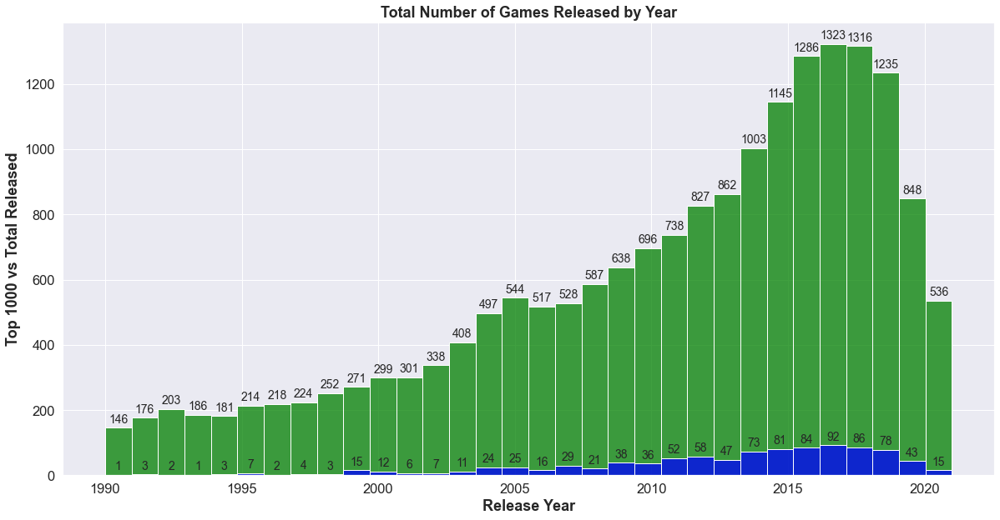

In [68]:
lower = 1990
upper = 2021 + 1

sns.set(font_scale=1.5)

# prepare the figure
fig, ax = plt.subplots(figsize=(20, 10))

data1000 = games_1000.loc[games_1000["YearPublished"] > 1989]
data_all = games.loc[(games["YearPublished"] > 1989) & (games["YearPublished"] < 2022)]

# set up two data sets on our histogram
histo = sns.histplot(data=data_all, x="YearPublished", color="green", ax=ax, bins=32)
histo = sns.histplot(data=data1000, x="YearPublished", bins=32, color="blue", ax=ax)

# label our histogram values
rects = histo.patches


def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate(
            "{}".format(height),
            xy=(rect.get_x() + rect.get_width() / 2, height),
            xytext=(0, 3),  # 3 points vertical offset
            textcoords="offset points",
            ha="center",
            va="bottom",
            size=14,
        )


autolabel(rects)

# ax.margins(x=0)

# label our figure
histo.set_ylabel("Top 1000 vs Total Released", weight="bold")
histo.set_title("Total Number of Games Released by Year", weight="bold")
histo.set_xlabel("Release Year", weight="bold");

''

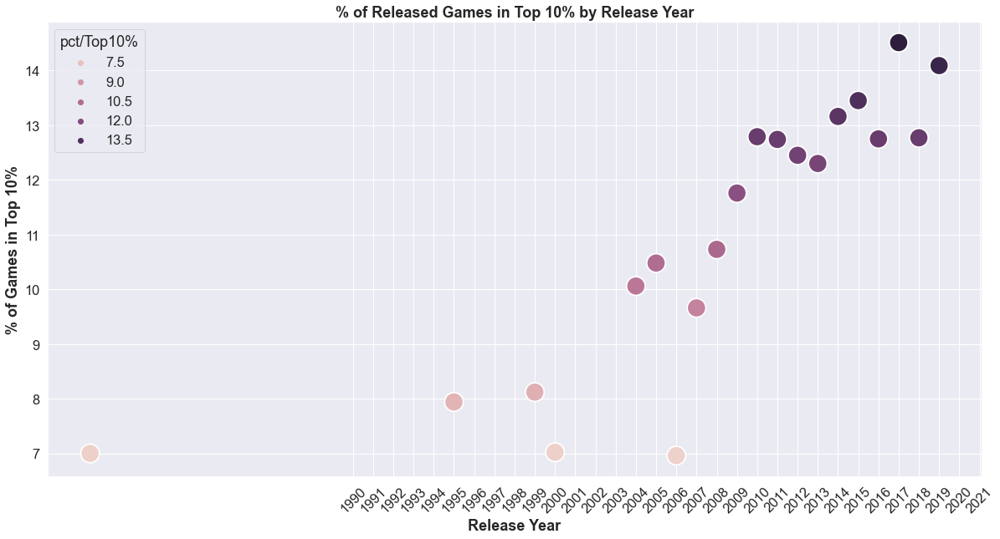

In [69]:
sns.set(font_scale=1.5)

# prepare the figure
fig, ax = plt.subplots(figsize=(20, 10))


# set up two data sets on our histogram
histo = sns.scatterplot(
    data=most_10p_releases,
    x=most_10p_releases.index,
    y="pct/Top10%",
    hue="pct/Top10%",
    s=500,
    ax=ax,
)
# histo = sns.histplot(data=data1000, x='YearPublished', bins=32, color='blue', ax=ax)

# label our  values


plt.xticks(np.arange(lower, upper, step=1), rotation=45)

# label our figure
histo.set_ylabel("% of Games in Top 10%", weight="bold")
histo.set_xlabel("Release Year", weight="bold")
histo.set_title("% of Released Games in Top 10% by Release Year", weight="bold");

## Rank Correlations

In [70]:
games.columns

Index(['BGGId', 'Name', 'Description', 'YearPublished', 'GameWeight',
       'AvgRating', 'BayesAvgRating', 'StdDev', 'MinPlayers', 'MaxPlayers',
       'ComAgeRec', 'LanguageEase', 'BestPlayers', 'GoodPlayers', 'NumOwned',
       'NumWant', 'NumWish', 'NumWeightVotes', 'MfgPlaytime', 'ComMinPlaytime',
       'ComMaxPlaytime', 'MfgAgeRec', 'NumUserRatings', 'NumComments',
       'NumAlternates', 'NumExpansions', 'NumAwards', 'NumImplementations',
       'NumFans', 'NumPageViews', 'RulesPosts', 'TotalPosts', 'IsExpansion',
       'IsReimplementation', 'Family', 'Kickstarted', 'ImagePath',
       'Rank:boardgame', 'Rank:thematic', 'Rank:strategygames',
       'Rank:wargames', 'Rank:familygames', 'Rank:cgs', 'Rank:abstracts',
       'Rank:partygames', 'Rank:childrensgames', 'Cat:Thematic',
       'Cat:Strategy', 'Cat:War', 'Cat:Family', 'Cat:CGS', 'Cat:Abstract',
       'Cat:Party', 'Cat:Childrens', 'Playtime'],
      dtype='object')

In [71]:
ranks_chart = games[
    [
        "GameWeight",
        "Rank:boardgame",
        "Rank:thematic",
        "Rank:strategygames",
        "Rank:wargames",
        "Rank:familygames",
        "Rank:cgs",
        "Rank:abstracts",
        "Rank:partygames",
        "Rank:childrensgames",
    ]
]

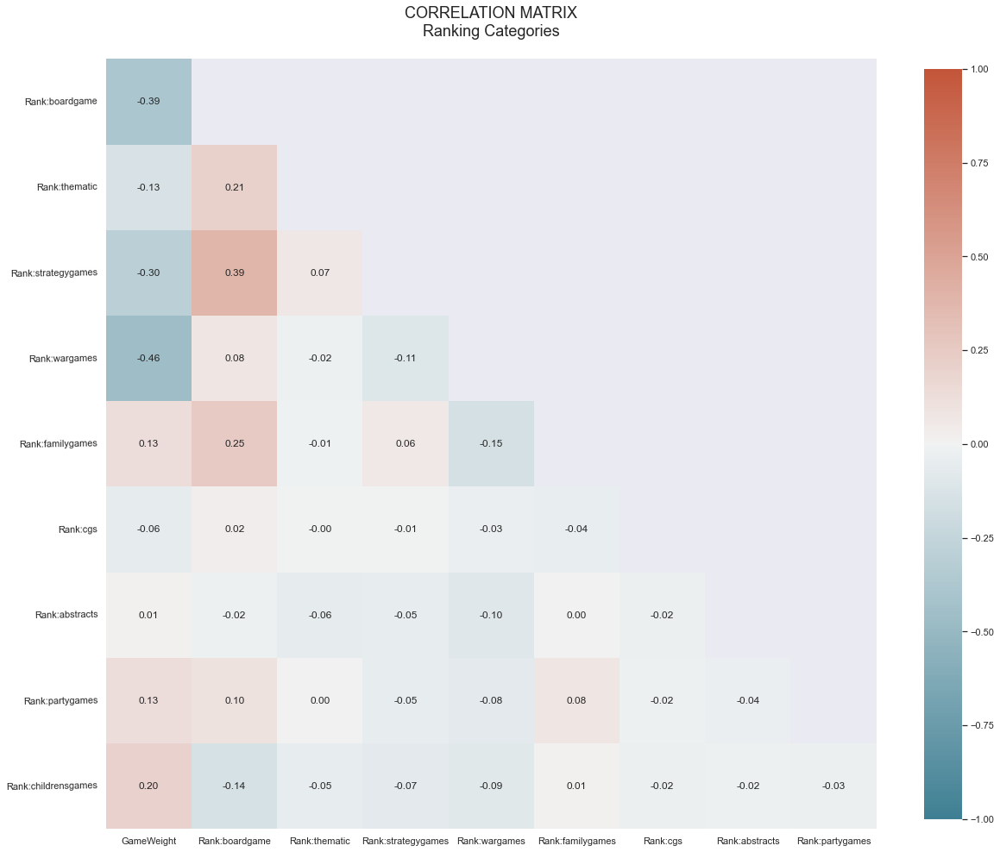

In [72]:
sns.set(font_scale=1)
games_c = ranks_chart.corr()
# plot a heat map for all correlations in our data set

# make our figure
fig, ax = plt.subplots(figsize=(20, 20))

# we want our heatmap to not show the upper triangle, which is redundant data
games_c_mask = np.triu(np.ones_like(games_c, dtype=bool))

# adjust mask and df to hide center diagonal
games_c_mask = games_c_mask[1:, :-1]
corr = games_c.iloc[1:, :-1].copy()

# color map
cmap = sns.diverging_palette(220, 20, as_cmap=True)

# plot heatmap
sns.heatmap(
    corr,
    mask=games_c_mask,
    annot=True,
    fmt=".2f",
    cmap=cmap,
    vmin=-1,
    vmax=1,
    cbar_kws={"shrink": 0.8},
    square=True,
)

# yticks rotate
plt.yticks(rotation=1)

# title
title = "CORRELATION MATRIX\nRanking Categories\n"
plt.title(title, fontsize=18)

# plt.savefig('images/heatmap.png')

plt.show()

In [73]:
# Get our list of highly correlated feature pairs with following steps:

# save correlation matrix as a new data frame
# converts all values to absolute value
# stacks the row:column pairs into a multindex
# reset the index to set the multindex to seperate columns
# sort values. 0 is the column automatically generated by the stacking
df_correlations = (
    ranks_chart.corr().abs().stack().reset_index().sort_values(0, ascending=False)
)

# zip the variable name columns in a new column named "pairs"
df_correlations["pairs"] = list(zip(df_correlations.level_0, df_correlations.level_1))

# set index to pairs
df_correlations.set_index(["pairs"], inplace=True)

# rename our results column to correlation
df_correlations.rename(columns={0: "correlation"}, inplace=True)

# Drop 1:1 correlations to get rid of self pairs
df_correlations.drop(
    df_correlations[df_correlations["correlation"] == 1.000000].index, inplace=True
)

# view pairs above 75% correlation and below 90% correlation (engineered features will correlate with each other above 95%)
df_correlations[
    (df_correlations.correlation > 0.75) & (df_correlations.correlation < 0.99)
].head(20)

,level_0,level_1,correlation
pairs,,,


In [74]:
df_correlations.head(20)

,level_0,level_1,correlation
pairs,,,
"(Rank:wargames, GameWeight)",Rank:wargames,GameWeight,0.462833
"(GameWeight, Rank:wargames)",GameWeight,Rank:wargames,0.462833
"(Rank:strategygames, Rank:boardgame)",Rank:strategygames,Rank:boardgame,0.389657
"(Rank:boardgame, Rank:strategygames)",Rank:boardgame,Rank:strategygames,0.389657
"(GameWeight, Rank:boardgame)",GameWeight,Rank:boardgame,0.386512
"(Rank:boardgame, GameWeight)",Rank:boardgame,GameWeight,0.386512
"(GameWeight, Rank:strategygames)",GameWeight,Rank:strategygames,0.299402
"(Rank:strategygames, GameWeight)",Rank:strategygames,GameWeight,0.299402
"(Rank:boardgame, Rank:familygames)",Rank:boardgame,Rank:familygames,0.254865


## All Correlations

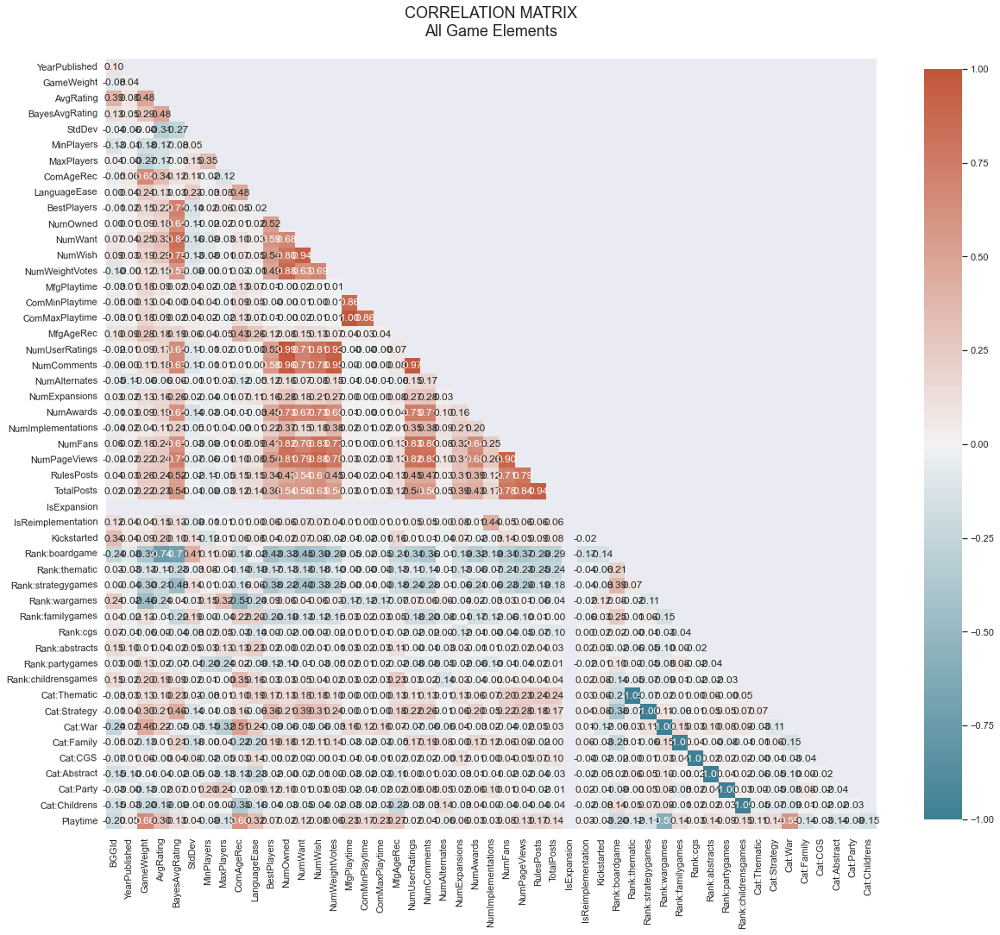

In [75]:
sns.set(font_scale=1)
games_c = games.corr()
# plot a heat map for all correlations in our data set

# make our figure
fig, ax = plt.subplots(figsize=(20, 20))

# we want our heatmap to not show the upper triangle, which is redundant data
games_c_mask = np.triu(np.ones_like(games_c, dtype=bool))

# adjust mask and df to hide center diagonal
games_c_mask = games_c_mask[1:, :-1]
corr = games_c.iloc[1:, :-1].copy()

# color map
cmap = sns.diverging_palette(220, 20, as_cmap=True)

# plot heatmap
sns.heatmap(
    corr,
    mask=games_c_mask,
    annot=True,
    fmt=".2f",
    cmap=cmap,
    vmin=-1,
    vmax=1,
    cbar_kws={"shrink": 0.8},
    square=True,
)

# yticks rotate
plt.yticks(rotation=1)

# title
title = "CORRELATION MATRIX\nAll Game Elements\n"
plt.title(title, fontsize=18)

# plt.savefig('images/heatmap.png')

plt.show()

In [76]:
# Get our list of highly correlated feature pairs with following steps:

# save correlation matrix as a new data frame
# converts all values to absolute value
# stacks the row:column pairs into a multindex
# reset the index to set the multindex to seperate columns
# sort values. 0 is the column automatically generated by the stacking
df_correlations = (
    games.corr().abs().stack().reset_index().sort_values(0, ascending=False)
)

# zip the variable name columns in a new column named "pairs"
df_correlations["pairs"] = list(zip(df_correlations.level_0, df_correlations.level_1))

# set index to pairs
df_correlations.set_index(["pairs"], inplace=True)

# rename our results column to correlation
df_correlations.rename(columns={0: "correlation"}, inplace=True)

# Drop 1:1 correlations to get rid of self pairs
df_correlations.drop(
    df_correlations[df_correlations["correlation"] == 1.000000].index, inplace=True
)

# view pairs above 75% correlation and below 90% correlation (engineered features will correlate with each other above 95%)
df_correlations[
    (df_correlations.correlation > 0.75) & (df_correlations.correlation < 1)
].head(20)

,level_0,level_1,correlation
pairs,,,
"(Rank:cgs, Cat:CGS)",Rank:cgs,Cat:CGS,0.999991
"(Cat:CGS, Rank:cgs)",Cat:CGS,Rank:cgs,0.999991
"(Cat:Party, Rank:partygames)",Cat:Party,Rank:partygames,0.999961
"(Rank:partygames, Cat:Party)",Rank:partygames,Cat:Party,0.999961
"(Cat:Childrens, Rank:childrensgames)",Cat:Childrens,Rank:childrensgames,0.999925
"(Rank:childrensgames, Cat:Childrens)",Rank:childrensgames,Cat:Childrens,0.999925
"(Cat:Abstract, Rank:abstracts)",Cat:Abstract,Rank:abstracts,0.999876
"(Rank:abstracts, Cat:Abstract)",Rank:abstracts,Cat:Abstract,0.999876
"(Rank:thematic, Cat:Thematic)",Rank:thematic,Cat:Thematic,0.999849


In [77]:
games.drop(["NumOwned", "NumComments", "NumWish"], axis=1, inplace=True)

In [78]:
# Check out our variables correlationg with rank
df_correlations = (
    games.corr().abs().stack().reset_index().sort_values(0, ascending=False)
)
df_correlations.loc[df_correlations["level_0"] == "Rank:boardgame"].sort_values(
    0, ascending=False
).head(20)

,level_0,level_1,0
1316,Rank:boardgame,Rank:boardgame,1.000000
1291,Rank:boardgame,AvgRating,0.744336
1292,Rank:boardgame,BayesAvgRating,0.704512
1299,Rank:boardgame,NumWant,0.454754
1298,Rank:boardgame,BestPlayers,0.433864
1293,Rank:boardgame,StdDev,0.413875
1318,Rank:boardgame,Rank:strategygames,0.389657
1290,Rank:boardgame,GameWeight,0.386512
1326,Rank:boardgame,Cat:Strategy,0.383431
1311,Rank:boardgame,NumPageViews,0.369738


## Mechanics

In [79]:
mechs_100

,BGGId,Name,Rank:boardgame,AvgRating,BayesAvgRating,Action Queue,Action Retrieval,Campaign / Battle Card Driven,Card Play Conflict Resolution,Communication Limits,Cooperative Game,Critical Hits and Failures,Deck Construction,"Deck, Bag, and Pool Building",Grid Movement,Hand Management,Hexagon Grid,Legacy Game,Modular Board,Once-Per-Game Abilities,Scenario / Mission / Campaign Game,Simultaneous Action Selection,Solo / Solitaire Game,Storytelling,Variable Player Powers,Action Points,Point to Point Movement,Set Collection,Trading,Income,Loans,Market,Network and Route Building,Score-and-Reset Game,Tech Trees / Tech Tracks,Variable Set-up,Drafting,End Game Bonuses,TableauBuilding,Take That,Tile Placement,Line of Sight,Action Drafting,Area Majority / Influence,Area-Impulse,Dice Rolling,Follow,King of the Hill,Variable Phase Order,Voting,Victory Points as a Resource,Area Movement,Delayed Purchase,Team-Based Game,Auction/Bidding,Events,Hidden Movement,Movement Points,Simulation,Ownership,Rondel,Track Movement,Action/Event,Advantage Token,Sudden Death Ending,Tug of War,Force Commitment,Narrative Choice / Paragraph,Grid Coverage,Layering,Increase Value of Unchosen Resources,Hidden Roles,Player Elimination,Semi-Cooperative Game,Traitor Game,Automatic Resource Growth,Push Your Luck,Worker Placement,Role Playing,Stat Check Resolution,Contracts,Race,Hidden Victory Points,Memory,Enclosure,Stock Holding,Pick-up and Deliver,Map Addition,Die Icon Resolution,Resource to Move,Trick-taking,Move Through Deck,Bias,Catch the Leader,Programmed Movement,Slide/Push,Commodity Speculation,Square Grid,Moving Multiple Units,Alliances,Kill Steal,Passed Action Token,Pattern Building,Investment,Secret Unit Deployment,Highest-Lowest Scoring,Mancala,Lose a Turn,Betting and Bluffing,Negotiation,Time Track,Connections,Targeted Clues,Order Counters,Bingo,Line Drawing,Paper-and-Pencil,Deduction,Movement Template,Multiple Maps,Re-rolling and Locking,Roll / Spin and Move,Finale Ending,Roles with Asymmetric Information,Command Cards,"I Cut, You Choose",Prisoner's Dilemma,Interrupts,Real-Time,Ladder Climbing,Predictive Bid,Three Dimensional Movement,Zone of Control,Random Production,Relative Movement,Cube Tower,Bribery,Map Deformation,Elapsed Real Time Ending,Melding and Splaying,Pieces as Map,Pattern Movement,Static Capture,Pattern Recognition,Minimap Resolution,Map Reduction,Ratio / Combat Results Table,Single Loser Game,Chaining,Different Dice Movement,Measurement Movement,Action Timer,Physical Removal,Induction,Speed Matching,Player Judge,Crayon Rail System,Chit-Pull System,Matching,Impulse Movement,Dexterity,Physical
0,174430,Gloomhaven,1,8.76029,8.52385,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,161936,Pandemic Legacy: Season 1,2,8.60116,8.45000,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,224517,Brass: Birmingham,3,8.66907,8.41066,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,167791,Terraforming Mars,4,8.42155,8.27751,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,1,0,1,0,0,0,0,0,0,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [80]:
# show % of each mechanic in top 100

mechs_100.drop(
    ["BGGId", "Name", "Rank:boardgame", "AvgRating", "BayesAvgRating"], axis=1
).sum().T.sort_values(0, ascending=False).head(15)

Variable Player Powers       49
Hand Management              46
Solo / Solitaire Game        44
Drafting                     33
Worker Placement             31
Dice Rolling                 31
TableauBuilding              27
Set Collection               27
Variable Set-up              24
End Game Bonuses             23
Cooperative Game             20
Income                       20
Modular Board                19
Area Majority / Influence    18
Tile Placement               17
dtype: int64

In [81]:
# show % of each mechanic in top 500

mechs_500.drop(
    ["BGGId", "Name", "Rank:boardgame", "AvgRating", "BayesAvgRating"], axis=1
).sum().T.sort_values(0, ascending=False).head(15) / 5

Hand Management                 41.0
Variable Player Powers          34.4
Dice Rolling                    31.6
Drafting                        31.2
Set Collection                  24.8
Solo / Solitaire Game           21.2
Area Majority / Influence       19.4
Worker Placement                17.0
Modular Board                   17.0
Cooperative Game                15.6
Tile Placement                  15.4
TableauBuilding                 14.2
Grid Movement                   13.2
Deck, Bag, and Pool Building    12.0
Area Movement                   11.4
dtype: float64

In [82]:
# show % of each mechanic in top 1000

mechs_1000.drop(
    ["BGGId", "Name", "Rank:boardgame", "AvgRating", "BayesAvgRating"], axis=1
).sum().T.sort_values(0, ascending=False).head(15) / 10

Hand Management                 38.9
Dice Rolling                    32.9
Variable Player Powers          32.7
Drafting                        25.8
Set Collection                  22.4
Area Majority / Influence       19.3
Modular Board                   17.3
Solo / Solitaire Game           17.0
Worker Placement                14.8
Tile Placement                  14.5
Cooperative Game                14.5
Grid Movement                   12.9
Action Points                   11.8
Area Movement                   10.4
Deck, Bag, and Pool Building    10.3
dtype: float64

In [83]:
# show % of each mechanic in top 5000

mechs_5000.drop(
    ["BGGId", "Name", "Rank:boardgame", "AvgRating", "BayesAvgRating"], axis=1
).sum().T.sort_values(0, ascending=False).head(15) / 50

Dice Rolling                 32.26
Hand Management              30.08
Variable Player Powers       22.30
Set Collection               18.26
Drafting                     16.12
Area Majority / Influence    13.96
Modular Board                12.60
Tile Placement               12.16
Cooperative Game             11.54
Grid Movement                10.30
Simulation                    9.70
Solo / Solitaire Game         9.44
Action Points                 8.96
Worker Placement              8.76
Hexagon Grid                  8.42
dtype: float64

In [84]:
# show % of each mechanic in top 10%

mechs_tenpercent.drop(
    ["BGGId", "Name", "Rank:boardgame", "AvgRating", "BayesAvgRating"], axis=1
).sum().T.sort_values(0, ascending=False).head(15) / 50

Hand Management              15.12
Dice Rolling                 13.18
Variable Player Powers       11.58
Set Collection                9.14
Drafting                      9.10
Area Majority / Influence     7.64
Modular Board                 6.36
Tile Placement                5.76
Cooperative Game              5.62
Solo / Solitaire Game         5.58
Worker Placement              5.32
Grid Movement                 4.50
Action Points                 4.38
Auction/Bidding               4.04
Area Movement                 3.92
dtype: float64

In [85]:
# ALL Mechanics
all_mechanics = (
    mechanics.drop(["BGGId"], axis=1).sum().T.sort_values(0, ascending=False).head(15)
    / 213.69
)
all_mechanics

Dice Rolling                 29.542796
Hand Management              20.248959
Set Collection               13.440030
Variable Player Powers       12.344986
Hexagon Grid                 11.095512
Simulation                    9.705648
Drafting                      8.984978
Tile Placement                8.325144
Modular Board                 7.754223
Grid Movement                 7.450044
Area Majority / Influence     7.323693
Betting and Bluffing          7.075670
Cooperative Game              7.052272
Roll / Spin and Move          6.303524
Area Movement                 5.493940
dtype: float64

## Rating by Mechanic

Study the average rating of games by mechanic

### All Games

In [86]:
# create a table that has a rating for each entry along with its mechanics

# make a lean games frame to attach to mechanics
games_ratings = games[["BGGId", "AvgRating"]].set_index("BGGId")
mechs_ratings = (
    games_ratings.join(mechanics.set_index("BGGId"), on="BGGId", how="left")
    .reset_index()
    .drop("BGGId", axis=1)
)

# establish the minimum number of games to have a mechanic at 1%
min_mechs = mechanics.shape[0] * 0.01
print(min_mechs)

# Make data frame of sum of all mechanics
mechanics_all = pd.DataFrame(mechanics.drop("BGGId", axis=1).sum())
# make data frame of all mechanics with sum over the minimum
mechanics_over1percent = mechanics_all.loc[mechanics_all[0] > min_mechs]
# make a list of the included mechanics
mechanics_list = list(mechanics_over1percent.index)

# show mechanics dataframe sorted
mechanics_over1percent.sort_values(0, ascending=False)

212.93


,0
Dice Rolling,6313
Hand Management,4327
Set Collection,2872
Variable Player Powers,2638
Hexagon Grid,2371
Simulation,2074
Drafting,1920
Tile Placement,1779
Modular Board,1657
Grid Movement,1592


In [87]:
# make a dictionary to store our next part
mechanics_rating = {}

# for each included mechanic,
for mech in mechanics_list:
    # get the average rating of all games that have that mechanic
    avg_rating = mechs_ratings.loc[mechs_ratings[mech] == 1]["AvgRating"].mean()
    # store the average rating in the dictionary
    mechanics_rating[mech] = round(avg_rating, 3)

# make a dataframe of the mechanics sorted by rating
mechanics_average = pd.DataFrame.from_dict(
    mechanics_rating, orient="index", columns=["Mechanic Rating"]
).sort_values("Mechanic Rating", ascending=False)

# top 10 mechanics
mechanics_average.head(10)

,Mechanic Rating
Solo / Solitaire Game,7.321
Line of Sight,7.273
Chit-Pull System,7.224
Variable Set-up,7.185
Scenario / Mission / Campaign Game,7.120
Campaign / Battle Card Driven,7.045
"Deck, Bag, and Pool Building",7.040
Worker Placement,7.011
Variable Phase Order,6.974
Action Points,6.946


In [88]:
# bottom 10 mechanics
mechanics_average.tail(10)

,Mechanic Rating
Voting,6.312
Player Elimination,6.305
Real-Time,6.270
Negotiation,6.222
Memory,6.150
Trading,6.120
Physical,6.080
Pattern Recognition,6.078
Dexterity,5.997
Roll / Spin and Move,5.467


### Top 10% of Games

In [89]:
# create a table that has a rating for each entry along with its mechanics

# make a lean games frame to attach to mechanics
games_ratings = games_tenpercent[["BGGId", "AvgRating"]].set_index("BGGId")
mechs_ratings = (
    games_ratings.join(mechanics.set_index("BGGId"), on="BGGId", how="left")
    .reset_index()
    .drop("BGGId", axis=1)
)

# establish the minimum number of games to have a mechanic at 1%
min_mechs = mechs_ratings.shape[0] * 0.01
print(min_mechs)

# Make data frame of sum of all mechanics
mechanics_all = pd.DataFrame(mechs_ratings.drop("AvgRating", axis=1).sum())

mechanics_all

21.29


,0
Action Queue,70
Action Retrieval,41
Campaign / Battle Card Driven,96
Card Play Conflict Resolution,35
Communication Limits,49
...,...
Chit-Pull System,4
Matching,1
Impulse Movement,0
Dexterity,50


In [90]:
# make data frame of all mechanics with sum over the minimum
mechanics_over1percent = mechanics_all.loc[mechanics_all[0] > min_mechs]
# make a list of the included mechanics
mechanics_list = list(mechanics_over1percent.index)

# show mechanics dataframe sorted
mechanics_over1percent.sort_values(0, ascending=False)

,0
Hand Management,756
Dice Rolling,659
Variable Player Powers,579
Set Collection,457
Drafting,455
...,...
Physical,25
Bias,24
Action Drafting,24
Follow,23


In [91]:
# make a dictionary to store our next part
mechanics_rating = {}

# for each included mechanic,
for mech in mechanics_list:
    # get the average rating of all games that have that mechanic
    avg_rating = mechs_ratings.loc[mechs_ratings[mech] == 1]["AvgRating"].mean()
    # store the average rating in the dictionary
    mechanics_rating[mech] = round(avg_rating, 3)

# make a dataframe of the mechanics sorted by rating
mechanics_average = pd.DataFrame.from_dict(
    mechanics_rating, orient="index", columns=["Mechanic Rating"]
).sort_values("Mechanic Rating", ascending=False)

# top 10 mechanics
mechanics_average.head(10)

,Mechanic Rating
Tech Trees / Tech Tracks,7.802
Line of Sight,7.771
Scenario / Mission / Campaign Game,7.761
Income,7.726
Ownership,7.718
Campaign / Battle Card Driven,7.707
Market,7.692
Movement Points,7.657
Card Play Conflict Resolution,7.657
Action Drafting,7.646


In [92]:
# bottom 10 mechanics
mechanics_average.tail(10)

,Mechanic Rating
Paper-and-Pencil,7.179
Physical,7.169
Voting,7.146
Enclosure,7.124
Trick-taking,7.101
Real-Time,7.075
Betting and Bluffing,7.069
Memory,7.031
Roll / Spin and Move,7.012
Dexterity,6.990


### Top 500 Games

In [93]:
# create a table that has a rating for each entry along with its mechanics

# make a lean games frame to attach to mechanics
games_ratings = games_500[["BGGId", "AvgRating"]].set_index("BGGId")
mechs_ratings = (
    games_ratings.join(mechanics.set_index("BGGId"), on="BGGId", how="left")
    .reset_index()
    .drop("BGGId", axis=1)
)

# establish the minimum number of games to have a mechanic at 1%
min_mechs = mechs_ratings.shape[0] * 0.01
print(min_mechs)

# Make data frame of sum of all mechanics
mechanics_all = pd.DataFrame(mechs_ratings.drop("AvgRating", axis=1).sum())

mechanics_all

5.0


,0
Action Queue,20
Action Retrieval,15
Campaign / Battle Card Driven,24
Card Play Conflict Resolution,15
Communication Limits,14
...,...
Chit-Pull System,0
Matching,0
Impulse Movement,0
Dexterity,4


In [94]:
# make data frame of all mechanics with sum over the minimum
mechanics_over1percent = mechanics_all.loc[mechanics_all[0] > min_mechs]
# make a list of the included mechanics
mechanics_list = list(mechanics_over1percent.index)

# show mechanics dataframe sorted
mechanics_over1percent.sort_values(0, ascending=False)

,0
Hand Management,205
Variable Player Powers,172
Dice Rolling,158
Drafting,156
Set Collection,124
...,...
Action/Event,6
Paper-and-Pencil,6
Force Commitment,6
Re-rolling and Locking,6


In [95]:
# make a dictionary to store our next part
mechanics_rating = {}

# for each included mechanic,
for mech in mechanics_list:
    # get the average rating of all games that have that mechanic
    avg_rating = mechs_ratings.loc[mechs_ratings[mech] == 1]["AvgRating"].mean()
    # store the average rating in the dictionary
    mechanics_rating[mech] = round(avg_rating, 3)

# make a dataframe of the mechanics sorted by rating
mechanics_average = pd.DataFrame.from_dict(
    mechanics_rating, orient="index", columns=["Mechanic Rating"]
).sort_values("Mechanic Rating", ascending=False)

# top 10 mechanics
mechanics_average.head(10)

,Mechanic Rating
Critical Hits and Failures,8.196
Legacy Game,8.173
Once-Per-Game Abilities,8.084
Deck Construction,8.007
Force Commitment,8.006
Campaign / Battle Card Driven,7.997
Tech Trees / Tech Tracks,7.986
Movement Points,7.978
Tug of War,7.936
Income,7.919


In [96]:
# bottom 10 mechanics
mechanics_average.tail(10)

,Mechanic Rating
Real-Time,7.540
Layering,7.524
Paper-and-Pencil,7.517
Deduction,7.515
Betting and Bluffing,7.503
Race,7.503
Bias,7.502
Re-rolling and Locking,7.488
Bingo,7.481
Memory,7.446


## Release year distribution - top 100 vs top 1000

In [97]:
games_100["YearPublished"].describe()

count     100.000000
mean     2012.800000
std        14.640472
min      1876.000000
25%      2012.000000
50%      2015.000000
75%      2017.250000
max      2020.000000
Name: YearPublished, dtype: float64

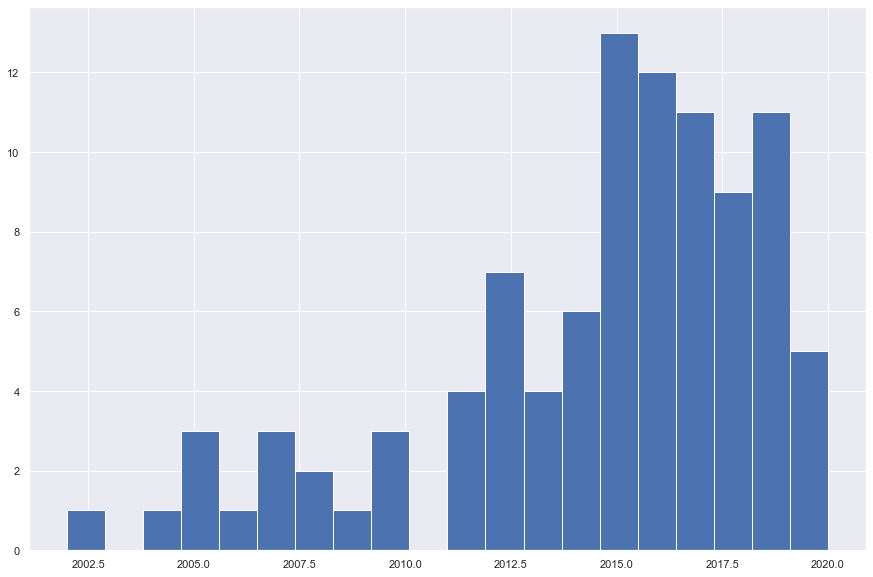

In [98]:
games_100[games_100["YearPublished"] > 2000]["YearPublished"].hist(
    figsize=(15, 10), bins=20
);

## Comments Sentiment Analysis

##### Comments Top 100, Top 1000, and Top 5000

In [99]:
comments = pd.read_pickle("comments.pkl")
comments

FileNotFoundError: [Errno 2] No such file or directory: 'comments.pkl'

In [100]:
comments.loc[comments["Rating"] != "N/A"]

NameError: name 'comments' is not defined

## Rating by Designer

In [101]:
# prepare dictionary to store results
models = {}
models["model"] = []
models["r2"] = []
models["mae"] = []
models["rmse"] = []

randomstate = 42

In [102]:
x = designers
y = games["AvgRating"]

train, holdout, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [103]:
train

,Isaac Childres,Matt Leacock,Rob Daviau,Gavan Brown,Martin Wallace,Matt Tolman,Jacob Fryxelius,Christian T. Petersen,Corey Konieczka,Dane Beltrami,Helge Ostertag,Jens Drögemüller,Vlaada Chvátil,Francesco Nepitello,Marco Maggi,Roberto Di Meglio,R. Eric Reuss,Alexander Pfister,Ananda Gupta,Jason Matthews,Jamey Stegmaier,Stefan Feld,Antoine Bauza,Bruno Cathala,Mac Gerdts,Adam Kwapiński,Elizabeth Hargrave,Uwe Rosenberg,MJ Newman,Nate French,Alan Stone,Reiner Stockhausen,Cole Wehrle,Paul Dennen,James A. Wilson,Andreas Seyfarth,Jeroen Doumen,Joris Wiersinga,Eric M. Lang,Nikki Valens,Caleb Grace,Michael Boggs,Andy Clautice,Adam Carlson,Josh J. Carlson,Thomas Sing,Elwen,Mín,Vladimír Suchý,Simone Luciani,Tommaso Battista,Bruno Sautter,Ludovic Roudy,Dávid Turczi,Richard Amann,Viktor Peter,Daniele Tascini,Friedemann Friese,Adam Poots,Chris Cantrell,Nathan Tiras,Prashant Saraswat,Rick Ernst,Stone Librande,Juma Al-JouJou,Jonathan Ying,Justin Kemppainen,Vital Lacerda,Touko Tahkokallio,Michael Kiesling,Kevin Riley,Lukas Litzsinger,Richard Garfield,Wolfgang Warsch,(Uncredited),Ignacy Trzewiczek,Joanna Kijanka,Thomas Lehmann,S J Macdonald,Shem Phillips,Chad Jensen,Peter Lee,Rodney Thompson,Richard Breese,Sebastian Bleasdale,Virginio Gigli,Krzysztof Piskorski,Marcin Świerkot,William Attia,Richard Ulrich,Wolfgang Kramer,Alain Orban,Sébastien Dujardin,Xavier Georges,Donald X. Vaccarino,Grace Holdinghaus,Nathan I. Hajek,Helmut Ohley,"Leonhard ""Lonny"" Orgler",Frank West,Flaminia Brasini,Reiner Knizia,Wei-Hwa Huang,Thomas Dagenais-Lespérance,Christian Martinez,Gary Grady,Raymond Edwards,Suzanne Goldberg,Ole Steiness,Hisashi Hayashi,Jesús Torres Castro,James Kniffen,Samuel Bailey,Guillaume Montiage,Jacques Bariot,Henry Audubon,Jordy Adan,Matúš Kotry,Ben Cichoski,Daniel Mandel,Jason Little,Carl de Visser,Jarratt Gray,Bernd Brunnhofer,Darwin Kastle,Robert Dougherty,Andreas Steiger,Alan R. Moon,Adam Sadler,Daniel Clark (I),Kevin Wilson,Rüdiger Dorn,Frédéric Guérard,Matthias Cramer,Benoit Turpin,Andreas Steding,Isaac Vega,Jonathan Gilmour,Cody Miller,Sébastien Pauchon,Glenn Drover,Don Eskridge,Brian Lewis,Inka Brand,Markus Brand,Richard Borg,Ted Alspach,Jakub Wiśniewski,Michał Oracz,Bill Eberle,Bill Norton,Jack Kittredge,Peter Olotka,Adrian Adamescu,Daryl Andrews,Matt Calkins,Prospero Hall,Ryan Laukat,David Cicurel,Jakub Łapot,Przemysław Rymer,Einar Rosén,Nina Håkansson,Robert Rosén,Rustan Håkansson,Ted Raicer,Roberto Fraga,Yohan Lemonnier,Scot Eaton,Manuel Rozoy,Peggy Chassenet,Marc André,"Andreas ""ode."" Odendahl",Michael Keller (II),Kevin Russ,Urs Hostettler,Klaus-Jürgen Wrede,Gord!,Jean-Baptiste Lullien,Nicolas Raoult,Raphaël Guiton,Devin Low,Ludovic Maublanc,Andrew Veen,Mike Boxleiter,Tommy Maranges,John D. Clair,Jens Christopher Ulrich,Kris Burm,Tobey Ho,Fred Perret,Guilherme Goulart,Thiago Aranha,Keith Matejka,Phil Walker-Harding,Emerson Matsuuchi,David Thompson (I),Trevor Benjamin,Dirk Henn,Asger Harding Granerud,Francis Tresham,Andreas Pelikan,Kota Nakayama (中山 宏太),Carl Chudyk,Ed Carter,Christian Leonhard,Cédrick Chaboussit,Dennis K. Chan,Nick Little (I),Régis Bonnessée,Jean-Louis Roubira,Louis Malz,Stefan Malz,Frank Brooks,Stephen Hand,Luke Laurie,Tom Jolly,Colby Dauch,Tomáš Uhlíř,Tony Fanchi,Marc Neidlinger,Hervé Lemaître,Paolo Mori,John Yianni,Tory Niemann,Robert A. Kouba,Shimpei Sato,Mikkel Bertelsen,Tim Fowers,Lincoln Petersen,Sandy Petersen,Mark Simonitch,Chris Taylor (I),Johannes Sich,Hal Duncan,Ruth Veevers,Benjamin Pope,Bryan Pope,Philippe Keyaerts,Dan Cassar,Andreas Schmidt,Oleg Sidorenko,Oleksandr Nevskiy,Scott Almes,Gabriele Mari,Gianluca Santopietro,Christian Marcussen,Kasper Aagaard,Sid Sackson,Serge Laget,Seiji Kanai,Bruno Faidutti,Julian Courtland-Smith,Ed Beach,Justin D. Jacobson,Dmitry Knorre,Dominic Crapuchettes,Sergey Machin,Richard Launius,Andrew Wolf,Forrest-Pruzan Creative,Kami Mandell,Bruce Glassco,Karl-Heinz Schmiel,Stefan Dorra,Ben Rosset,Matthew O'Malley,Michael Rieneck,Stefan Stadler,J. Arthur Ellis,Mr. Bistro,Dan 

In [ ]:
# Set upline models
baseline_models = {
    "LR": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(random_state=randomstate),
    # "Extra Trees": ExtraTreesRegressor(random_state = randomstate),
    "Gradient Boosted": GradientBoostingRegressor(random_state=randomstate),
    # "KNN" : KNeighborsRegressor(),
    # "MLPRegressor" : MLPRegressor(random_state = randomstate),
    # "Bayesian Ridge" : BayesianRidge(),
    # "Orthogonal Matching Pursuit" : OrthogonalMatchingPursuit(),
    # "Ridge" : Ridge(random_state = randomstate, tol=1e-3, normalize=False),
    "XGB Regressor": xgb.XGBRegressor(random_state=randomstate),
    "Random Forest Regressor": RandomForestRegressor(random_state=randomstate),
}

# run spot check on each model inline
for model in baseline_models:
    this_model = baseline_models[model]
    label = model
    spot_check = score_model(this_model, train, y_train, label, models)

# Fun Time Modeling

## Predicting Game Ratings

### Basic Game Info

In [35]:
games.columns

Index(['BGGId', 'Name', 'Description', 'YearPublished', 'GameWeight',
       'AvgRating', 'BayesAvgRating', 'StdDev', 'MinPlayers', 'MaxPlayers',
       'ComAgeRec', 'LanguageEase', 'BestPlayers', 'GoodPlayers', 'NumOwned',
       'NumWant', 'NumWish', 'NumWeightVotes', 'MfgPlaytime', 'ComMinPlaytime',
       'ComMaxPlaytime', 'MfgAgeRec', 'NumUserRatings', 'NumComments',
       'NumAlternates', 'NumExpansions', 'NumAwards', 'NumImplementations',
       'NumFans', 'NumPageViews', 'RulesPosts', 'TotalPosts', 'IsExpansion',
       'IsReimplementation', 'Family', 'Theme', 'Category', 'Kickstarted',
       'ImagePath', 'Rank:boardgame', 'Rank:thematic', 'Rank:strategygames',
       'Rank:wargames', 'Rank:familygames', 'Rank:cgs', 'Rank:abstracts',
       'Rank:partygames', 'Rank:childrensgames'],
      dtype='object')

In [36]:
# prepare dictionary to store results
models = {}
models["model"] = []
models["r2"] = []
models["mae"] = []
models["rmse"] = []

randomstate = 42

In [37]:
x = games[
    [
        "YearPublished",
        "GameWeight",
        "MinPlayers",
        "MaxPlayers",
        "BestPlayers",
        "ComMinPlaytime",
        "ComMaxPlaytime",
        "MfgAgeRec",
        "IsExpansion",
        "IsReimplementation",
        "NumImplementations",
        "NumAlternates",
        "NumExpansions",
    ]
]
y = games["BayesAvgRating"]

train, holdout, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [38]:
continuous = list(train.columns)
polys = []
cats = []
overall = continuous
overall

['YearPublished',
 'GameWeight',
 'MinPlayers',
 'MaxPlayers',
 'BestPlayers',
 'ComMinPlaytime',
 'ComMaxPlaytime',
 'MfgAgeRec',
 'IsExpansion',
 'IsReimplementation',
 'NumImplementations',
 'NumAlternates',
 'NumExpansions']

In [39]:
processed_train, processed_holdout = processing_pipeline(
    continuous, polys, cats, overall, train, holdout
)

In [40]:
processed_train

,YearPublished,GameWeight,MinPlayers,MaxPlayers,BestPlayers,ComMinPlaytime,ComMaxPlaytime,MfgAgeRec,IsExpansion,IsReimplementation,NumImplementations,NumAlternates,NumExpansions
0,0.152087,-1.158159,-0.015722,-0.294281,-0.294248,-0.100409,-0.136231,-0.988006,0.0,-0.362279,-0.359261,-0.167038,-0.179944
1,0.136941,-1.158159,1.444676,0.538270,-0.294248,-0.110443,-0.108979,-0.714164,0.0,-0.362279,-0.359261,-0.060738,-0.179944
2,0.076354,-0.923065,-0.015722,-0.294281,-0.294248,-0.010099,-0.054476,-0.988006,0.0,-0.362279,-0.359261,-0.060738,-0.179944
3,0.106647,-0.654353,-0.015722,0.538270,-0.294248,-0.070306,-0.108979,1.202728,0.0,2.760301,0.803930,-0.167038,-0.179944
4,0.071305,-1.027564,-0.015722,1.370820,-0.294248,-0.110443,-0.145314,0.107361,0.0,-0.362279,-0.359261,0.045563,-0.179944
...,...,...,...,...,...,...,...,...,...,...,...,...,...
17087,0.162185,-0.864292,-0.015722,-0.294281,-0.294248,-0.070306,-0.090811,-0.440323,0.0,-0.362279,-0.359261,-0.167038,-0.179944
17088,0.116745,-1.158159,-0.015722,-0.294281,-0.294248,-0.110443,-0.145314,-1.535690,0.0,-0.362279,0.803930,0.045563,-0.179944
17089,0.162185,1.427869,-0.015722,-1.126832,-0.294248,-0.070306,-0.054476,0.655044,0.0,-0.362279,-0.359261,-0.167038,0.878692
17090,0.141989,-0.108937,-1.476120,-0.294281,2.475691,-0.040202,-0.054476,-0.440323,0.0,-0.362279,-0.359261,0.577065,0.084715


In [41]:
games["BayesAvgRating"].std()

0.36347781508541205

In [42]:
# Set upline models
baseline_models = {
    "LR": LinearRegression(),
    # "Decision Tree": DecisionTreeRegressor(random_state = randomstate),
    "Extra Trees": ExtraTreesRegressor(random_state=randomstate),
    "Gradient Boosted": GradientBoostingRegressor(random_state=randomstate),
    "KNN": KNeighborsRegressor(),
    # "LinearSVR" : LinearSVR(random_state = randomstate),
    # "MLPRegressor" : MLPRegressor(random_state = randomstate),
    "Bayesian Ridge": BayesianRidge(),
    # "Nu SVR": NuSVR(),
    # "Orthogonal Matching Pursuit" : OrthogonalMatchingPursuit(),
    # "Ridge" : Ridge(random_state = randomstate, tol=1e-3, normalize=False),
    # "SVR" : SVR(),
    "XGB Regressor": xgb.XGBRegressor(random_state=randomstate),
    "Random Forest Regressor": RandomForestRegressor(random_state=randomstate),
}

# run spot check on each model inline
for model in baseline_models:
    this_model = baseline_models[model]
    label = model
    spot_check = score_model(this_model, processed_train, y_train, label, models)



 LR  scores
CV 5 R2 Train Score: 56.81
CV 5 MAE Train Score: 0.1419
CV 5 RMSE Train Score: 0.2412


 Extra Trees  scores
CV 5 R2 Train Score: 75.1
CV 5 MAE Train Score: 0.1102
CV 5 RMSE Train Score: 0.1831


 Gradient Boosted  scores
CV 5 R2 Train Score: 75.3
CV 5 MAE Train Score: 0.1087
CV 5 RMSE Train Score: 0.1824


 KNN  scores
CV 5 R2 Train Score: 66.08
CV 5 MAE Train Score: 0.1254
CV 5 RMSE Train Score: 0.2137


 Bayesian Ridge  scores
CV 5 R2 Train Score: 56.82
CV 5 MAE Train Score: 0.1419
CV 5 RMSE Train Score: 0.2412


 XGB Regressor  scores
CV 5 R2 Train Score: 74.9
CV 5 MAE Train Score: 0.1054
CV 5 RMSE Train Score: 0.1838


 Random Forest Regressor  scores
CV 5 R2 Train Score: 75.37
CV 5 MAE Train Score: 0.109
CV 5 RMSE Train Score: 0.1821


In [43]:
# make data frame from our models dictionary
target = pd.DataFrame(models).reset_index(drop=True)

# sort data frame by mae and reset index
target.sort_values("mae", ascending=True).head(20)

,model,r2,mae,rmse
5,XGB Regressor,74.90,0.1054,0.1838
2,Gradient Boosted,75.30,0.1087,0.1824
6,Random Forest Regressor,75.37,0.1090,0.1821
1,Extra Trees,75.10,0.1102,0.1831
3,KNN,66.08,0.1254,0.2137
0,LR,56.81,0.1419,0.2412
4,Bayesian Ridge,56.82,0.1419,0.2412


In [44]:
model = GradientBoostingRegressor(random_state=randomstate)
model.fit(processed_train, y_train)

from sklearn.inspection import permutation_importance

r = permutation_importance(
    model, processed_train, y_train, n_repeats=15, random_state=0, n_jobs=-1
)

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.001:
        print(
            f"{processed_train.columns[i]:<8} "
            f"\t\tImportance: {r.importances_mean[i]:.3f} "
        )

importances = {}

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.001:
        importances[processed_train.columns[i]] = r.importances_mean[i]
    else:
        continue

importances

important_features = list(importances.keys())
print(important_features)

permutations_train = processed_train[important_features]
permutations_test = processed_holdout[important_features]

BestPlayers 		Importance: 0.745 
GameWeight 		Importance: 0.094 
NumAlternates 		Importance: 0.090 
YearPublished 		Importance: 0.057 
NumExpansions 		Importance: 0.043 
NumImplementations 		Importance: 0.011 
ComMaxPlaytime 		Importance: 0.008 
MfgAgeRec 		Importance: 0.006 
ComMinPlaytime 		Importance: 0.005 
MaxPlayers 		Importance: 0.002 
['BestPlayers', 'GameWeight', 'NumAlternates', 'YearPublished', 'NumExpansions', 'NumImplementations', 'ComMaxPlaytime', 'MfgAgeRec', 'ComMinPlaytime', 'MaxPlayers']


In [45]:
model = GradientBoostingRegressor(random_state=randomstate)
model.fit(permutations_train, y_train)
preds_train = model.predict(permutations_train)
preds = model.predict(permutations_test)

print("MAE: ", mean_absolute_error(preds, y_test))
print("RMSE:", np.sqrt(mean_squared_error(preds, y_test)))
print("R2:", r2_score(preds, y_test) * 100)

MAE:  0.10465736962803801
RMSE: 0.17099254412682796
R2: 68.12459784102532


### Game Info + Mechanics

In [46]:
lowest_1percent = mechanics.shape[0] * 0.01
mechanics_over_1percent = pd.DataFrame(mechanics.sum() > lowest_1percent)
mechanics_list = list(
    mechanics_over_1percent.loc[mechanics_over_1percent[0] == True].index
)
used_mechanics = mechanics[mechanics_list]
games_important = games[important_features]
games_and_mechanics = pd.concat(
    [games_important, used_mechanics.drop("BGGId", axis=1)], axis=1
)

In [47]:
# prepare dictionary to store results
models = {}
models["model"] = []
models["r2"] = []
models["mae"] = []
models["rmse"] = []

randomstate = 42

In [48]:
x = games_and_mechanics
y = games["BayesAvgRating"]

train, holdout, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [49]:
# continuous = list(games_important.columns)
# binaries = list(used_mechanics.drop('BGGId', axis=1).columns)
continuous = list(games_and_mechanics.columns)
binaries = []
polys = []
overall = list(games_and_mechanics.columns)

In [50]:
processed_train, processed_holdout = processing_pipeline(
    continuous, polys, binaries, overall, train, holdout
)

In [51]:
processed_train

,BestPlayers,GameWeight,NumAlternates,YearPublished,NumExpansions,NumImplementations,ComMaxPlaytime,MfgAgeRec,ComMinPlaytime,MaxPlayers,Action Queue,Campaign / Battle Card Driven,Cooperative Game,"Deck, Bag, and Pool Building",Grid Movement,Hand Management,Hexagon Grid,Modular Board,Scenario / Mission / Campaign Game,Simultaneous Action Selection,Solo / Solitaire Game,Storytelling,Variable Player Powers,Action Points,Point to Point Movement,Set Collection,Trading,Network and Route Building,Variable Set-up,Take That,Tile Placement,Line of Sight,Area Majority / Influence,Dice Rolling,Variable Phase Order,Voting,Area Movement,Team-Based Game,Auction/Bidding,Card Drafting,Events,Movement Points,Simulation,Player Elimination,Push Your Luck,Worker Placement,Role Playing,Race,Memory,Stock Holding,Pick-up and Deliver,Trick-taking,Commodity Speculation,Square Grid,Pattern Building,Secret Unit Deployment,Betting and Bluffing,Paper-and-Pencil,Roll / Spin and Move,Zone of Control,Pattern Recognition,Acting,Ratio / Combat Results Table,Chit-Pull System
0,-0.294248,-1.158159,-0.167038,0.152087,-0.179944,-0.359261,-0.136231,-0.988006,-0.100409,-0.294281,-0.136581,-0.165747,-0.27932,-0.192216,-0.284639,-0.506993,-0.353961,-0.290009,-0.154405,-0.238787,-0.205569,-0.150589,-0.379631,-0.236451,-0.210467,-0.394421,-0.175906,-0.162742,-0.131607,-0.233401,-0.301588,-0.110993,-0.28223,1.588063,-0.120343,-0.146474,-0.242596,-0.223621,-0.233261,-0.307666,-0.125493,-0.155,-0.329943,-0.184048,-0.20986,-0.194658,-0.159878,-0.101709,-0.214229,-0.118833,-0.16962,-0.137246,-0.107705,-0.102294,5.037514,-0.165001,-0.138348,6.300416,-0.257392,-0.109907,-0.161029,-0.107427,-0.119338,-0.109634
1,-0.294248,-1.158159,-0.060738,0.136941,-0.179944,-0.359261,-0.108979,-0.714164,-0.110443,0.538270,-0.136581,-0.165747,-0.27932,-0.192216,-0.284639,-0.506993,-0.353961,-0.290009,-0.154405,4.187835,-0.205569,-0.150589,-0.379631,-0.236451,-0.210467,-0.394421,-0.175906,-0.162742,-0.131607,4.284476,-0.301588,-0.110993,-0.28223,1.588063,-0.120343,-0.146474,4.122084,-0.223621,-0.233261,-0.307666,-0.125493,-0.155,-0.329943,-0.184048,-0.20986,-0.194658,-0.159878,-0.101709,-0.214229,-0.118833,-0.16962,-0.137246,-0.107705,-0.102294,-0.198511,-0.165001,-0.138348,-0.158720,-0.257392,-0.109907,-0.161029,-0.107427,-0.119338,-0.109634
2,-0.294248,-0.923065,-0.060738,0.076354,-0.179944,-0.359261,-0.054476,-0.988006,-0.010099,-0.294281,-0.136581,-0.165747,-0.27932,-0.192216,-0.284639,-0.506993,-0.353961,-0.290009,-0.154405,-0.238787,-0.205569,-0.150589,-0.379631,4.229207,4.751334,-0.394421,-0.175906,-0.162742,-0.131607,-0.233401,-0.301588,-0.110993,-0.28223,1.588063,-0.120343,-0.146474,-0.242596,-0.223621,-0.233261,-0.307666,-0.125493,-0.155,-0.329943,-0.184048,-0.20986,-0.194658,-0.159878,-0.101709,-0.214229,-0.118833,-0.16962,-0.137246,-0.107705,-0.102294,-0.198511,-0.165001,-0.138348,-0.158720,3.885121,-0.109907,-0.161029,-0.107427,-0.119338,-0.109634
3,-0.294248,-0.654353,-0.167038,0.106647,-0.179944,0.803930,-0.108979,1.202728,-0.070306,0.538270,-0.136581,-0.165747,-0.27932,-0.192216,-0.284639,-0.506993,-0.353961,-0.290009,-0.154405,-0.238787,-0.205569,-0.150589,-0.379631,-0.236451,-0.210467,-0.394421,-0.175906,-0.162742,-0.131607,-0.233401,-0.301588,-0.110993,-0.28223,-0.629698,-0.120343,-0.146474,-0.242596,-0.223621,-0.233261,-0.307666,-0.125493,-0.155,-0.329943,-0.184048,-0.20986,-0.194658,-0.159878,-0.101709,-0.214229,-0.118833,-0.16962,-0.137246,-0.107705,-0.102294,-0.198511,-0.165001,-0.138348,-0.158720,-0.257392,-0.109907,-0.161029,-0.107427,-0.119338,-0.109634
4,-0.294248,-1.027564,0.045563,0.071305,-0.179944,-0.359261,-0.145314,0.107361,-0.110443,1.370820,-0.136581,-0.165747,-0.27932,-0.192216,-0.284639,-0.506993,-0.353961,-0.290009,-0.154405,-0.238787,-0.205569,-0.150589,-0.379631,-0.236451,-0.210467,-0.394421,-0.175906,-0.162742,-0.131607,-0.233401,-0.301588,-0.110993,-0.28223,-0.629698,-0.120343,-0.146474,-0.242596,-0.223621,-0.233261,-0.307666,-0.125493,-0.155,-0.329943,

In [52]:
# Set upline models
baseline_models = {
    "LR": LinearRegression(),
    # "Decision Tree": DecisionTreeRegressor(random_state = randomstate),
    "Extra Trees": ExtraTreesRegressor(random_state=randomstate),
    "Gradient Boosted": GradientBoostingRegressor(random_state=randomstate),
    "KNN": KNeighborsRegressor(),
    # "LinearSVR" : LinearSVR(random_state = randomstate),
    # "MLPRegressor" : MLPRegressor(random_state = randomstate),
    "Bayesian Ridge": BayesianRidge(),
    # "Nu SVR": NuSVR(),
    # "Orthogonal Matching Pursuit" : OrthogonalMatchingPursuit(),
    # "Ridge" : Ridge(random_state = randomstate, tol=1e-3, normalize=False),
    # "SVR" : SVR(),
    "XGB Regressor": xgb.XGBRegressor(random_state=randomstate),
    "Random Forest Regressor": RandomForestRegressor(random_state=randomstate),
}

# run spot check on each model inline
for model in baseline_models:
    this_model = baseline_models[model]
    label = model
    spot_check = score_model(this_model, processed_train, y_train, label, models)



 LR  scores
CV 5 R2 Train Score: 60.23
CV 5 MAE Train Score: 0.1364
CV 5 RMSE Train Score: 0.2315


 Extra Trees  scores
CV 5 R2 Train Score: 75.53
CV 5 MAE Train Score: 0.1083
CV 5 RMSE Train Score: 0.1815


 Gradient Boosted  scores
CV 5 R2 Train Score: 75.7
CV 5 MAE Train Score: 0.1077
CV 5 RMSE Train Score: 0.1809


 KNN  scores
CV 5 R2 Train Score: 42.37
CV 5 MAE Train Score: 0.1522
CV 5 RMSE Train Score: 0.2787


 Bayesian Ridge  scores
CV 5 R2 Train Score: 60.24
CV 5 MAE Train Score: 0.1365
CV 5 RMSE Train Score: 0.2315


 XGB Regressor  scores
CV 5 R2 Train Score: 75.82
CV 5 MAE Train Score: 0.1039
CV 5 RMSE Train Score: 0.1804


 Random Forest Regressor  scores
CV 5 R2 Train Score: 76.54
CV 5 MAE Train Score: 0.1054
CV 5 RMSE Train Score: 0.1777


In [53]:
# make data frame from our models dictionary
target = pd.DataFrame(models).reset_index(drop=True)

# sort data frame by mae and reset index
target.sort_values("mae", ascending=True).head(20)

,model,r2,mae,rmse
5,XGB Regressor,75.82,0.1039,0.1804
6,Random Forest Regressor,76.54,0.1054,0.1777
2,Gradient Boosted,75.70,0.1077,0.1809
1,Extra Trees,75.53,0.1083,0.1815
0,LR,60.23,0.1364,0.2315
4,Bayesian Ridge,60.24,0.1365,0.2315
3,KNN,42.37,0.1522,0.2787


In [54]:
model = xgb.XGBRegressor(random_state=randomstate)
model.fit(processed_train, y_train)

from sklearn.inspection import permutation_importance

r = permutation_importance(
    model, processed_train, y_train, n_repeats=15, random_state=0, n_jobs=-1
)

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.005:
        print(
            f"{processed_train.columns[i]:<8} "
            f"\t\tImportance: {r.importances_mean[i]:.3f} "
        )

importances = {}

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.005:
        importances[processed_train.columns[i]] = r.importances_mean[i]
    else:
        continue

importances

important_features = list(importances.keys())
print(important_features)

permutations_train = processed_train[important_features]
permutations_test = processed_holdout[important_features]

BestPlayers 		Importance: 0.702 
GameWeight 		Importance: 0.174 
NumAlternates 		Importance: 0.114 
YearPublished 		Importance: 0.091 
NumExpansions 		Importance: 0.060 
ComMaxPlaytime 		Importance: 0.021 
NumImplementations 		Importance: 0.019 
MaxPlayers 		Importance: 0.018 
MfgAgeRec 		Importance: 0.018 
ComMinPlaytime 		Importance: 0.014 
Hand Management 		Importance: 0.008 
Solo / Solitaire Game 		Importance: 0.007 
Card Drafting 		Importance: 0.006 
Hexagon Grid 		Importance: 0.005 
['BestPlayers', 'GameWeight', 'NumAlternates', 'YearPublished', 'NumExpansions', 'ComMaxPlaytime', 'NumImplementations', 'MaxPlayers', 'MfgAgeRec', 'ComMinPlaytime', 'Hand Management', 'Solo / Solitaire Game', 'Card Drafting', 'Hexagon Grid']


In [55]:
model.fit(permutations_train, y_train)
preds_train = model.predict(permutations_train)
preds = model.predict(permutations_test)

print("MAE: ", mean_absolute_error(preds, y_test))
print("RMSE:", np.sqrt(mean_squared_error(preds, y_test)))
print("R2:", r2_score(preds, y_test) * 100)

MAE:  0.09924048636888413
RMSE: 0.1680102344421022
R2: 72.30747259195593


### Game Info + Designers + Mechanics

In [109]:
mechanics_designers = pd.concat(
    [used_mechanics.drop("BGGId", axis=1), designers.drop("BGGId", axis=1)], axis=1
)

In [118]:
# prepare dictionary to store results
models = {}
models["model"] = []
models["r2"] = []
models["mae"] = []
models["rmse"] = []

randomstate = 42

In [111]:
x1 = games_important
x2 = mechanics_designers
y = games["BayesAvgRating"]

train_x1, holdout_x1, y_train, y_test = train_test_split(
    x1, y, test_size=0.2, random_state=42
)
train_x2, holdout_x2 = train_test_split(x2, test_size=0.2, random_state=42)

train_x1.reset_index(inplace=True, drop=True)
holdout_x1.reset_index(inplace=True, drop=True)
train_x2.reset_index(inplace=True, drop=True)
holdout_x2.reset_index(inplace=True, drop=True)
y_train.reset_index(inplace=True, drop=True)
y_test.reset_index(inplace=True, drop=True)

continuous = list(games_important.columns)
binaries = []
polys = []
overall = list(games_important.columns)

processed_train_x1, processed_holdout_x1 = processing_pipeline(
    continuous, polys, binaries, overall, train_x1, holdout_x1
)

processed_train = pd.concat([processed_train_x1, train_x2], axis=1)
processed_holdout = pd.concat([processed_holdout_x1, holdout_x2], axis=1)

In [115]:
processed_train

BestPlayers  GameWeight  NumAlternates  YearPublished  NumExpansions  \
0        -0.294248   -1.158159      -0.167038       0.152087      -0.179944   
1        -0.294248   -1.158159      -0.060738       0.136941      -0.179944   
2        -0.294248   -0.923065      -0.060738       0.076354      -0.179944   
3        -0.294248   -0.654353      -0.167038       0.106647      -0.179944   
4        -0.294248   -1.027564       0.045563       0.071305      -0.179944   
...            ...         ...            ...            ...            ...   
17087    -0.294248   -0.864292      -0.167038       0.162185      -0.179944   
17088    -0.294248   -1.158159       0.045563       0.116745      -0.179944   
17089    -0.294248    1.427869      -0.167038       0.162185       0.878692   
17090     2.475691   -0.108937       0.577065       0.141989       0.084715   
17091    -0.294248   -0.570425      -0.167038       0.157136      -0.179944   

       NumImplementations  ComMaxPlaytime  MfgAgeRec  ComMinPlaytime  \
0               -0.359261       -0.136231  -0.988006       -0.100409   
1               -0.359261       -0.108979  -0.714164       -0.110443   
2               -0.359261       -0.054476  -0.988006       -0.010099   
3                0.803930       -0.108979   1.202728       -0.070306   
4               -0.359261       -0.145314   0.107361       -0.110443   
...                   ...             ...        ...             ...   
17087           -0.359261       -0.090811  -0.440323       -0.070306   
17088            0.803930       -0.145314  -1.535690       -0.110443   
17089           -0.359261       -0.054476   0.655044       -0.070306   
17090           -0.359261       -0.054476  -0.440323       -0.040202   
17091           -0.359261       -0.163482   0.928886       -0.130512   

       MaxPlayers  Action Queue  Campaign / Battle Card Driven  \
0       -0.294281             0                              0   
1        0.538270             0                              0   
2       -0.294281             0                              0   
3        0.538270             0                              0   
4        1.370820             0                              0   
...           ...           ...                            ...   
17087   -0.294281             0                              0   
17088   -0.294281             0                              0   
17089   -1.126832             0                              0   
17090   -0.294281             0                              0   
17091    0.538270             0                              0   

       Cooperative Game  Deck, Bag, and Pool Building  Grid Movement  \
0                     0                             0              0   
1                     0                             0              0   
2                     0                             0              0   
3                     0                             0              0   
4                     0                             0              0   
...                 ...                           ...            ...   
17087                 0                             0              0   
17088                 0                             0              0   
17089                 0                             0              0   
17090                 0                             0              0   
17091                 0                             0              0   

       Hand Management  Hexagon Grid  Modular Board  \
0                    0             0              0   
1                    0             0              0   
2                    0             0              0   
3                    0             0              0   
4                    0             0              0   
...                ...           ...            ...   
17087                0             0              0   
17088                0             0              0   
17089                0             1    

In [119]:
# Set upline models
baseline_models = {
    "Gradient Boosted": GradientBoostingRegressor(random_state=randomstate),
    "XGB Regressor": xgb.XGBRegressor(random_state=randomstate),
    "Random Forest Regressor": RandomForestRegressor(random_state=randomstate),
}

# run spot check on each model inline
for model in baseline_models:
    this_model = baseline_models[model]
    label = model
    spot_check = score_model(this_model, processed_train, y_train, label, models)



 Gradient Boosted  scores
CV 5 R2 Train Score: 75.64
CV 5 MAE Train Score: 0.1078
CV 5 RMSE Train Score: 0.1811


 XGB Regressor  scores
CV 5 R2 Train Score: 76.69
CV 5 MAE Train Score: 0.1031
CV 5 RMSE Train Score: 0.1771


 Random Forest Regressor  scores
CV 5 R2 Train Score: 77.21
CV 5 MAE Train Score: 0.0983
CV 5 RMSE Train Score: 0.1751


In [120]:
# make data frame from our models dictionary
target = pd.DataFrame(models).reset_index(drop=True)

# sort data frame by mae and reset index
target.sort_values("mae", ascending=True).head(20)

,model,r2,mae,rmse
2,Random Forest Regressor,77.21,0.0983,0.1751
1,XGB Regressor,76.69,0.1031,0.1771
0,Gradient Boosted,75.64,0.1078,0.1811


In [ ]:
model = xgb.XGBRegressor(random_state=randomstate)
model.fit(processed_train, y_train)

from sklearn.inspection import permutation_importance

r = permutation_importance(
    model, processed_train, y_train, n_repeats=15, random_state=0, n_jobs=-1
)

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.005:
        print(
            f"{processed_train.columns[i]:<8} "
            f"\t\tImportance: {r.importances_mean[i]:.3f} "
        )

importances = {}

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.005:
        importances[processed_train.columns[i]] = r.importances_mean[i]
    else:
        continue

importances

important_features = list(importances.keys())
print(important_features)

permutations_train = processed_train[important_features]
permutations_test = processed_holdout[important_features]

In [ ]:
model = RandomForestRegressor(random_state=randomstate)
model.fit(permutations_train, y_train)
preds_train = model.predict(permutations_train)
preds = model.predict(permutations_test)

print("MAE: ", mean_absolute_error(preds, y_test))
print("RMSE:", np.sqrt(mean_squared_error(preds, y_test)))
print("R2:", r2_score(preds, y_test) * 100)

### Only Mechanics

In [72]:
# prepare dictionary to store results
models = {}
models["model"] = []
models["r2"] = []
models["mae"] = []
models["rmse"] = []

randomstate = 42

In [73]:
x = used_mechanics.drop("BGGId", axis=1)
y = games["BayesAvgRating"]

processed_train, processed_holdout, y_train, y_test = train_test_split(
    x, y, test_size=0.2, random_state=42
)

In [74]:
# Set upline models
baseline_models = {
    "LR": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(random_state=randomstate),
    "Extra Trees": ExtraTreesRegressor(random_state=randomstate),
    "Gradient Boosted": GradientBoostingRegressor(random_state=randomstate),
    "KNN": KNeighborsRegressor(),
    "MLPRegressor": MLPRegressor(random_state=randomstate),
    "Bayesian Ridge": BayesianRidge(),
    "Nu SVR": NuSVR(),
    "Orthogonal Matching Pursuit": OrthogonalMatchingPursuit(),
    "Ridge": Ridge(random_state=randomstate, tol=1e-3, normalize=False),
    "XGB Regressor": xgb.XGBRegressor(random_state=randomstate),
    "Random Forest Regressor": RandomForestRegressor(random_state=randomstate),
}

# run spot check on each model inline
for model in baseline_models:
    this_model = baseline_models[model]
    label = model
    spot_check = score_model(this_model, processed_train, y_train, label, models)



 LR  scores
CV 5 R2 Train Score: 19.37
CV 5 MAE Train Score: 0.201
CV 5 RMSE Train Score: 0.3297


 Decision Tree  scores
CV 5 R2 Train Score: -17.35
CV 5 MAE Train Score: 0.2191
CV 5 RMSE Train Score: 0.3978


 Extra Trees  scores
CV 5 R2 Train Score: -13.6
CV 5 MAE Train Score: 0.2169
CV 5 RMSE Train Score: 0.3914


 Gradient Boosted  scores
CV 5 R2 Train Score: 21.56
CV 5 MAE Train Score: 0.1969
CV 5 RMSE Train Score: 0.3252


 KNN  scores
CV 5 R2 Train Score: 11.78
CV 5 MAE Train Score: 0.1985
CV 5 RMSE Train Score: 0.3449


 MLPRegressor  scores
CV 5 R2 Train Score: 4.67
CV 5 MAE Train Score: 0.2169
CV 5 RMSE Train Score: 0.3584


 Bayesian Ridge  scores
CV 5 R2 Train Score: 19.4
CV 5 MAE Train Score: 0.2009
CV 5 RMSE Train Score: 0.3296


 Nu SVR  scores
CV 5 R2 Train Score: 18.79
CV 5 MAE Train Score: 0.1784
CV 5 RMSE Train Score: 0.3309


 Orthogonal Matching Pursuit  scores
CV 5 R2 Train Score: 12.73
CV 5 MAE Train Score: 0.2113
CV 5 RMSE Train Score: 0.343


 Ridge  scores


In [75]:
# make data frame from our models dictionary
target = pd.DataFrame(models).reset_index(drop=True)

# sort data frame by mae and reset index
target.sort_values("mae", ascending=True).head(20)

,model,r2,mae,rmse
7,Nu SVR,18.79,0.1784,0.3309
10,XGB Regressor,18.15,0.1947,0.3322
3,Gradient Boosted,21.56,0.1969,0.3252
4,KNN,11.78,0.1985,0.3449
11,Random Forest Regressor,13.62,0.1997,0.3413
6,Bayesian Ridge,19.40,0.2009,0.3296
0,LR,19.37,0.2010,0.3297
9,Ridge,19.37,0.2010,0.3297
8,Orthogonal Matching Pursuit,12.73,0.2113,0.3430
2,Extra Trees,-13.60,0.2169,0.3914


In [76]:
model = xgb.XGBRegressor(random_state=randomstate)
model.fit(processed_train, y_train)

from sklearn.inspection import permutation_importance

r = permutation_importance(
    model, processed_train, y_train, n_repeats=15, random_state=0, n_jobs=-1
)

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.005:
        print(
            f"{processed_train.columns[i]:<8} "
            f"\t\tImportance: {r.importances_mean[i]:.3f} "
        )

importances = {}

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.005:
        importances[processed_train.columns[i]] = r.importances_mean[i]
    else:
        continue

importances

important_features = list(importances.keys())
print(important_features)

permutations_train = processed_train[important_features]
permutations_test = processed_holdout[important_features]

Solo / Solitaire Game 		Importance: 0.069 
Worker Placement 		Importance: 0.069 
Variable Set-up 		Importance: 0.066 
Card Drafting 		Importance: 0.064 
Set Collection 		Importance: 0.056 
Variable Player Powers 		Importance: 0.051 
Hand Management 		Importance: 0.051 
Area Majority / Influence 		Importance: 0.046 
Network and Route Building 		Importance: 0.044 
Tile Placement 		Importance: 0.042 
Hexagon Grid 		Importance: 0.038 
Dice Rolling 		Importance: 0.032 
Deck, Bag, and Pool Building 		Importance: 0.032 
Cooperative Game 		Importance: 0.031 
Auction/Bidding 		Importance: 0.031 
Grid Movement 		Importance: 0.031 
Scenario / Mission / Campaign Game 		Importance: 0.029 
Race     		Importance: 0.028 
Area Movement 		Importance: 0.026 
Point to Point Movement 		Importance: 0.025 
Action Points 		Importance: 0.025 
Simultaneous Action Selection 		Importance: 0.024 
Team-Based Game 		Importance: 0.024 
Modular Board 		Importance: 0.022 
Events   		Importance: 0.021 
Square Grid 		Imp

In [77]:
model = NuSVR()
model.fit(permutations_train, y_train)
preds_train = model.predict(permutations_train)
preds = model.predict(permutations_test)

print("MAE: ", mean_absolute_error(preds, y_actual))
print("RMSE:", np.sqrt(mean_squared_error(preds, y_actual)))
print("R2:", r2_score(preds, y_actual) * 100)

MAE:  0.17101662481309984
RMSE: 0.3160652862284648
R2: -234.08024787848422


In [78]:
games["BayesAvgRating"].describe()

count    21365.000000
mean         5.683911
std          0.363478
min          3.571740
25%          5.510120
50%          5.545850
75%          5.675360
max          8.523850
Name: BayesAvgRating, dtype: float64

<AxesSubplot:>

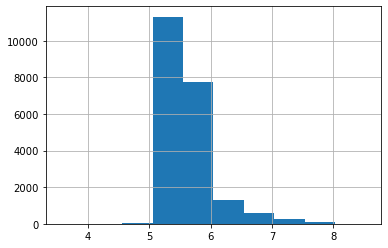

In [79]:
games["BayesAvgRating"].hist()

In [80]:
games["BayesAvgRating"].std()

0.36347781508541205

## Position

In [ ]:
# prepare dictionary to store results
models = {}
models["model"] = []
models["r2"] = []
models["mae"] = []
models["rmse"] = []

randomstate = np.random.randint(100)

In [ ]:
x = games.drop(
    [
        "BGGId",
        "Name",
        "Description",
        "Family",
        "Theme",
        "Category",
        "ImagePath",
        "Rank:boardgame",
        "GoodPlayers",
        "Kickstarted",
        "Rank:thematic",
        "Rank:strategygames",
        "Rank:wargames",
        "Rank:familygames",
        "Rank:cgs",
        "Rank:abstracts",
        "Rank:partygames",
        "Rank:childrensgames",
        "BestPlayers",
        "StdDev",
    ],
    axis=1,
)
y = games["Rank:boardgame"]

train, holdout, y_train, y_test = train_test_split(
    x, y, test_size=0.2, random_state=randomstate
)

In [ ]:
continuous = list(train.columns)
continuous.remove("BayesAvgRating")
polys = ["BayesAvgRating"]
overall = continuous + polys
overall.append("Poly1")
overall.append("Poly2")

overall

In [ ]:
processed_train, processed_holdout = processing_pipeline(
    continuous, polys, overall, train, holdout
)

In [ ]:
processed_train

In [ ]:
# Set upline models
baseline_models = {
    "LR": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(random_state=randomstate),
    "Extra Trees": ExtraTreesRegressor(random_state=randomstate),
    "Gradient Boosted": GradientBoostingRegressor(random_state=randomstate),
    "KNN": KNeighborsRegressor(),
    "LinearSVR": LinearSVR(random_state=randomstate),
    "MLPRegressor": MLPRegressor(random_state=randomstate),
    "Bayesian Ridge": BayesianRidge(),
    "Nu SVR": NuSVR(),
    "Orthogonal Matching Pursuit": OrthogonalMatchingPursuit(),
    "Ridge": Ridge(random_state=randomstate, tol=1e-3, normalize=False),
    "SVR": SVR(),
    "XGB Regressor": xgb.XGBRegressor(random_state=randomstate),
    "Random Forest Regressor": RandomForestRegressor(random_state=randomstate),
}

# run spot check on each model inline
for model in baseline_models:
    this_model = baseline_models[model]
    label = model
    spot_check = score_model(this_model, processed_train, y_train, label, models)

In [ ]:
# make data frame from our models dictionary
target = pd.DataFrame(models).reset_index(drop=True)

# sort data frame by mae and reset index
target.sort_values("mae", ascending=True).head(20)

In [ ]:
model = RandomForestRegressor(random_state=randomstate)
model.fit(processed_train, y_train)

from sklearn.inspection import permutation_importance

r = permutation_importance(
    model, processed_train, y_train, n_repeats=15, random_state=0, n_jobs=-1
)

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.001:
        print(
            f"{processed_train.columns[i]:<8} "
            f"\t\tImportance: {r.importances_mean[i]:.3f} "
        )

importances = {}

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.001:
        importances[processed_train.columns[i]] = r.importances_mean[i]
    else:
        continue

importances

important_features = list(importances.keys())
print(important_features)

permutations_train = processed_train[important_features]
permutations_test = processed_holdout[important_features]

In [ ]:
model = RandomForestRegressor(random_state=randomstate)
model.fit(permutations_train, y_train)
preds_train = model.predict(permutations_train)
preds = model.predict(permutations_test)

print("MAE: ", int(mean_absolute_error(preds, y_test)))
print("RMSE:", int(np.sqrt(mean_squared_error(preds, y_test))))
print("R2:", r2_score(preds, y_test) * 100)

In [ ]:
fig, ax = plt.subplots(figsize=(20, 15))
plt.scatter(games["Rank:boardgame"], games["BayesAvgRating"])

## Bayesian Score

In [ ]:
# prepare dictionary to store results
models = {}
models["model"] = []
models["r2"] = []
models["mae"] = []
models["rmse"] = []

randomstate = 42

In [ ]:
bayes_study = (
    games.join(ratings_dist.set_index("BGGId"), on="BGGId", how="left")
    .reset_index()
    .drop(
        [
            "BGGId",
            "Name",
            "Description",
            "GoodPlayers",
            "Family",
            "Theme",
            "Category",
            "ImagePath",
            "num_votes",
            "Rank:boardgame",
            "Rank:thematic",
            "Rank:strategygames",
            "Rank:wargames",
            "Rank:familygames",
            "Rank:cgs",
            "Rank:abstracts",
            "Rank:partygames",
            "Rank:childrensgames",
            "index",
        ],
        axis=1,
    )
)
bayes_study

In [ ]:
x = bayes_study.drop("BayesAvgRating", axis=1)
y = games["BayesAvgRating"]

train, holdout, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [ ]:
continuous = list(train.columns)
overall = list(train.columns)
poly = []
processed_train, processed_holdout = processing_pipeline(
    continuous, poly, overall, train, holdout
)

In [ ]:
# Set upline models
baseline_models = {
    "LR": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(random_state=randomstate),
    "Extra Trees": ExtraTreesRegressor(random_state=randomstate),
    "Gradient Boosted": GradientBoostingRegressor(random_state=randomstate),
    "XGB Regressor": xgb.XGBRegressor(random_state=randomstate),
    "Random Forest Regressor": RandomForestRegressor(random_state=randomstate),
}

# run spot check on each model inline
for model in baseline_models:
    this_model = baseline_models[model]
    label = model
    spot_check = score_model(this_model, processed_train, y_train, label, models)

In [ ]:
# make data frame from our models dictionary
target = pd.DataFrame(models).reset_index(drop=True)

# sort data frame by mae and reset index
target.sort_values("mae", ascending=True).head(20)

In [ ]:
model = LinearRegression()
model.fit(processed_train, y_train)

from sklearn.inspection import permutation_importance

r = permutation_importance(
    model, processed_train, y_train, n_repeats=15, random_state=0, n_jobs=-1
)

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.001:
        print(
            f"{processed_train.columns[i]:<8} "
            f"\t\tImportance: {r.importances_mean[i]:.3f} "
        )

importances = {}

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.001:
        importances[processed_train.columns[i]] = r.importances_mean[i]
    else:
        continue

importances

important_features = list(importances.keys())
print(important_features)

permutations_train = processed_train[important_features]
permutations_test = processed_holdout[important_features]

In [ ]:
model = ExtraTreesRegressor(random_state=randomstate)
model.fit(processed_train, y_train)

from sklearn.inspection import permutation_importance

r = permutation_importance(
    model, processed_train, y_train, n_repeats=15, random_state=0, n_jobs=-1
)

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.01:
        print(
            f"{processed_train.columns[i]:<8} "
            f"\t\tImportance: {r.importances_mean[i]:.3f} "
        )

importances = {}

for i in r.importances_mean.argsort()[::-1]:
    if r.importances_mean[i] >= 0.01:
        importances[processed_train.columns[i]] = r.importances_mean[i]
    else:
        continue

importances

important_features = list(importances.keys())
print(important_features)

permutations_train = processed_train[important_features]
permutations_test = processed_holdout[important_features]

In [ ]:
model.fit(permutations_train, y_train)
preds_train = model.predict(permutations_train)
preds = model.predict(permutations_test)

print("MAE: ", mean_absolute_error(preds, y_test))
print("RMSE:", np.sqrt(mean_squared_error(preds, y_test)))
print("R2:", r2_score(preds, y_test) * 100)

## Manual Bayesian Score

bayes avg = productRatingsAvg * productRatingsCount + C x m     /    productRatingsCount + C

m = overall average rating of store's catalog
C = Confidence constant (selected)

In [ ]:
first_game = 100
second_game = 20000

first_bayes = games.loc[first_game]["BayesAvgRating"]
first_rating = games.loc[first_game]["AvgRating"]
first_count = games.loc[first_game]["NumUserRatings"]

second_bayes = games.loc[second_game]["BayesAvgRating"]
second_rating = games.loc[second_game]["AvgRating"]
second_count = games.loc[second_game]["NumUserRatings"]

In [ ]:
# bayes = ((rating * count) + (m * c)) / (count + c)

# first_bayes = ((first_rating * first_count) + (m * c)) / (first_count + c)
# second_bayes = ((second_rating * second_count) + (m * c)) / (second_count + c)

# (second_bayes * second_count) + (second_bayes * c) - (second_rating * second_count) =  (m * c)
# m = ((second_bayes * second_count) + (second_bayes * c) - (second_rating * second_count)) / c

# first_bayes = ((first_rating * first_count) + ((second_bayes * second_count) + (second_bayes * c) - (second_rating * second_count)) / (first_count + c)
# (first_bayes*first_count) + (first_bayes*c) = (first_rating * first_count) + (second_bayes * second_count) + (second_bayes * c) - (second_rating * second_count)

# (first_bayes * c) - (second_bayes * c) = (first_rating * first_count) + (second_bayes * second_count) - (second_rating * second_count) - (first_bayes*first_count)
c = (
    (first_rating * first_count)
    + (second_bayes * second_count)
    - (second_rating * second_count)
    - (first_bayes * first_count)
) / (first_bayes - second_bayes)
m = (
    (second_bayes * second_count) + (second_bayes * c) - (second_rating * second_count)
) / c

c = int(c)
m = round(m, 2)

c, m

In [ ]:
specific_game = 15000

first_bayes = games.iloc[specific_game]["BayesAvgRating"]
first_rating = games.loc[specific_game]["AvgRating"]
first_count = games.loc[specific_game]["NumUserRatings"]

estimated_bayes = round(((first_rating * first_count) + (m * c)) / (first_count + c), 5)

print("User Rating:", first_rating)
print("Number of User Ratings:", first_count)
print("Actual Bayes:", first_bayes)
print("Estimated Bayes:", estimated_bayes)

# Umap Visuals

In [13]:
included = [
    "BGGId",
    "YearPublished",
    "GameWeight",
    "AvgRating",
    "BayesAvgRating",
    "StdDev",
    "MinPlayers",
    "MaxPlayers",
    "BestPlayers",
    "NumOwned",
    "NumWant",
    "NumWish",
    "NumWeightVotes",
    "MfgPlaytime",
    "Playtime",
    "MfgAgeRec",
    "NumUserRatings",
    "NumComments",
    "NumAlternates",
    "NumExpansions",
    "NumAwards",
    "NumImplementations",
    "NumFans",
    "NumPageViews",
    "RulesPosts",
    "TotalPosts",
    "IsExpansion",
    "IsReimplementation",
    "Kickstarted",
    "Rank:boardgame",
    "Rank:thematic",
    "Rank:strategygames",
    "Rank:wargames",
    "Rank:familygames",
    "Rank:cgs",
    "Rank:abstracts",
    "Rank:partygames",
    "Rank:childrensgames",
    "Cat:Thematic",
    "Cat:Strategy",
    "Cat:War",
    "Cat:Family",
    "Cat:CGS",
    "Cat:Abstract",
    "Cat:Party",
    "Cat:Childrens",
]
umap_games = games[included]
umap_games.head()

,BGGId,YearPublished,GameWeight,AvgRating,BayesAvgRating,StdDev,MinPlayers,MaxPlayers,BestPlayers,NumOwned,NumWant,NumWish,NumWeightVotes,MfgPlaytime,Playtime,MfgAgeRec,NumUserRatings,NumComments,NumAlternates,NumExpansions,NumAwards,NumImplementations,NumFans,NumPageViews,RulesPosts,TotalPosts,IsExpansion,IsReimplementation,Kickstarted,Rank:boardgame,Rank:thematic,Rank:strategygames,Rank:wargames,Rank:familygames,Rank:cgs,Rank:abstracts,Rank:partygames,Rank:childrensgames,Cat:Thematic,Cat:Strategy,Cat:War,Cat:Family,Cat:CGS,Cat:Abstract,Cat:Party,Cat:Childrens
0,174430,2017,3.8726,8.76029,8.52385,1.63358,1,4,3,74975,1375,17276,2009,120,180.0,14,46228,8308,6,12,30,0,7718,10816029,6326,14752,0,0,1,1,1,1,21369,21369,21369,21369,21369,21369,1,1,0,0,0,0,0,0
1,161936,2015,2.8331,8.60116,8.45000,1.56368,2,4,4,68974,840,11544,1210,60,120.0,13,44043,6682,10,0,30,2,2952,3450336,1229,3086,0,1,0,2,2,3,21369,21369,21369,21369,21369,21369,1,1,0,0,0,0,0,0
2,224517,2018,3.9038,8.66907,8.41066,1.24331,2,4,3,35448,1528,11277,1143,120,180.0,14,23776,3610,6,0,18,1,1902,1974872,387,1028,0,1,1,3,21369,2,21369,21369,21369,21369,21369,21369,0,1,0,0,0,0,0,0
3,167791,2016,3.2429,8.42155,8.27751,1.38628,1,5,3,97330,2061,18842,2944,120,240.0,12,71474,10452,14,22,39,2,6372,6285054,1155,4313,0,0,0,4,21369,6,21369,21369,21369,21369,21369,21369,0,1,0,0,0,0,0,0
4,291457,2020,3.5649,8.72198,8.25902,1.42169,1,4,2,33444,477,6250,485,120,150.0,14,13939,2149,6,0,11,0,1649,1471587,1073,2062,0,0,0,5,3,5,21369,21369,21369,21369,21369,21369,1,1,0,0,0,0,0,0


In [14]:
umap_games["Rank:boardgame"] = (
    umap_games["Rank:boardgame"].max() - umap_games["Rank:boardgame"]
)
umap_games["Rank:familygames"] = (
    umap_games["Rank:familygames"].max() - umap_games["Rank:familygames"]
)
umap_games["Rank:strategygames"] = (
    umap_games["Rank:strategygames"].max() - umap_games["Rank:strategygames"]
)
umap_games["Rank:partygames"] = (
    umap_games["Rank:partygames"].max() - umap_games["Rank:partygames"]
)
umap_games["Rank:thematic"] = (
    umap_games["Rank:thematic"].max() - umap_games["Rank:thematic"]
)
umap_games["Rank:wargames"] = (
    umap_games["Rank:wargames"].max() - umap_games["Rank:wargames"]
)
umap_games["Rank:cgs"] = umap_games["Rank:cgs"].max() - umap_games["Rank:cgs"]
umap_games["Rank:abstracts"] = (
    umap_games["Rank:abstracts"].max() - umap_games["Rank:abstracts"]
)
umap_games["Rank:childrensgames"] = (
    umap_games["Rank:childrensgames"].max() - umap_games["Rank:childrensgames"]
)

In [15]:
mechanics = pd.read_pickle("data_store/data_cleaned/mechanics.pkl")
subcategories = pd.read_pickle("data_store/data_cleaned/subcategories.pkl")

In [16]:
join1 = umap_games.join(
    mechanics.set_index("BGGId"), on="BGGId", how="left"
).reset_index(drop=True)
join2 = join1.join(
    subcategories.set_index("BGGId"), on="BGGId", how="left"
).reset_index(drop=True)

In [17]:
join1.drop("BGGId", axis=1, inplace=True)
join2.drop("BGGId", axis=1, inplace=True)
umap_games.drop("BGGId", axis=1, inplace=True)

In [18]:
scaler = MinMaxScaler()

In [19]:
join1_scaled = join1[join1.columns]
join2_scaled = join2[join2.columns]
umap_games_scaled = umap_games[umap_games.columns]

In [20]:
for column in join1.columns:
    join1_scaled[column] = scaler.fit_transform(np.array(join1[column]).reshape(-1, 1))
for column in join2.columns:
    join2_scaled[column] = scaler.fit_transform(np.array(join2[column]).reshape(-1, 1))
for column in umap_games.columns:
    umap_games_scaled[column] = scaler.fit_transform(
        np.array(umap_games[column]).reshape(-1, 1)
    )

In [21]:
umap_games.head()

,YearPublished,GameWeight,AvgRating,BayesAvgRating,StdDev,MinPlayers,MaxPlayers,BestPlayers,NumOwned,NumWant,NumWish,NumWeightVotes,MfgPlaytime,Playtime,MfgAgeRec,NumUserRatings,NumComments,NumAlternates,NumExpansions,NumAwards,NumImplementations,NumFans,NumPageViews,RulesPosts,TotalPosts,IsExpansion,IsReimplementation,Kickstarted,Rank:boardgame,Rank:thematic,Rank:strategygames,Rank:wargames,Rank:familygames,Rank:cgs,Rank:abstracts,Rank:partygames,Rank:childrensgames,Cat:Thematic,Cat:Strategy,Cat:War,Cat:Family,Cat:CGS,Cat:Abstract,Cat:Party,Cat:Childrens
0,2017,3.8726,8.76029,8.52385,1.63358,1,4,3,74975,1375,17276,2009,120,180.0,14,46228,8308,6,12,30,0,7718,10816029,6326,14752,0,0,1,21480,21368,21368,0,0,0,0,0,0,1,1,0,0,0,0,0,0
1,2015,2.8331,8.60116,8.45000,1.56368,2,4,4,68974,840,11544,1210,60,120.0,13,44043,6682,10,0,30,2,2952,3450336,1229,3086,0,1,0,21479,21367,21366,0,0,0,0,0,0,1,1,0,0,0,0,0,0
2,2018,3.9038,8.66907,8.41066,1.24331,2,4,3,35448,1528,11277,1143,120,180.0,14,23776,3610,6,0,18,1,1902,1974872,387,1028,0,1,1,21478,0,21367,0,0,0,0,0,0,0,1,0,0,0,0,0,0
3,2016,3.2429,8.42155,8.27751,1.38628,1,5,3,97330,2061,18842,2944,120,240.0,12,71474,10452,14,22,39,2,6372,6285054,1155,4313,0,0,0,21477,0,21363,0,0,0,0,0,0,0,1,0,0,0,0,0,0
4,2020,3.5649,8.72198,8.25902,1.42169,1,4,2,33444,477,6250,485,120,150.0,14,13939,2149,6,0,11,0,1649,1471587,1073,2062,0,0,0,21476,21366,21364,0,0,0,0,0,0,1,1,0,0,0,0,0,0


In [22]:
umap_games_scaled.head()

,YearPublished,GameWeight,AvgRating,BayesAvgRating,StdDev,MinPlayers,MaxPlayers,BestPlayers,NumOwned,NumWant,NumWish,NumWeightVotes,MfgPlaytime,Playtime,MfgAgeRec,NumUserRatings,NumComments,NumAlternates,NumExpansions,NumAwards,NumImplementations,NumFans,NumPageViews,RulesPosts,TotalPosts,IsExpansion,IsReimplementation,Kickstarted,Rank:boardgame,Rank:thematic,Rank:strategygames,Rank:wargames,Rank:familygames,Rank:cgs,Rank:abstracts,Rank:partygames,Rank:childrensgames,Cat:Thematic,Cat:Strategy,Cat:War,Cat:Family,Cat:CGS,Cat:Abstract,Cat:Party,Cat:Childrens
0,0.999275,0.77452,0.900262,1.000000,0.352034,0.1,0.307692,0.200000,0.456159,0.667152,0.913687,0.263234,0.002,0.500000,0.56,0.431773,0.433899,0.007059,0.022857,0.60,0.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.0,1.0,1.000000,1.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.998913,0.56662,0.881702,0.985087,0.334901,0.2,0.307692,0.266667,0.419647,0.407569,0.610535,0.158543,0.001,0.333333,0.52,0.411352,0.348968,0.011765,0.000000,0.60,0.054054,0.382483,0.318957,0.194278,0.209192,0.0,1.0,0.0,0.999953,0.999953,0.999906,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.999457,0.78076,0.889623,0.977143,0.256379,0.2,0.307692,0.200000,0.215665,0.741388,0.596414,0.149764,0.002,0.500000,0.56,0.221934,0.188509,0.007059,0.000000,0.36,0.027027,0.246437,0.182533,0.061176,0.069685,0.0,1.0,1.0,0.999907,0.000000,0.999953,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.999094,0.64858,0.860752,0.950256,0.291421,0.1,0.384615,0.200000,0.592174,1.000000,0.996509,0.385744,0.002,0.666667,0.48,0.667726,0.545887,0.016471,0.041905,0.78,0.054054,0.825602,0.581059,0.182580,0.292367,0.0,0.0,0.0,0.999860,0.000000,0.999766,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.999819,0.71298,0.895794,0.946522,0.300100,0.1,0.307692,0.133333,0.203472,0.231441,0.330548,0.063548,0.002,0.416667,0.56,0.129996,0.112196,0.007059,0.000000,0.22,0.000000,0.213656,0.135999,0.169617,0.139778,0.0,0.0,0.0,0.999814,0.999906,0.999813,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


<AxesSubplot:>

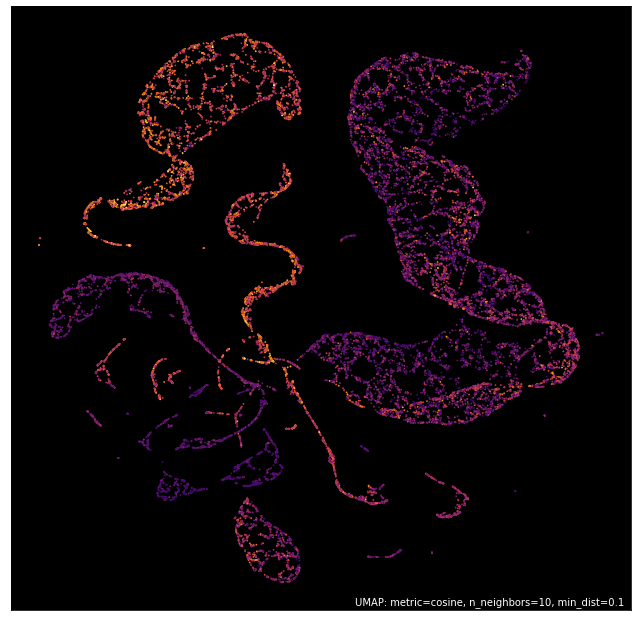

In [16]:
mapper = umap.UMAP(n_neighbors=10, metric="cosine").fit(umap_games)
umap.plot.points(mapper, theme="inferno", values=umap_games.GameWeight)

<AxesSubplot:>

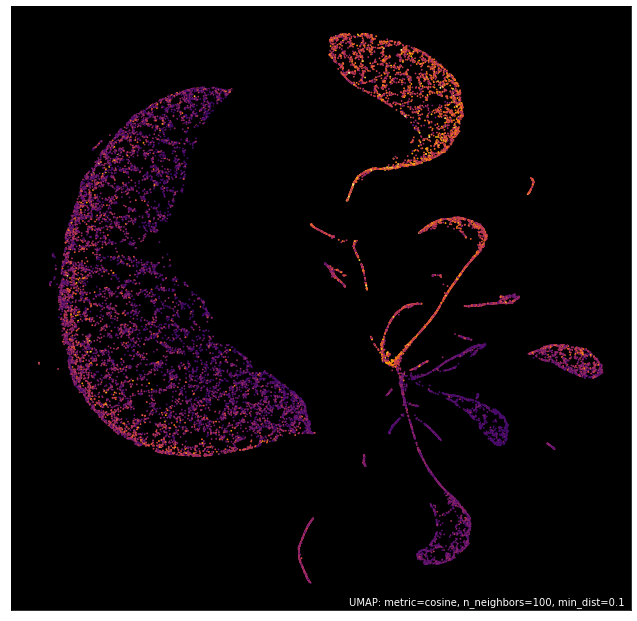

In [17]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine").fit(umap_games)
umap.plot.points(mapper, theme="inferno", values=umap_games.GameWeight)

<AxesSubplot:>

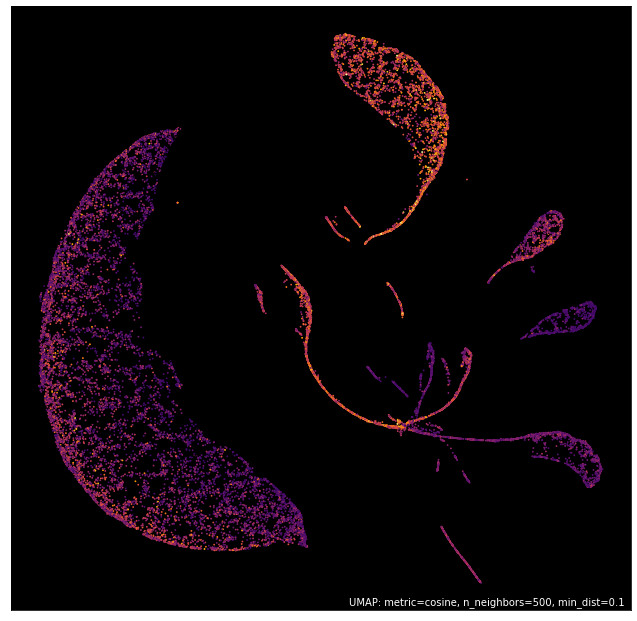

In [18]:
mapper = umap.UMAP(n_neighbors=500, metric="cosine").fit(umap_games)
umap.plot.points(mapper, theme="inferno", values=umap_games.GameWeight)

<AxesSubplot:>

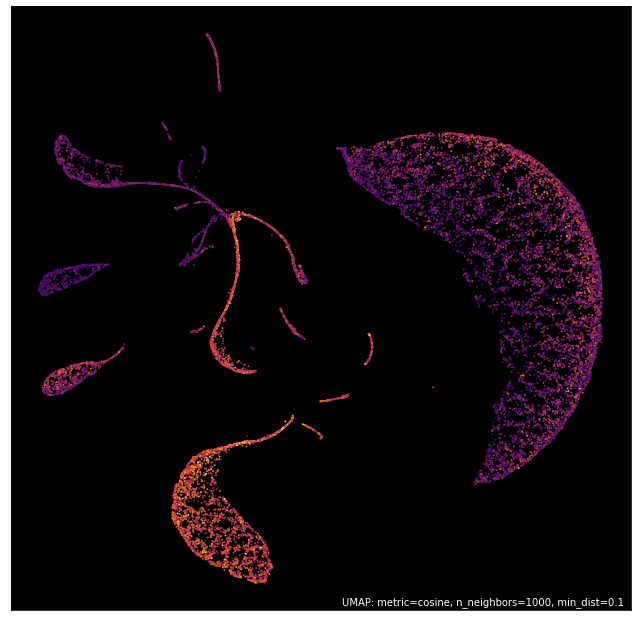

In [19]:
mapper = umap.UMAP(n_neighbors=1000, metric="cosine").fit(umap_games)
umap.plot.points(mapper, theme="inferno", values=umap_games.GameWeight)

## Umap Visual Refinement

<AxesSubplot:>

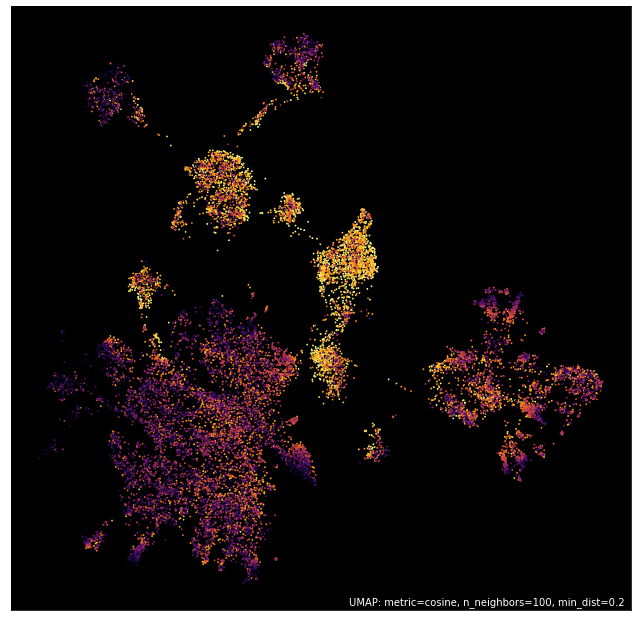

In [72]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join2_scaled["Rank:boardgame"])

### join2_scaled

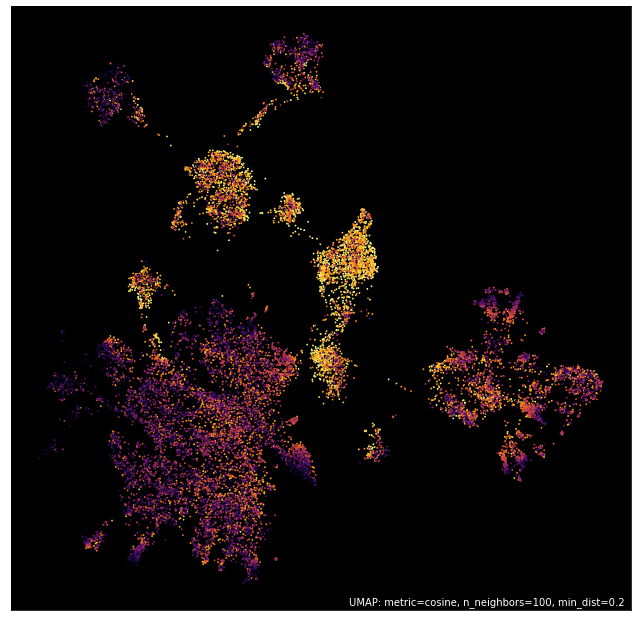

In [73]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join2_scaled["Rank:boardgame"])
plt.savefig(
    "images/games_umap_rank.png", dpi=2000, bbox_inches="tight", transparent=True
)

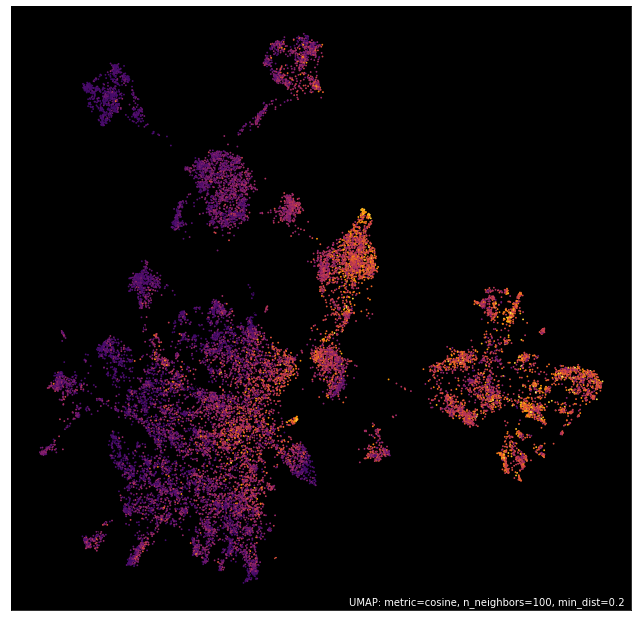

In [74]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join1_scaled.GameWeight)
plt.savefig(
    "images/games_umap_weight.png", dpi=2000, bbox_inches="tight", transparent=True
)

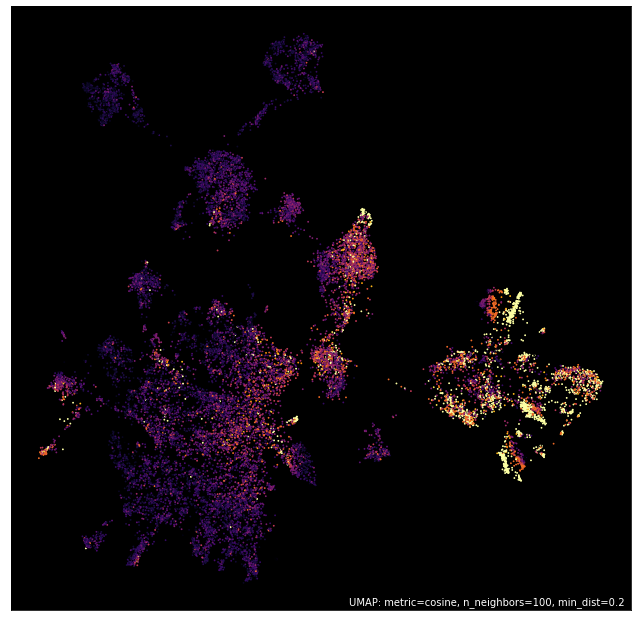

In [75]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join2_scaled.Playtime)
plt.savefig(
    "images/games_umap_playtime.png", dpi=2000, bbox_inches="tight", transparent=True
)

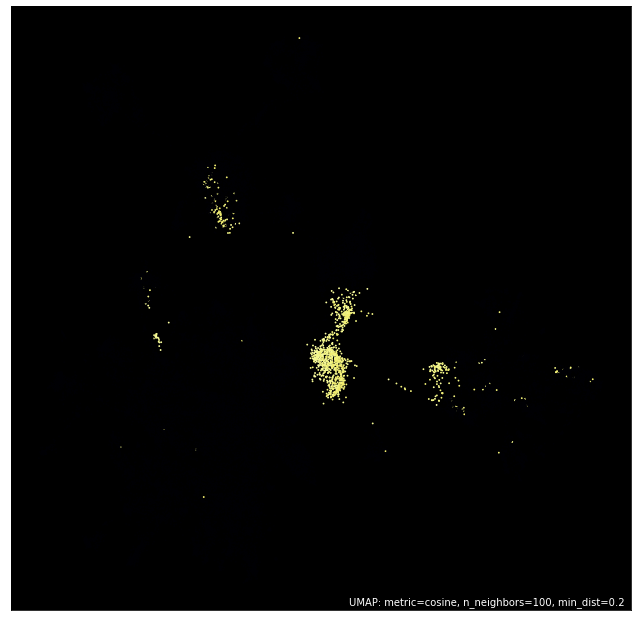

In [76]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join2_scaled["Rank:thematic"])
plt.savefig(
    "images/games_umap_thematic.png", dpi=2000, bbox_inches="tight", transparent=True
)

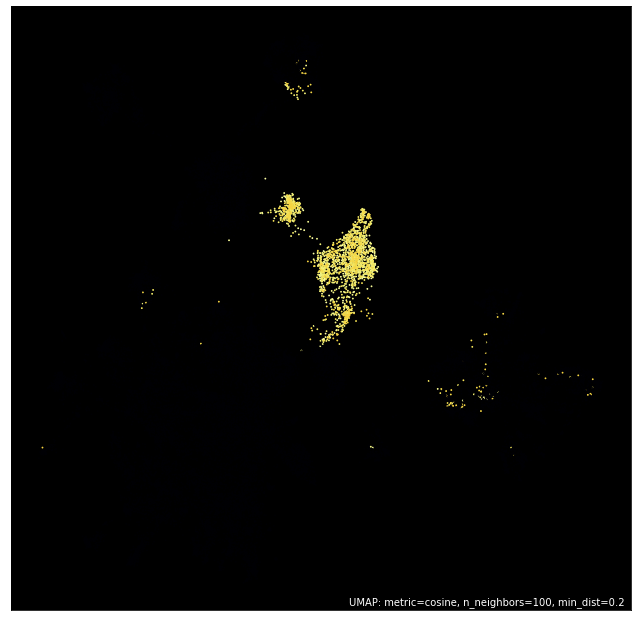

In [77]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join2_scaled["Rank:strategygames"])
plt.savefig(
    "images/games_umap_strategygames.png",
    dpi=2000,
    bbox_inches="tight",
    transparent=True,
)

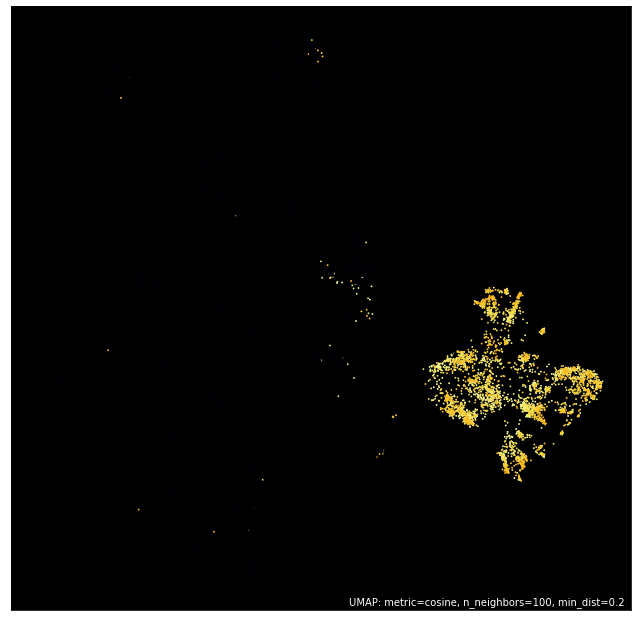

In [78]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join2_scaled["Rank:wargames"])
plt.savefig(
    "images/games_umap_wargame.png", dpi=2000, bbox_inches="tight", transparent=True
)

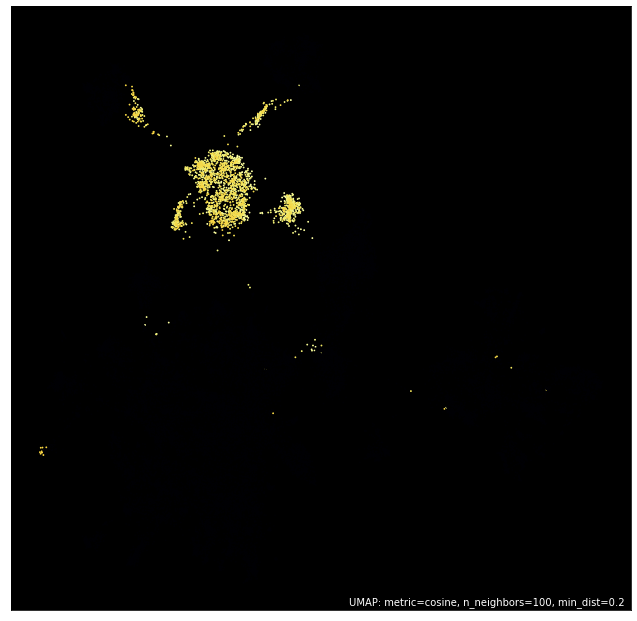

In [79]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join2_scaled["Rank:familygames"])
plt.savefig(
    "images/games_umap_familygames.png", dpi=2000, bbox_inches="tight", transparent=True
)

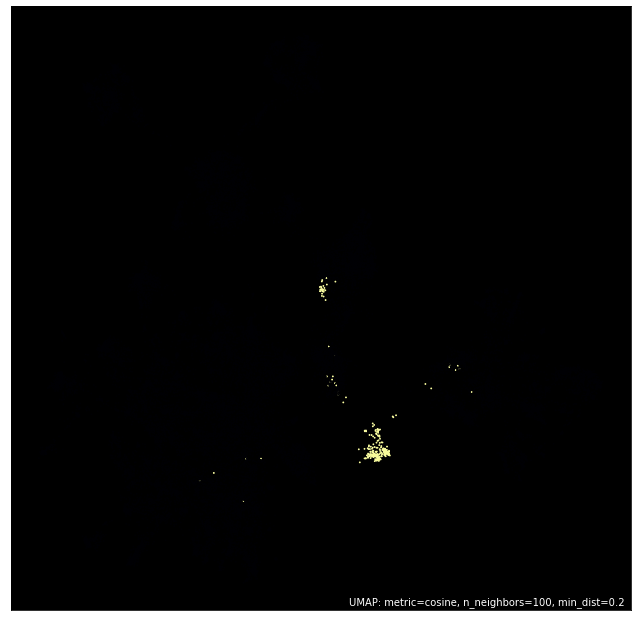

In [80]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join2_scaled["Rank:cgs"])
plt.savefig(
    "images/games_umap_cgs.png", dpi=2000, bbox_inches="tight", transparent=True
)

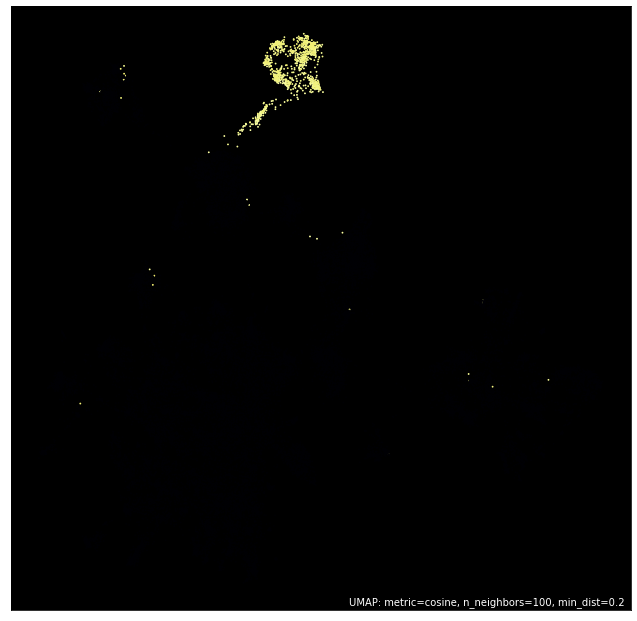

In [81]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join2_scaled["Rank:abstracts"])
plt.savefig(
    "images/games_umap_abstracts.png", dpi=2000, bbox_inches="tight", transparent=True
)

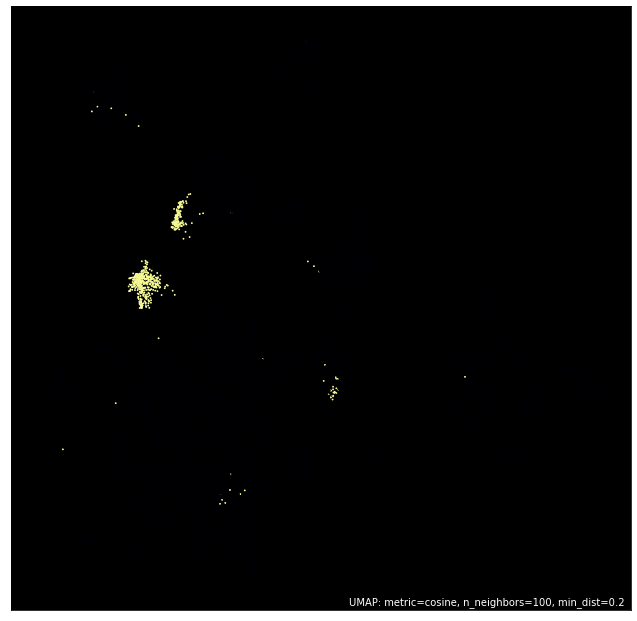

In [82]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join2_scaled["Rank:partygames"])
plt.savefig(
    "images/games_umap_partygames.png", dpi=2000, bbox_inches="tight", transparent=True
)

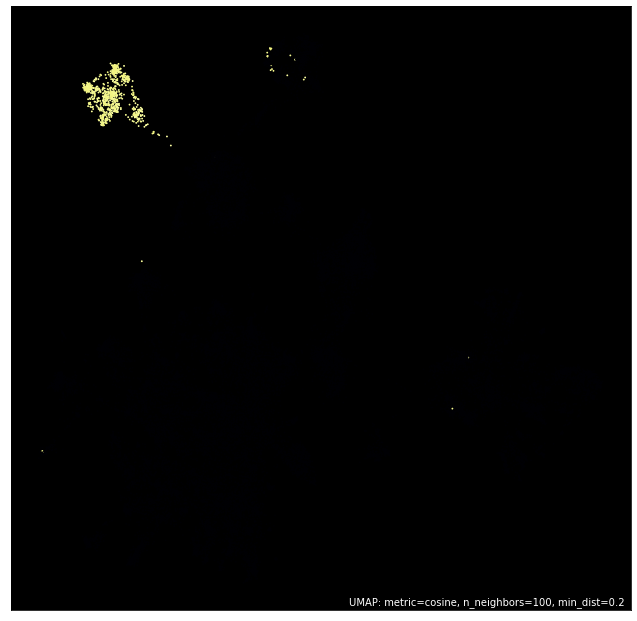

In [83]:
mapper = umap.UMAP(n_neighbors=100, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2_scaled
)
umap.plot.points(mapper, theme="inferno", values=join2_scaled["Rank:childrensgames"])
plt.savefig(
    "images/games_umap_childrens.png", dpi=2000, bbox_inches="tight", transparent=True
)

### Umap_games unscaled

<AxesSubplot:>

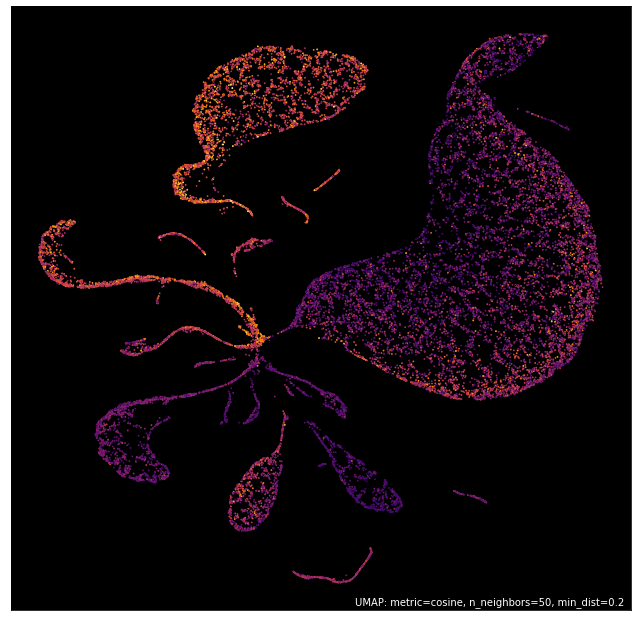

In [24]:
mapper = umap.UMAP(n_neighbors=50, metric="cosine", min_dist=0.2, random_state=2).fit(
    umap_games
)
umap.plot.points(mapper, theme="inferno", values=umap_games.GameWeight)

<AxesSubplot:>

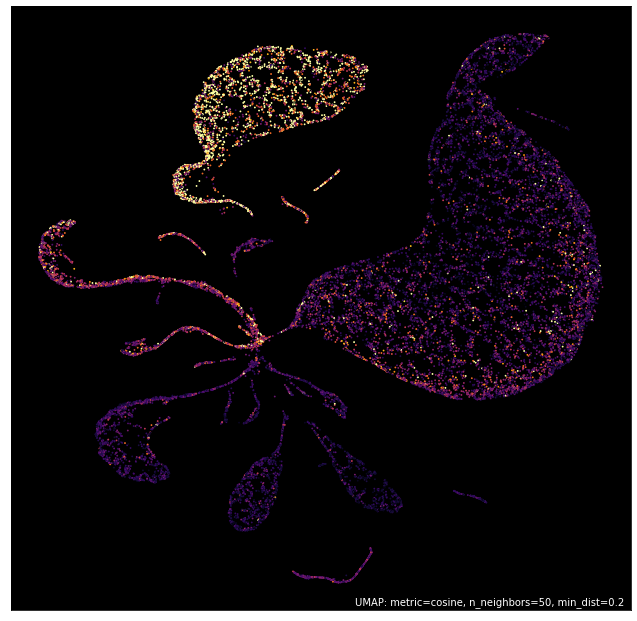

In [25]:
mapper = umap.UMAP(n_neighbors=50, metric="cosine", min_dist=0.2, random_state=2).fit(
    umap_games
)
umap.plot.points(mapper, theme="inferno", values=umap_games.Playtime)

<AxesSubplot:>

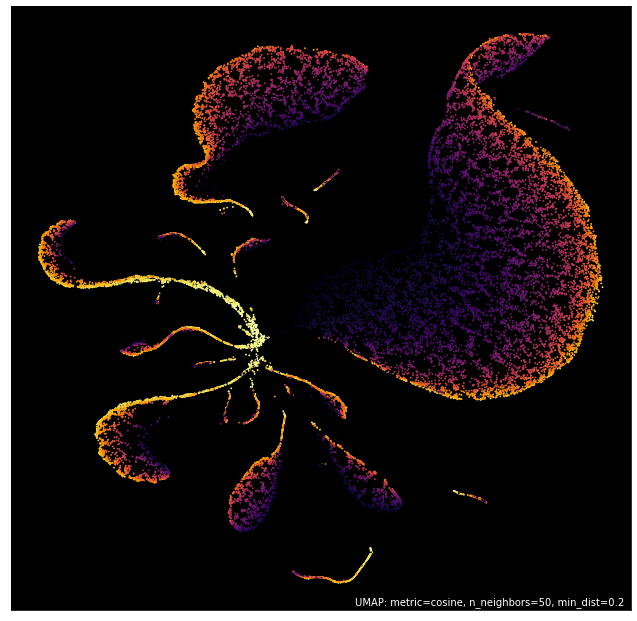

In [29]:
mapper = umap.UMAP(n_neighbors=50, metric="cosine", min_dist=0.2, random_state=2).fit(
    umap_games
)
umap.plot.points(mapper, theme="inferno", values=umap_games["Rank:boardgame"])

### Join2 unscaled

<AxesSubplot:>

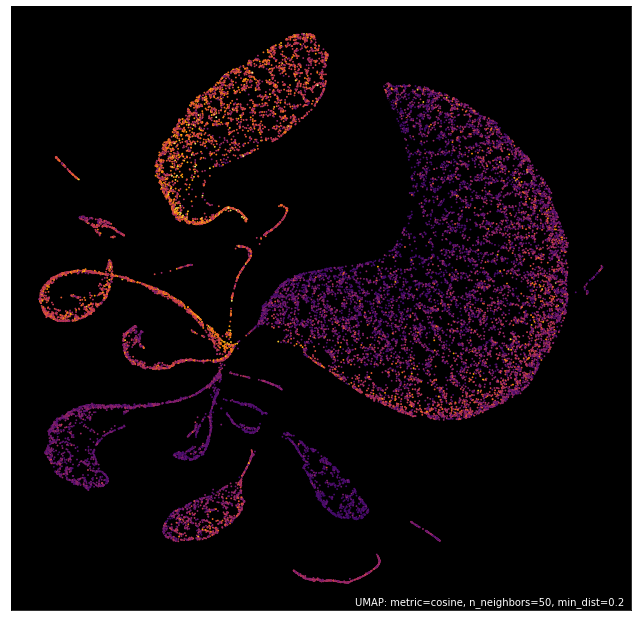

In [30]:
mapper = umap.UMAP(n_neighbors=50, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2
)
umap.plot.points(mapper, theme="inferno", values=join2.GameWeight)

<AxesSubplot:>

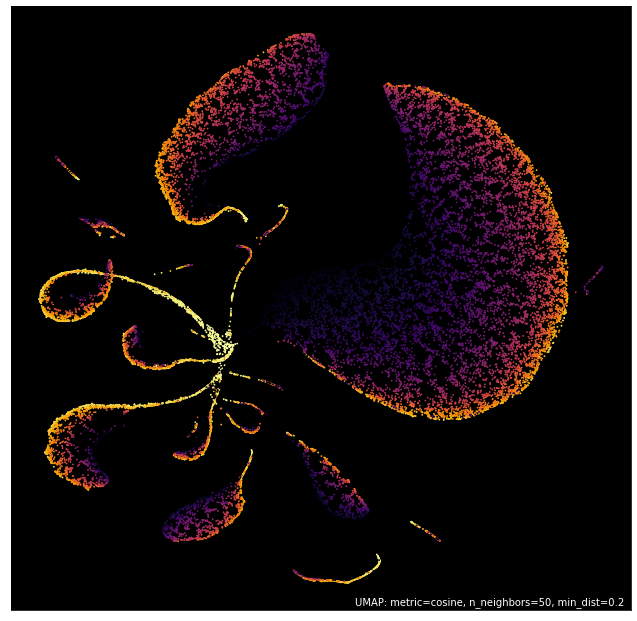

In [31]:
mapper = umap.UMAP(n_neighbors=50, metric="cosine", min_dist=0.2, random_state=2).fit(
    join2
)
umap.plot.points(mapper, theme="inferno", values=join2["Rank:boardgame"])

### Umap scaled

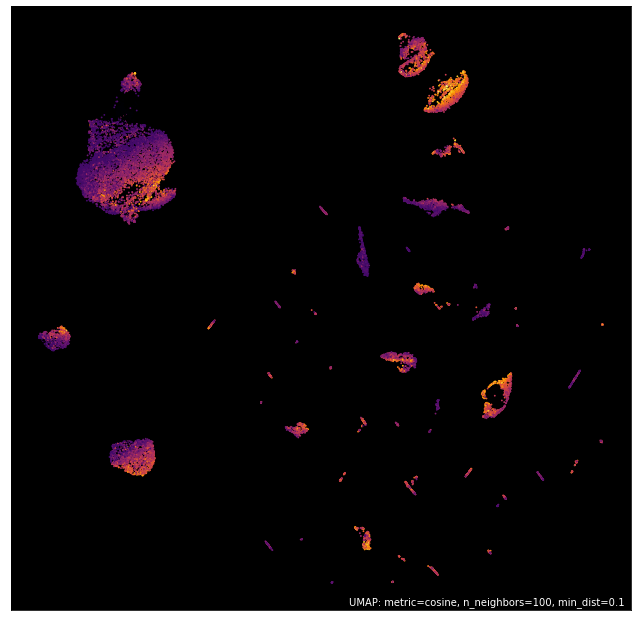

In [47]:
mapper = umap.UMAP(n_neighbors=50, metric="cosine", random_state=2).fit(
    umap_games_scaled
)
umap.plot.points(mapper, theme="inferno", values=umap_games_scaled.GameWeight)

<AxesSubplot:>

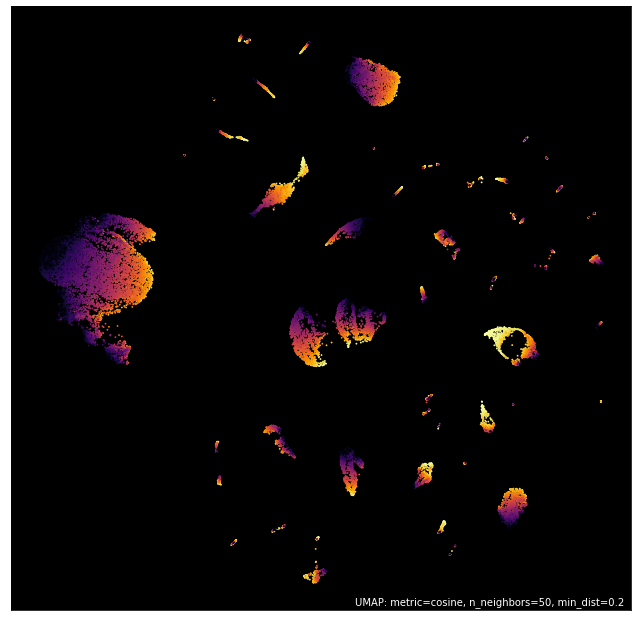

In [85]:
mapper = umap.UMAP(n_neighbors=50, metric="cosine", min_dist=0.2, random_state=2).fit(
    umap_games_scaled
)
umap.plot.points(mapper, theme="inferno", values=umap_games_scaled["Rank:boardgame"])

## Mechanics

In [94]:
mechanics = pd.read_pickle("data_store/data_cleaned/mechanics.pkl")
subcategories = pd.read_pickle("data_store/data_cleaned/subcategories.pkl")

In [95]:
join1 = games.join(mechanics.set_index("BGGId"), on="BGGId", how="left").reset_index(
    drop=True
)
join2 = join1.join(
    subcategories.set_index("BGGId"), on="BGGId", how="left"
).reset_index(drop=True)

In [96]:
drop_columns = [
    "BGGId",
    "Name",
    "Description",
    "GoodPlayers",
    "Family",
    "Theme",
    "Category",
    "ImagePath",
    "ComAgeRec",
    "LanguageEase",
    "Rank:thematic",
    "Rank:strategygames",
    "Rank:wargames",
    "Rank:familygames",
    "Rank:cgs",
    "Rank:abstracts",
    "Rank:partygames",
    "Rank:childrensgames",
    "Cat:Thematic",
    "Cat:Strategy",
    "Cat:War",
    "Cat:Family",
    "Cat:CGS",
    "Cat:Abstract",
    "Cat:Party",
    "Cat:Childrens",
]

In [97]:
join2.drop(drop_columns, axis=1, inplace=True)

In [98]:
join2.head()

,YearPublished,GameWeight,AvgRating,BayesAvgRating,StdDev,MinPlayers,MaxPlayers,BestPlayers,NumOwned,NumWant,NumWish,NumWeightVotes,MfgPlaytime,ComMinPlaytime,ComMaxPlaytime,MfgAgeRec,NumUserRatings,NumComments,NumAlternates,NumExpansions,NumAwards,NumImplementations,NumFans,NumPageViews,RulesPosts,TotalPosts,IsExpansion,IsReimplementation,Kickstarted,Rank:boardgame,Playtime,Action Queue,Action Retrieval,Campaign / Battle Card Driven,Card Play Conflict Resolution,Communication Limits,Cooperative Game,Critical Hits and Failures,Deck Construction,"Deck, Bag, and Pool Building",Grid Movement,Hand Management,Hexagon Grid,Legacy Game,Modular Board,Once-Per-Game Abilities,Scenario / Mission / Campaign Game,Simultaneous Action Selection,Solo / Solitaire Game,Storytelling,Variable Player Powers,Action Points,Point to Point Movement,Set Collection,Trading,Income,Loans,Market,Network and Route Building,Score-and-Reset Game,Tech Trees / Tech Tracks,Variable Set-up,Drafting,End Game Bonuses,TableauBuilding,Take That,Tile Placement,Line of Sight,Action Drafting,Area Majority / Influence,Area-Impulse,Dice Rolling,Follow,King of the Hill,Variable Phase Order,Voting,Victory Points as a Resource,Area Movement,Delayed Purchase,Team-Based Game,Auction/Bidding,Events,Hidden Movement,Movement Points,Simulation,Ownership,Rondel,Track Movement,Action/Event,Advantage Token,Sudden Death Ending,Tug of War,Force Commitment,Narrative Choice / Paragraph,Grid Coverage,Layering,Increase Value of Unchosen Resources,Hidden Roles,Player Elimination,Semi-Cooperative Game,Traitor Game,Automatic Resource Growth,Push Your Luck,Worker Placement,Role Playing,Stat Check Resolution,Contracts,Race,Hidden Victory Points,Memory,Enclosure,Stock Holding,Pick-up and Deliver,Map Addition,Die Icon Resolution,Resource to Move,Trick-taking,Move Through Deck,Bias,Catch the Leader,Programmed Movement,Slide/Push,Commodity Speculation,Square Grid,Moving Multiple Units,Alliances,Kill Steal,Passed Action Token,Pattern Building,Investment,Secret Unit Deployment,Highest-Lowest Scoring,Mancala,Lose a Turn,Betting and Bluffing,Negotiation,Time Track,Connections,Targeted Clues,Order Counters,Bingo,Line Drawing,Paper-and-Pencil,Deduction,Movement Template,Multiple Maps,Re-rolling and Locking,Roll / Spin and Move,Finale Ending,Roles with Asymmetric Information,Command Cards,"I Cut, You Choose",Prisoner's Dilemma,Interrupts,Real-Time,Ladder Climbing,Predictive Bid,Three Dimensional Movement,Zone of Control,Random Production,Relative Movement,Cube Tower,Bribery,Map Deformation,Elapsed Real Time Ending,Melding and Splaying,Pieces as Map,Pattern Movement,Static Capture,Pattern Recognition,Minimap Resolution,Map Reduction,Ratio / Combat Results Table,Single Loser Game,Chaining,Different Dice Movement,Measurement Movement,Action Timer,Physical Removal,Induction,Speed Matching,Player Judge,Crayon Rail System,Chit-Pull System,Matching,Impulse Movement,Dexterity,Physical,Exploration,Miniatures,Territory Building,Card Game,Educational,Puzzle,Collectible Components,Word Game,Print & Play,Electronic
0,2017,3.8726,8.76029,8.52385,1.63358,1,4,3,74975,1375,17276,2009,120,60,120,14,46228,8308,6,12,30,0,7718,10816029,6326,14752,0,0,1,1,180.0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0
1,2015,2.8331,8.60116,8.45000,1.56368,2,4,4,68974,840,11544,1210,60,60,60,13,44043,6682,10,0,30,2,2952,3450336,1229,3086,0,1,0,2,120.0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [99]:
scaler = MinMaxScaler()
scaled_stuff = scaler.fit_transform(join2)

<AxesSubplot:>

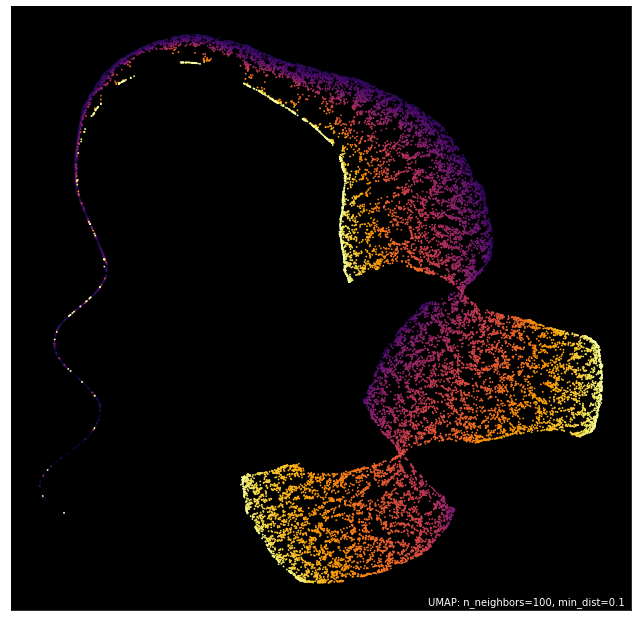

In [103]:
mapper = umap.UMAP(n_neighbors=100).fit(join2)
umap.plot.points(mapper, theme="inferno", values=join2["Rank:boardgame"])

In [101]:
mechs_cats = mechanics.join(
    subcategories.set_index("BGGId"), on="BGGId", how="left"
).reset_index(drop=True)
mechs_cats["Rank:boardgame"] = games["Rank:boardgame"]

<AxesSubplot:>

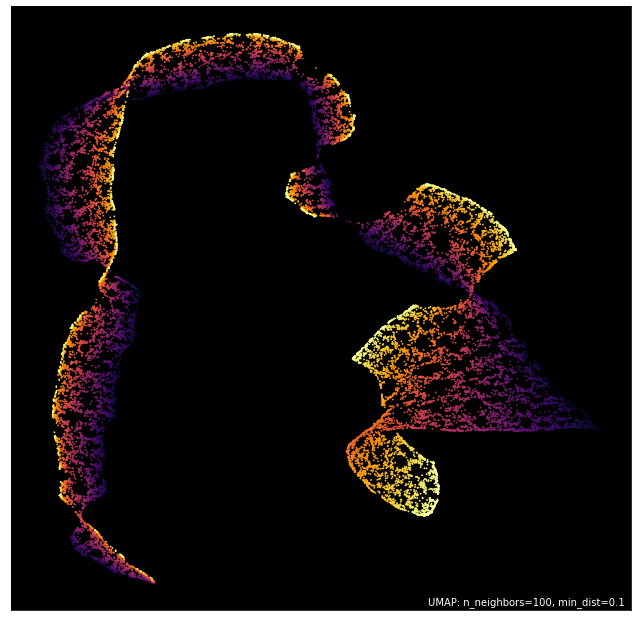

In [102]:
mapper = umap.UMAP(n_neighbors=100).fit(mechs_cats)
umap.plot.points(mapper, theme="inferno", values=mechs_cats["Rank:boardgame"])